# Notebook 4: Analysis
### MIT iGED: Global Ecosystems Dynamics Initiative

This document explores correlations between the components of the following iEcosystems pilars: 

* I-Funding
* E-Funding
* Comparative Advantage
* Impact,

As well as their correlation to global graph metrics of the studied ecosystems, in particular those metrics describing their *health* as a complex system:

* communication
* robustness
* stability
* propension to collapse


### Part 1: Packages and Functions

In this section we import the packages and functions that will support the correlation analysis performed in this notebook. 

En esta sección importamos los paquetes que utilizaremos, y también definimos las funciones que van a sustentar nuestro análisis de correlaciones. 

In [70]:
import numpy as np 
import pandas as pd 
import matplotlib as plt

import scipy.stats as stats
import seaborn as sns
import matplotlib.pyplot as plt
import math

In [71]:
def significant_corr(df1,df2,a,b):
    '''
    This function computed the pearson correlation between two data sets a, b, 
    and determines whether this correlation is significant or not. 
    
    Inputs:
    - df1  : a DataFrame
    - df2  : a DataFrame
    - a    : a data vector
    - b    : a data vector
    
    Output : a tuple (B,N) where B is a boolean that answers the question:
    ~do a and b present significant correlation? i.e. p-value<0.1,
    and N=0 is B=False, or N=p-val(a,b) if B=True
    '''
    if df2.empty:
        df2=df1
    r = stats.pearsonr(df1[a], df2[b])
    if r[1] < 0.05:
    #if r[1] < 0.2:
        return (True, r[0], r[1])
    else:
        return (False, r[0], r[1])
    
    
    

def print_significant_corr(df1,df2,a,b):
    '''
    This function computes the Pearson correlation between two data sets a, b, 
    and prints whether this correlation is significant or not, and the 
    corresponding Pearson correlation and p-value. 
    
    Inputs:
    - df1  : a DataFrame
    - df2  : a DataFrame
    - a    : a data vector
    - b    : a data vector
    
    Output : None, but executes print statements showing the findings about aand b.
    '''
    if df2.empty:
        df2=df1
    r = stats.pearsonr(df1[a], df2[b])
    print(f'Correlation between:  ' + a + '   and   ' + b)
    print('**********************************************')
    print(f'Pearson Correlation: {r[0]}, p-value: {r[1]}')
    
    if r[1] < 0.05:
    #if r[1] < 0.2:
        print('*Statistically significant*')
        print('***********************************************')
        print('')
        sns.lmplot(x=b, y=a, data=df1)
        return True, r[0], r[1]
    
    else:
        print('Not significant')
        print('**********************************************')
        print('')
        sns.lmplot(x=b, y=a, data=df1)
        return False, r[0], r[1]

    
    
def significant_corr_many(df1,df2,a,L,nameL):
    '''
    This function computes the Pearson correlation between two data sets a, b, 
    and prints whether this correlation is significant or not, and the 
    corresponding Pearson correlation and p-value. 
    
    Inputs:
    - df1  : a DataFrame
    - df2  : a DataFrame
    - a    : a data vector
    - L    : a collection of data vectors
    - nameL: string to explain what type of information the vectors in L provide 
    
    Output : None, but executes print statements showing the findings about aand b.
    '''
    sig_corrs = {nameL:[], 'Pearson Correlation':[], 'Pvalue':[]}
    
    if df2.empty:
        df2=df1
    for b in L:
        r = stats.pearsonr(df1[a], df2[b])
        if r[1] < 0.05:
        #if r[1] < 0.2:
            sig_corrs[nameL].append(b)
            sig_corrs['Pearson Correlation'].append(r[0])
            sig_corrs['Pvalue'].append(r[1])
    return pd.DataFrame(sig_corrs)

### Part 2: Reading of Data

In the following section we obtain the following DataFrames:
* `df_means`: describing iEcosystems metrics of 106 countries, averaged by iEcosystem pilar
* `grf_df`: contains graph metrics of the studied ecosystems, as well as their colaborativity indices
* `ranking_df`: focuses on the colaborativity indices of each of the studied ecosystems according to each of the proposed colaborativity metrics, as well as the ranking of these ecosystems generated by the respective metric.
*  `full_eco_df`: describing iEcosystems metrics for the same 106 countries, with each pilar broken down into its parts.  

In [72]:
#Métricas iEcosystems por pillar
df_means = pd.read_csv('Referenced_CSVs/PromediosPilares_nuevo_ieco.csv')


#Valores de métricas y de colaboratividad por ciudad
grf_df = pd.read_csv('Referenced_CSVs/Tidy_DataFrame.csv')

#Rankings de cada ciudad de acuerdo a métricas de colaboratividad
ranking_df = pd.read_csv('Referenced_CSVs/Ranking_cities.csv')


#Todos los pilares de iEco, c/u desglosado
full_ieco_df = pd.read_csv('Referenced_CSVs/full_iEco.csv')


### Part 3: Formation of DataFrames for capital ecosystems

From the DataFrames obtained above, we restrict attention to the rows corresponding to ecosystems in capital cities, and their respective countries. 

In [73]:
'''DataFrame de métricas de grafos'''

capitalnames = ['CDMX', 'CABA', 'Santiago', 'Sao Paulo', 'Madrid', 'Montevideo']
grf_df = grf_df.loc[grf_df['Ciudad'].isin(capitalnames)]

grf_df = grf_df.drop('Ciudad', axis=1)
grf_df.set_index('País', inplace=True)  #Nombramos País como índice

grf_df

,avg strength,weight,Degree,Weighted Degree,Excentricidad,Clustering,Diámetro,Radio,Camino más corto promedio,Transitividad,...,Colab 6,Colab 7,Colab 8,Colab 9,Colab 10,Colab 11,Colab 12,Colab 13,Colab 14,Colab 10 rescaled
País,,,,,,,,,,,,,,,,,,,,,
Argentina,3.244633,1.481579,4.385965,14.017544,4.798246,0.300215,6,3,3.355669,0.107392,...,0.277219,0.322560,0.364099,0.343969,0.492850,0.314246,0.312265,0.388024,0.427003,5.928502
México,3.477388,1.388629,3.658863,12.963211,5.622074,0.178788,7,4,3.820318,0.050000,...,0.197206,0.286659,0.308942,0.304868,0.397667,0.267167,0.266965,0.342306,0.320264,4.976668
Chile,3.417211,1.462564,3.948718,13.764103,5.041026,0.311157,6,3,3.227544,0.100744,...,0.271107,0.316215,0.357342,0.340056,0.480988,0.311826,0.293944,0.369558,0.407755,5.809878
Uruguay,3.227742,2.749495,7.747475,25.939394,4.479798,0.367266,6,3,3.081116,0.224523,...,0.373899,0.349355,0.431910,0.385176,0.588490,0.360937,0.360646,0.436381,0.502732,6.884901
España,3.518387,1.362343,3.790795,12.861925,6.079498,0.266684,8,5,3.783517,0.081917,...,0.228465,0.287951,0.316629,0.309405,0.426240,0.286349,0.278308,0.353561,0.403647,5.262402
Brasil,3.430669,1.253704,3.370370,11.694444,6.726852,0.295414,8,4,4.324031,0.078571,...,0.211309,0.255960,0.269424,0.284577,0.384944,0.250892,0.251874,0.326146,0.295488,4.849443


In [74]:
'''DataFrame de promedios de pilares'''

df_means.set_index('Country', inplace=True)
countries={'Mexico':'México',
          'Uruguay':'Uruguay',
          'Spain':'España',
          'Brazil':'Brasil',
          'Argentina':'Argentina',
          'Chile':'Chile'}
df_means = df_means.loc[list(countries.keys()), :]
df_means.rename(index=countries, inplace=True)
df_means

,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,3.05 E-Culture & Incentives,4 Comparative Advantage,5 Social Impact,6 Economic Impact,GNI per capita,SEDA Score
Country,,,,,,,,,,,,,,,,
México,3.5224,2.363914,1.238062,2.782979,3.102667,2.5160,3.117368,2.299475,3.701600,3.4260,2.953330,2.928133,3.916166,2.665218,1.440818,2.968
Uruguay,3.7808,2.234182,1.464989,2.833698,2.578222,1.2428,3.046434,2.006702,3.926000,2.7408,3.051111,2.482667,4.489483,2.605598,1.772041,3.560
España,3.9268,2.822386,1.899159,3.191020,3.077333,3.8300,3.189806,2.423851,4.264933,3.3650,2.614589,2.839333,4.111115,2.675696,2.461763,3.900
Brasil,3.1780,1.826706,1.662244,2.707140,2.879111,2.7542,2.975761,1.991287,3.694933,3.4638,3.376030,2.741067,3.996738,2.389177,1.426206,2.972
Argentina,3.1684,2.051076,1.682002,2.740698,2.729778,1.7930,3.076940,1.725475,3.679067,3.1718,2.891282,2.583067,3.984246,2.405071,1.527034,3.232
Chile,3.9124,2.413203,1.184934,3.100109,2.965778,1.9536,4.154179,2.207990,3.935067,3.2030,3.469417,3.111200,4.424643,2.676299,1.712616,3.504


In [75]:
'''DataFrame: por capital, desglose de cada pilar de iEcosystems.'''

full_ieco_df = full_ieco_df.rename(columns={'Unnamed: 0': 'País'})
full_ieco_df.set_index('País', inplace=True)
full_ieco_df

,1.01 Ease of doing business (WB),1.02 Starting a business (WB),1.03 Paying taxes (WB),1.04 Resolving Insolvency (WB),1.05 Enforcing contracts (WB),1.06 Property Rights (IEF),1.07 Government Integrity (IEF),1.08 Labor Freedom (IEF),1.09 Trade freedom (IEF),1.10 Corruption Perceptions Index (TI),...,5.02 Social Progress Index,5.03 Inclusive Development Index,5.04 Population below international poverty line (SDG 1 - No poverty),5.05 Prevalence of undernourishment (SDG 2 - Zero Hunger),5.06 Annual growth rate of real GDP per capita (SDG 8 - Decent Jobs and Economic Growth),5.07 Unemployment rate of population 15 years of age and older (SDG 8 - Decent Jobs and Economic Growth),"5.08 Carbon dioxide emissions per unit of GDP (SDG 9 - Industry, Innovation and Infrastructure)",5.09 Proportion of urban population living in slums (SDG 11 - Sustainable Cities and Communities),5.10 Annual population-weighted average mean concentration of fine suspended particles of less than 2.5 microns in diameter (SDG 11 - Sustainable Cities and Communities),5.11 Domestic material consumption per capita (SDG 12 - Responsible Consumption and Production)
País,,,,,,,,,,,,,,,,,,,,,
México,3.90,4.44,3.63,3.81,3.68,3.33,2.47,3.34,4.50,2.12,...,3.82,3.08,4.80,4.88,3.34,4.72,4.33,4.520000,4.32,1.71
Argentina,3.36,4.22,2.97,2.60,3.30,3.02,2.99,2.86,3.77,2.60,...,4.07,3.09,4.97,4.88,3.58,3.94,4.20,4.580000,4.71,2.03
Chile,3.90,4.66,4.01,3.40,3.59,3.80,3.94,3.59,4.56,3.68,...,4.20,3.29,4.94,4.93,3.32,4.16,4.29,4.840000,4.28,5.00
Brasil,3.36,4.25,2.38,3.02,3.56,3.29,2.82,2.98,3.71,2.40,...,3.91,2.95,4.61,5.00,3.22,3.26,4.60,4.510000,4.73,2.18
España,4.12,4.48,4.39,4.17,3.84,4.00,3.20,3.31,4.46,3.32,...,4.50,3.27,4.92,5.00,3.82,2.57,4.56,4.900000,4.82,1.68
Uruguay,3.46,4.58,3.81,3.14,3.25,3.88,3.94,3.84,4.10,3.80,...,4.11,3.31,4.99,5.00,3.67,4.02,4.87,4.643333,4.87,4.32


Concatenaciones de los DataFrames anteriores:

In [76]:
'''DataFrame: por país, concatenación de promedios de ieco y métricas de grafo. 
También se promedian los pilares de Impacto Social y Económico juntos.'''

ieco_grf_df = pd.concat([df_means, grf_df], axis=1)
ieco_grf_df['Impact'] = 0.5*ieco_grf_df['5 Social Impact']+0.5*ieco_grf_df['6 Economic Impact']
ieco_grf_df

,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,...,Colab 7,Colab 8,Colab 9,Colab 10,Colab 11,Colab 12,Colab 13,Colab 14,Colab 10 rescaled,Impact
México,3.5224,2.363914,1.238062,2.782979,3.102667,2.5160,3.117368,2.299475,3.701600,3.4260,...,0.286659,0.308942,0.304868,0.397667,0.267167,0.266965,0.342306,0.320264,4.976668,3.290692
Uruguay,3.7808,2.234182,1.464989,2.833698,2.578222,1.2428,3.046434,2.006702,3.926000,2.7408,...,0.349355,0.431910,0.385176,0.588490,0.360937,0.360646,0.436381,0.502732,6.884901,3.547541
España,3.9268,2.822386,1.899159,3.191020,3.077333,3.8300,3.189806,2.423851,4.264933,3.3650,...,0.287951,0.316629,0.309405,0.426240,0.286349,0.278308,0.353561,0.403647,5.262402,3.393406
Brasil,3.1780,1.826706,1.662244,2.707140,2.879111,2.7542,2.975761,1.991287,3.694933,3.4638,...,0.255960,0.269424,0.284577,0.384944,0.250892,0.251874,0.326146,0.295488,4.849443,3.192957
Argentina,3.1684,2.051076,1.682002,2.740698,2.729778,1.7930,3.076940,1.725475,3.679067,3.1718,...,0.322560,0.364099,0.343969,0.492850,0.314246,0.312265,0.388024,0.427003,5.928502,3.194659
Chile,3.9124,2.413203,1.184934,3.100109,2.965778,1.9536,4.154179,2.207990,3.935067,3.2030,...,0.316215,0.357342,0.340056,0.480988,0.311826,0.293944,0.369558,0.407755,5.809878,3.550471


In [77]:
'''DataFrame: por país, concatenación del desglose de ieco y de métricas de grafo'''

full_ieco_grf_df = pd.concat([full_ieco_df, grf_df], axis=1)
full_ieco_grf_df

,1.01 Ease of doing business (WB),1.02 Starting a business (WB),1.03 Paying taxes (WB),1.04 Resolving Insolvency (WB),1.05 Enforcing contracts (WB),1.06 Property Rights (IEF),1.07 Government Integrity (IEF),1.08 Labor Freedom (IEF),1.09 Trade freedom (IEF),1.10 Corruption Perceptions Index (TI),...,Colab 6,Colab 7,Colab 8,Colab 9,Colab 10,Colab 11,Colab 12,Colab 13,Colab 14,Colab 10 rescaled
México,3.90,4.44,3.63,3.81,3.68,3.33,2.47,3.34,4.50,2.12,...,0.197206,0.286659,0.308942,0.304868,0.397667,0.267167,0.266965,0.342306,0.320264,4.976668
Argentina,3.36,4.22,2.97,2.60,3.30,3.02,2.99,2.86,3.77,2.60,...,0.277219,0.322560,0.364099,0.343969,0.492850,0.314246,0.312265,0.388024,0.427003,5.928502
Chile,3.90,4.66,4.01,3.40,3.59,3.80,3.94,3.59,4.56,3.68,...,0.271107,0.316215,0.357342,0.340056,0.480988,0.311826,0.293944,0.369558,0.407755,5.809878
Brasil,3.36,4.25,2.38,3.02,3.56,3.29,2.82,2.98,3.71,2.40,...,0.211309,0.255960,0.269424,0.284577,0.384944,0.250892,0.251874,0.326146,0.295488,4.849443
España,4.12,4.48,4.39,4.17,3.84,4.00,3.20,3.31,4.46,3.32,...,0.228465,0.287951,0.316629,0.309405,0.426240,0.286349,0.278308,0.353561,0.403647,5.262402
Uruguay,3.46,4.58,3.81,3.14,3.25,3.88,3.94,3.84,4.10,3.80,...,0.373899,0.349355,0.431910,0.385176,0.588490,0.360937,0.360646,0.436381,0.502732,6.884901


### Part 4: Correlations

In this part we begin our analysis of understanding the correlation between pairs of graph metrics, or iEcosystems pilars. We also visualize this information through a Heatmap. 

In [78]:
#remove all Colaborations we won't use:
ieco_grf_df_10resc = ieco_grf_df.copy()
ieco_grf_df_10resc.drop(['Colab '+str(i) for i in range(15)], axis=1, inplace=True)

ieco_global_corr_df =   ieco_grf_df_10resc.corr()
#pd.set_option("display.max_rows", None, "display.max_columns", None)
ieco_global_corr_df

,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,...,Eficiencia Global,Small Worldness,Rich Club Coefficient,Core Ratio,Central Point Dominance,Spectral radius,Modularidad,Average Collaborations,Colab 10 rescaled,Impact
1 Foundational Institutions,1.000000,0.835798,-0.204168,0.862871,0.240719,0.137783,0.554092,0.721212,0.830062,-0.305768,...,0.434955,0.068771,0.658159,0.074004,0.269777,-0.352663,-0.367236,0.342734,0.313458,0.888513
2.01 I-Human Capital,0.835798,1.000000,0.081043,0.876132,0.533240,0.494201,0.330616,0.807738,0.851033,0.035048,...,0.123644,-0.312025,0.558872,-0.141180,0.023749,-0.122180,-0.058813,0.280883,-0.001471,0.514752
2.02 I-Funding,-0.204168,0.081043,1.000000,0.095296,-0.086926,0.539216,-0.559252,-0.116690,0.369236,0.150808,...,-0.330520,0.236772,0.103180,0.090677,-0.556603,0.229136,0.199468,-0.289342,-0.139949,-0.409378
2.03 I-Infrastructure,0.862871,0.876132,0.095296,1.000000,0.449347,0.455169,0.608263,0.705353,0.902930,0.027782,...,0.177767,0.031317,0.652296,-0.213091,0.368483,-0.007998,-0.034562,0.180332,0.032281,0.619412
2.04 I-Demand,0.240719,0.533240,-0.086926,0.449347,1.000000,0.772054,0.271726,0.783666,0.249891,0.823376,...,-0.640078,-0.761364,-0.297141,-0.889469,0.152292,0.682901,0.756912,-0.404665,-0.807138,-0.145338
2.05 I-Culture & Incentives,0.137783,0.494201,0.539216,0.455169,0.772054,1.000000,-0.129040,0.649453,0.491151,0.758248,...,-0.758268,-0.425719,-0.217654,-0.682451,-0.238746,0.724407,0.747156,-0.609874,-0.759317,-0.300149
3.01 E-Human Capital,0.554092,0.330616,-0.559252,0.608263,0.271726,-0.129040,1.000000,0.295066,0.252059,-0.021824,...,0.364823,0.096608,0.427358,-0.290878,0.945932,-0.022921,-0.078130,0.297187,0.106570,0.596518
3.02 E-Funding,0.721212,0.807738,-0.116690,0.705353,0.783666,0.649453,0.295066,1.000000,0.652696,0.364068,...,-0.273255,-0.485214,0.047450,-0.504721,0.034440,0.260370,0.302981,-0.215219,-0.391872,0.390734
3.03 E-Infrastructure,0.830062,0.851033,0.369236,0.902930,0.249891,0.491151,0.252059,0.652696,1.000000,-0.127708,...,0.169400,0.166434,0.654757,0.036091,-0.011638,-0.127721,-0.160259,0.114826,0.146612,0.586324
3.04 E-Demand,-0.305768,0.035048,0.150808,0.027782,0.823376,0.758248,-0.021824,0.364068,-0.127708,1.000000,...,-0.915266,-0.630919,-0.638148,-0.940952,0.034356,0.950644,0.990644,-0.707160,-0.988105,-0.624226


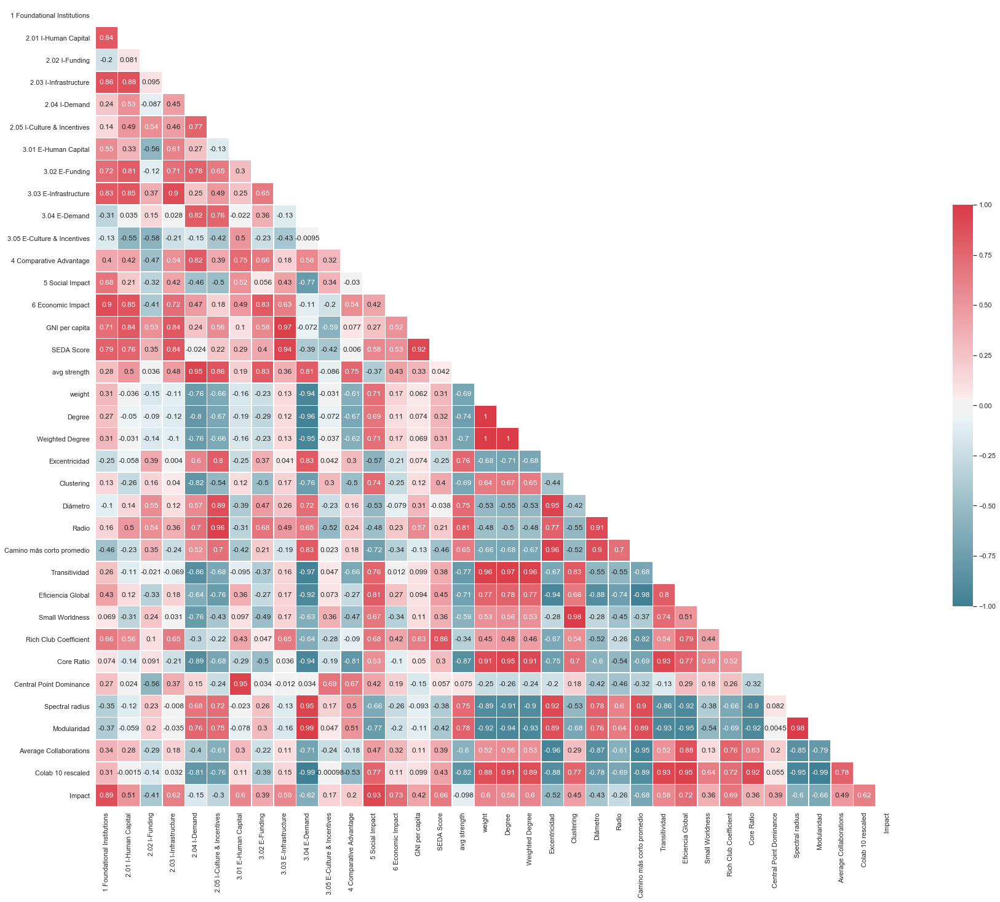

In [79]:
sns.set(style="white")

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(ieco_global_corr_df, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(32, 24))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(ieco_global_corr_df, mask=mask, cmap=cmap, annot=True, vmin=-1, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [80]:
ieco_grf_df

,1 Foundational Institutions,2.01 I-Human Capital,2.02 I-Funding,2.03 I-Infrastructure,2.04 I-Demand,2.05 I-Culture & Incentives,3.01 E-Human Capital,3.02 E-Funding,3.03 E-Infrastructure,3.04 E-Demand,...,Colab 7,Colab 8,Colab 9,Colab 10,Colab 11,Colab 12,Colab 13,Colab 14,Colab 10 rescaled,Impact
México,3.5224,2.363914,1.238062,2.782979,3.102667,2.5160,3.117368,2.299475,3.701600,3.4260,...,0.286659,0.308942,0.304868,0.397667,0.267167,0.266965,0.342306,0.320264,4.976668,3.290692
Uruguay,3.7808,2.234182,1.464989,2.833698,2.578222,1.2428,3.046434,2.006702,3.926000,2.7408,...,0.349355,0.431910,0.385176,0.588490,0.360937,0.360646,0.436381,0.502732,6.884901,3.547541
España,3.9268,2.822386,1.899159,3.191020,3.077333,3.8300,3.189806,2.423851,4.264933,3.3650,...,0.287951,0.316629,0.309405,0.426240,0.286349,0.278308,0.353561,0.403647,5.262402,3.393406
Brasil,3.1780,1.826706,1.662244,2.707140,2.879111,2.7542,2.975761,1.991287,3.694933,3.4638,...,0.255960,0.269424,0.284577,0.384944,0.250892,0.251874,0.326146,0.295488,4.849443,3.192957
Argentina,3.1684,2.051076,1.682002,2.740698,2.729778,1.7930,3.076940,1.725475,3.679067,3.1718,...,0.322560,0.364099,0.343969,0.492850,0.314246,0.312265,0.388024,0.427003,5.928502,3.194659
Chile,3.9124,2.413203,1.184934,3.100109,2.965778,1.9536,4.154179,2.207990,3.935067,3.2030,...,0.316215,0.357342,0.340056,0.480988,0.311826,0.293944,0.369558,0.407755,5.809878,3.550471


##### Impact - Original Collaborativity relation

We print the correlation between the Impact Pilar, and the Colaborations according to the original formula.

In [81]:
colabs_excel=np.array([3.64,5.81,5.60,3.28,4.27,8.47])
r = stats.pearsonr(ieco_grf_df['Impact'], colabs_excel)
r

(0.8581901791330292, 0.028739138399174472)

In [55]:
def check_formula(i):
    print('Checking Formula '+str(i))
    print('---')
    print('Correlation with 5 Impact')
    print(stats.pearsonr(ieco_grf_df['Impact'], ieco_grf_df['Colab '+str(i)]))
    print('')
    print('')
    
check_formula(10)

Checking Formula 10
---
Correlation with 5 Impact
(0.6224336197598077, 0.18692231065013218)




In [82]:
for i in range(15):
    check_formula(i)
    

Checking Formula 0
---
Correlation with 5 Impact
(0.6367317869644482, 0.1739765659778272)


Checking Formula 1
---
Correlation with 5 Impact
(0.72012187108618, 0.10653597636901521)


Checking Formula 2
---
Correlation with 5 Impact
(0.6510684198528762, 0.16138809489521527)


Checking Formula 3
---
Correlation with 5 Impact
(0.6595223674351933, 0.15415258952642177)


Checking Formula 4
---
Correlation with 5 Impact
(0.638708817965472, 0.17221707019848473)


Checking Formula 5
---
Correlation with 5 Impact
(0.8898218570441906, 0.01754009624405095)


Checking Formula 6
---
Correlation with 5 Impact
(0.6119832839069974, 0.19662614702750988)


Checking Formula 7
---
Correlation with 5 Impact
(0.6145427457903483, 0.1942308441841104)


Checking Formula 8
---
Correlation with 5 Impact
(0.6487586794327912, 0.16338929533981544)


Checking Formula 9
---
Correlation with 5 Impact
(0.6372023237485371, 0.1735571250523118)


Checking Formula 10
---
Correlation with 5 Impact
(0.6224336197598077, 0.186

#### Correlaciones Significativas, Positivas y Negativas

We now look for statistically significative correlations betwee:

* iEcosystems pilars and global graph metrics.
* I-Demand components and global graph metrics.
* E-Demand components and global graph metrics.


In [85]:
from IPython.core import display as ICD

In [92]:
#------------------
# iEco - Métricas
#------------------

ieco_pilars=list(df_means.keys())     #Pilares de iEcosystems
grf_metrics=list(grf_df.keys())       #Nombres de metricas globales

for key1 in ieco_pilars:    
    print('                              *-----'+key1+'-----*                              ')
    ICD.display(significant_corr_many(ieco_grf_df,ieco_grf_df,key1,grf_metrics,'Graph Metric'))
    print('')

    
    
for key1 in grf_metrics:    
    print('                              *-----'+key1+'-----*                              ')
    ICD.display(significant_corr_many(ieco_grf_df,ieco_grf_df,key1,ieco_pilars,'iEco Pilar'))
    print('')

                              *-----1 Foundational Institutions-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----2.01 I-Human Capital-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----2.02 I-Funding-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----2.03 I-Infrastructure-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----2.04 I-Demand-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,avg strength,0.950363,0.003635
1,Clustering,-0.820227,0.045573
2,Transitividad,-0.862444,0.027081
3,Core Ratio,-0.889469,0.017650
4,Colab 4,-0.826652,0.042470
5,Colab 6,-0.853713,0.030535



                              *-----2.05 I-Culture & Incentives-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,avg strength,0.858010,0.028810
1,Diámetro,0.888523,0.017948
2,Radio,0.959777,0.002394



                              *-----3.01 E-Human Capital-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Central Point Dominance,0.945932,0.004306



                              *-----3.02 E-Funding-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,avg strength,0.832522,0.039725



                              *-----3.03 E-Infrastructure-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----3.04 E-Demand-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,weight,-0.944992,0.004456
1,Degree,-0.961421,0.002204
2,Weighted Degree,-0.948304,0.003940
3,Excentricidad,0.833886,0.039099
4,Camino más corto promedio,0.834887,0.038643
5,Transitividad,-0.968673,0.001457
6,Eficiencia Global,-0.915266,0.010466
7,Core Ratio,-0.940952,0.005127
8,Spectral radius,0.950644,0.003594
9,Modularidad,0.990644,0.000131



                              *-----3.05 E-Culture & Incentives-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----4 Comparative Advantage-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----5 Social Impact-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Colab 1,0.846849,0.033387
1,Colab 3,0.825530,0.043004
2,Colab 5,0.984010,0.000381



                              *-----6 Economic Impact-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----GNI per capita-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----SEDA Score-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Rich Club Coefficient,0.864547,0.026279



                              *-----avg strength-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.04 I-Demand,0.950363,0.003635
1,2.05 I-Culture & Incentives,0.858010,0.028810
2,3.02 E-Funding,0.832522,0.039725



                              *-----weight-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.944992,0.004456



                              *-----Degree-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.961421,0.002204



                              *-----Weighted Degree-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.948304,0.00394



                              *-----Excentricidad-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,0.833886,0.039099



                              *-----Clustering-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.04 I-Demand,-0.820227,0.045573



                              *-----Diámetro-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.05 I-Culture & Incentives,0.888523,0.017948



                              *-----Radio-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.05 I-Culture & Incentives,0.959777,0.002394



                              *-----Camino más corto promedio-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,0.834887,0.038643



                              *-----Transitividad-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.04 I-Demand,-0.862444,0.027081
1,3.04 E-Demand,-0.968673,0.001457



                              *-----Eficiencia Global-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.915266,0.010466



                              *-----Small Worldness-----*                              


,iEco Pilar,Pearson Correlation,Pvalue



                              *-----Rich Club Coefficient-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,SEDA Score,0.864547,0.026279



                              *-----Core Ratio-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.04 I-Demand,-0.889469,0.017650
1,3.04 E-Demand,-0.940952,0.005127



                              *-----Central Point Dominance-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.01 E-Human Capital,0.945932,0.004306



                              *-----Spectral radius-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,0.950644,0.003594



                              *-----Modularidad-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,0.990644,0.000131



                              *-----Average Collaborations-----*                              


,iEco Pilar,Pearson Correlation,Pvalue



                              *-----Colab 0-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.994728,0.000042



                              *-----Colab 1-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.989082,0.000178
1,5 Social Impact,0.846849,0.033387



                              *-----Colab 2-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.994375,0.000047



                              *-----Colab 3-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.978124,0.000713
1,5 Social Impact,0.825530,0.043004



                              *-----Colab 4-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.04 I-Demand,-0.826652,0.042470
1,3.04 E-Demand,-0.997224,0.000012



                              *-----Colab 5-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.822204,0.044607
1,5 Social Impact,0.984010,0.000381



                              *-----Colab 6-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,2.04 I-Demand,-0.853713,0.030535
1,3.04 E-Demand,-0.991593,0.000106



                              *-----Colab 7-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.922118,0.008862



                              *-----Colab 8-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.968987,0.001428



                              *-----Colab 9-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.971573,0.001201



                              *-----Colab 10-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.988105,0.000211



                              *-----Colab 11-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.969475,0.001383



                              *-----Colab 12-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.985661,0.000307



                              *-----Colab 13-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.984525,0.000357



                              *-----Colab 14-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.914567,0.010636



                              *-----Colab 10 rescaled-----*                              


,iEco Pilar,Pearson Correlation,Pvalue
0,3.04 E-Demand,-0.988105,0.000211


In [93]:
#Imprime correlaciones significativas y positivas (+)
#for keys in positive_pairs:
#    print('')
#    print_significant_corr(ieco_grf_df,ieco_grf_df,keys[0],keys[1])
#    print('')
    

In [94]:
#Imprime correlaciones significativas y negativas (-)
#for keys in negative_pairs:
#    print('')
#    print_significant_corr(ieco_grf_df,ieco_grf_df,keys[0],keys[1])
#    print('')
    

In [97]:
#----------------------
# I-Demand - Métricas
#----------------------

#I-Demand
i_demand = ['2.04a Government procurement of advanced technology (GCI)',
       '2.04b University-industry research collaborations (GII)',
       '2.04c Trade, Competition & Market scale (GII)',
       '3.04a Buyer sophistication (GCI 4.0)',
       '3.04b Domestic Market Scale (GII)']    

grf_metrics = list(grf_df.keys())


for key1 in i_demand:    
    print('                              *-----'+key1+'-----*                              ')
    ICD.display(significant_corr_many(full_ieco_grf_df,ieco_grf_df,key1,grf_metrics,'Graph Metric'))
    print('')

    
    
for key1 in grf_metrics:    
    print('                              *-----'+key1+'-----*                              ')
    ICD.display(significant_corr_many(full_ieco_grf_df,full_ieco_grf_df,key1,i_demand,'I-Demand Component'))
    print('')


                              *-----2.04a Government procurement of advanced technology (GCI)-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----2.04b University-industry research collaborations (GII)-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Colab 5,-0.935589,0.00609



                              *-----2.04c Trade, Competition & Market scale (GII)-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Colab 5,-0.875531,0.022275



                              *-----3.04a Buyer sophistication (GCI 4.0)-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----3.04b Domestic Market Scale (GII)-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----avg strength-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,0.905724,0.012913
1,"2.04c Trade, Competition & Market scale (GII)",0.956704,0.002771



                              *-----weight-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.915265,0.010466



                              *-----Degree-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.853705,0.030538
1,"2.04c Trade, Competition & Market scale (GII)",-0.832578,0.039699
2,3.04b Domestic Market Scale (GII),-0.920467,0.009237



                              *-----Weighted Degree-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.918209,0.009761



                              *-----Excentricidad-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),0.83216,0.039891



                              *-----Clustering-----*                              


,I-Demand Component,Pearson Correlation,Pvalue



                              *-----Diámetro-----*                              


,I-Demand Component,Pearson Correlation,Pvalue



                              *-----Radio-----*                              


,I-Demand Component,Pearson Correlation,Pvalue



                              *-----Camino más corto promedio-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),0.868053,0.024966



                              *-----Transitividad-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.856698,0.029332
1,"2.04c Trade, Competition & Market scale (GII)",-0.883722,0.019495
2,3.04b Domestic Market Scale (GII),-0.940399,0.005223



                              *-----Eficiencia Global-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.945972,0.0043



                              *-----Small Worldness-----*                              


,I-Demand Component,Pearson Correlation,Pvalue



                              *-----Rich Club Coefficient-----*                              


,I-Demand Component,Pearson Correlation,Pvalue



                              *-----Core Ratio-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.971485,0.001208
1,"2.04c Trade, Competition & Market scale (GII)",-0.917195,0.010001
2,3.04b Domestic Market Scale (GII),-0.858939,0.028444



                              *-----Central Point Dominance-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04a Buyer sophistication (GCI 4.0),0.816616,0.047361



                              *-----Spectral radius-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),0.926345,0.007938



                              *-----Modularidad-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),0.979205,0.000644



                              *-----Average Collaborations-----*                              


,I-Demand Component,Pearson Correlation,Pvalue



                              *-----Colab 0-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.831048,0.040406
1,"2.04c Trade, Competition & Market scale (GII)",-0.836183,0.038056
2,3.04b Domestic Market Scale (GII),-0.982208,0.000472



                              *-----Colab 1-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.997948,0.000006



                              *-----Colab 2-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.815499,0.047921
1,"2.04c Trade, Competition & Market scale (GII)",-0.818240,0.046553
2,3.04b Domestic Market Scale (GII),-0.984697,0.000349



                              *-----Colab 3-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,"2.04c Trade, Competition & Market scale (GII)",-0.830503,0.040659
1,3.04b Domestic Market Scale (GII),-0.978960,0.000659



                              *-----Colab 4-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.841363,0.035753
1,"2.04c Trade, Competition & Market scale (GII)",-0.855113,0.029967
2,3.04b Domestic Market Scale (GII),-0.982207,0.000472



                              *-----Colab 5-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.913667,0.010858



                              *-----Colab 6-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.848235,0.032801
1,"2.04c Trade, Competition & Market scale (GII)",-0.877912,0.021448
2,3.04b Domestic Market Scale (GII),-0.976083,0.000851



                              *-----Colab 7-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.918431,0.009709



                              *-----Colab 8-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.961514,0.002193



                              *-----Colab 9-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.96572,0.001743



                              *-----Colab 10-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.831739,0.040086
1,"2.04c Trade, Competition & Market scale (GII)",-0.837597,0.037420
2,3.04b Domestic Market Scale (GII),-0.975359,0.000903



                              *-----Colab 11-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.966017,0.001713



                              *-----Colab 12-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.875088,0.02243
1,"2.04c Trade, Competition & Market scale (GII)",-0.840481,0.03614
2,3.04b Domestic Market Scale (GII),-0.951722,0.00344



                              *-----Colab 13-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.872514,0.023343
1,"2.04c Trade, Competition & Market scale (GII)",-0.836649,0.037846
2,3.04b Domestic Market Scale (GII),-0.951069,0.003533



                              *-----Colab 14-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,3.04b Domestic Market Scale (GII),-0.901093,0.01419



                              *-----Colab 10 rescaled-----*                              


,I-Demand Component,Pearson Correlation,Pvalue
0,2.04b University-industry research collaborati...,-0.831739,0.040086
1,"2.04c Trade, Competition & Market scale (GII)",-0.837597,0.037420
2,3.04b Domestic Market Scale (GII),-0.975359,0.000903


In [98]:
'''
#metricas globales
list2=list(grf_df.keys())

positive_pairs_2=[]
negative_pairs_2=[]

for key1 in list1:                     #por cada componente de IDemand, métrica global revisamos corr. significativa
    for key2 in list2:                 
        sig,corr = significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)
        if sig == True:
            if corr > 0:
                positive_pairs_2.append((key1,key2))        #correlación significativa positiva
            else:
                negative_pairs_2.append((key1,key2))        #correlación significativa negativa
                
                
                
                
                

# Significant and positive correlations (+)

for keys in positive_pairs_2:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')

# Significant and negative correlations (-)

for keys in negative_pairs_2:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
'''


"\n#metricas globales\nlist2=list(grf_df.keys())\n\npositive_pairs_2=[]\nnegative_pairs_2=[]\n\nfor key1 in list1:                     #por cada componente de IDemand, métrica global revisamos corr. significativa\n    for key2 in list2:                 \n        sig,corr = significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)\n        if sig == True:\n            if corr > 0:\n                positive_pairs_2.append((key1,key2))        #correlación significativa positiva\n            else:\n                negative_pairs_2.append((key1,key2))        #correlación significativa negativa\n                \n                \n                \n                \n                \n\n# Significant and positive correlations (+)\n\nfor keys in positive_pairs_2:\n    print('')\n    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])\n    print('')\n\n# Significant and negative correlations (-)\n\nfor keys in negative_pairs_2:\n    print('')\n    print_significant_cor

In [100]:
#--------------------
# Impacto - Métricas
#--------------------

impact_pilar=list(full_ieco_df.keys())[-9:]                #Pilar Impacto
grf_metrics=list(grf_df.keys())                           #Metricas globales


for key1 in impact_pilar:    
    print('                              *-----'+key1+'-----*                              ')
    ICD.display(significant_corr_many(full_ieco_grf_df,ieco_grf_df,key1,grf_metrics,'Graph Metric'))
    print('')

    
    
for key1 in grf_metrics:    
    print('                              *-----'+key1+'-----*                              ')
    ICD.display(significant_corr_many(full_ieco_grf_df,full_ieco_grf_df,key1,impact_pilar,'Impact Component'))
    print('')
    

                              *-----5.03 Inclusive Development Index-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----5.04 Population below international poverty line (SDG 1 - No poverty)-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Camino más corto promedio,-0.895219,0.015893
1,Eficiencia Global,0.826094,0.042735
2,Rich Club Coefficient,0.947143,0.004117
3,Average Collaborations,0.886135,0.018710
4,Colab 7,0.821604,0.044899
5,Colab 14,0.839645,0.036509



                              *-----5.05 Prevalence of undernourishment (SDG 2 - Zero Hunger)-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----5.06 Annual growth rate of real GDP per capita (SDG 8 - Decent Jobs and Economic Growth)-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Excentricidad,-0.861324,0.027513
1,Diámetro,-0.902795,0.013714
2,Camino más corto promedio,-0.837527,0.037452
3,Average Collaborations,0.857898,0.028855



                              *-----5.07 Unemployment rate of population 15 years of age and older (SDG 8 - Decent Jobs and Economic Growth)-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----5.08 Carbon dioxide emissions per unit of GDP (SDG 9 - Industry, Innovation and Infrastructure)-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Central Point Dominance,0.890696,0.017268



                              *-----5.09 Proportion of urban population living in slums (SDG 11 - Sustainable Cities and Communities)-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----5.10 Annual population-weighted average mean concentration of fine suspended particles of less than 2.5 microns in diameter (SDG 11 - Sustainable Cities and Communities)-----*                              


,Graph Metric,Pearson Correlation,Pvalue
0,Radio,-0.838051,0.037217



                              *-----5.11 Domestic material consumption per capita (SDG 12 - Responsible Consumption and Production)-----*                              


,Graph Metric,Pearson Correlation,Pvalue



                              *-----avg strength-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----weight-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Degree-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Weighted Degree-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Excentricidad-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,-0.854631,0.030162



                              *-----Clustering-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Diámetro-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Radio-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Camino más corto promedio-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,-0.918053,0.009798



                              *-----Transitividad-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Eficiencia Global-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,0.852444,0.031053



                              *-----Small Worldness-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Rich Club Coefficient-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.03 Inclusive Development Index,0.892450,0.016728
1,5.04 Population below international poverty li...,0.921143,0.009082



                              *-----Core Ratio-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Central Point Dominance-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Spectral radius-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,-0.811983,0.049703



                              *-----Modularidad-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Average Collaborations-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,0.942788,0.004816



                              *-----Colab 0-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 1-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 2-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 3-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 4-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 5-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.11 Domestic material consumption per capita ...,0.951859,0.003421



                              *-----Colab 6-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 7-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,0.886651,0.018544



                              *-----Colab 8-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,0.837232,0.037584



                              *-----Colab 9-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,0.821461,0.044968



                              *-----Colab 10-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 11-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,0.844562,0.034364



                              *-----Colab 12-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 13-----*                              


,Impact Component,Pearson Correlation,Pvalue



                              *-----Colab 14-----*                              


,Impact Component,Pearson Correlation,Pvalue
0,5.04 Population below international poverty li...,0.893813,0.016315



                              *-----Colab 10 rescaled-----*                              


,Impact Component,Pearson Correlation,Pvalue


In [101]:
'''
positive_pairs_3=[]
negative_pairs_3=[]

for key1 in list1:                                  #revisamos en cada pareja si hay corr. significativa + o -
    for key2 in list2:
        sig,corr=significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)
        if sig==True:
            if corr>0:
                positive_pairs_3.append((key1,key2))
            else:
                negative_pairs_3.append((key1,key2))
                
                
                
                
                
                
#Imprime correlaciones significativas y positivas (+)

for keys in positive_pairs_3:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')

#Imprime correlaciones significativas y negativas (-)

for keys in positive_pairs_3:
    print('')
    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])
    print('')
    
'''


"\npositive_pairs_3=[]\nnegative_pairs_3=[]\n\nfor key1 in list1:                                  #revisamos en cada pareja si hay corr. significativa + o -\n    for key2 in list2:\n        sig,corr=significant_corr(full_ieco_grf_df,full_ieco_grf_df,key1,key2)\n        if sig==True:\n            if corr>0:\n                positive_pairs_3.append((key1,key2))\n            else:\n                negative_pairs_3.append((key1,key2))\n                \n                \n                \n                \n                \n                \n#Imprime correlaciones significativas y positivas (+)\n\nfor keys in positive_pairs_3:\n    print('')\n    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])\n    print('')\n\n#Imprime correlaciones significativas y negativas (-)\n\nfor keys in positive_pairs_3:\n    print('')\n    print_significant_corr(full_ieco_grf_df,full_ieco_grf_df,keys[0],keys[1])\n    print('')\n    \n"

### Part 5: Linear Regressions

In [102]:
from sklearn.linear_model import LinearRegression
from scipy import stats
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d



def lin_reg_p_val(reg,X,y):
    '''
    Esta función busca el p-value entre
    
    - X : np.array
    - y : vector de datos
    
    Es decir, mide la correlación entre un conjunto de puntos X 
    determinado por una pareja de variables y un cnjunto de valores y.
    
    Inputs : specified above
    Output : p-value(X,y)
    '''
    
    # predice el np.array X usando modelo lineal, y suma las distancias al cuadrado de esa predicción hacia y
    # luego divide entre  (X.shape[0] - X.shape[1])= (no.columnas, no.filas)
    sse = np.sum((reg.predict(X) - y) ** 2, axis=0) / float(X.shape[0] - X.shape[1])
    
    if isinstance(sse, float):  
        
        # si sse es un valor decimal, entonces forma se, una matriz (np.array) que al cuadrado
        # es igual a diag( sse * (X^T * X)^-1 ) 
        
        se = np.array([np.sqrt(np.diagonal(sse * np.linalg.inv(np.dot(X.T, X))))])  
        
    else: 
        # si sse no es un valor decimal sino un np.array, entonces se forma se, una lista tal que
        # por cada columna i, el valor se[i]^2 = diag( sse[i] * (X^T * X)^-1 ) 
        
        se = np.array([np.sqrt(np.diagonal(sse[i] * np.linalg.inv(np.dot(X.T, X)))) for i in range(sse.shape[0])])
    
    # p-value entre (X,Y)
    t = reg.coef_ / se
    p = 2 * (1 - stats.t.cdf(np.abs(t), y.shape[0] - X.shape[1]))
    return p




def plot_linear_model(reg,X,y,key1,key2,predict):
    '''
    This function plots the linear modeling of a vector of variables y in terms of 
    a set of points X, determined by 2 data vectors. 
    
    Inputs:
    - reg :     regression model 
    - X :       a set of points representing some data vectors.
    - y :       data which is to be predicted from the other data vectors
    - key1 :    sring for axis label -> predicting data
    - key2 :    sring for axis label -> predicting data
    - predict : string for axis label -> predicted data
    
    Outputs: 
    None, and a ~very nice~ 3D plot showing how good 
    data collection X might be in predicting linearly data vector y.
    '''
    
    ax = plt.axes(projection='3d')      #setup of 3D projection
    plt.tight_layout()
    
    a = np.linspace(1, 5, 30)           #a,b : grids with 30 equidistant values in (1,5)
    b = np.linspace(1, 5, 30)
    
    A,B = np.meshgrid(a,b)           
    C = A*reg.coef_[0] + B*reg.coef_[1] + reg.intercept_   # plane approximates y by X
    
    
    ax.scatter3D(X[:,0], X[:,1], y, cmap='Greens')         # Scatter X (green)
    ax.contour3D(A, B, C, 50, cmap='binary')               # 3D contour of the linear approx
    
    
    ax.set_title('Linear Model')                           # Title, coords, lims 
    ax.set_xlabel(key1, fontsize=9)                                    
    ax.set_ylabel(key2, fontsize=9)
    ax.set_zlabel(predict, fontsize=9)
    plt.xlim((1,5))
    plt.ylim((1,5))
    plt.show()                                             #pull down the curtains!

#### Modelo linear de 4 dimensiones

Se obtiene mucha información a analizar, posiblemente no es útil. 
No se continuó este análisis con más dimensiones, ya que sucedería algo parecido
~ Cualesquiera $n+1$ puntos están sobre un hiperplano $n$-dimensional

In [103]:
ieco_key_list=list(df_means.keys())
ieco_key_list.remove('4 Comparative Advantage')
ieco_key_list.remove('5 Social Impact')                            #ieco pilars but 4,5


ieco_key_predictors=['4 Comparative Advantage','5 Social Impact']  #data to predict


grf_key_list=list(grf_df.keys())                            #graph global metrics 


for key1 in ieco_key_list:     
    for key2 in ieco_key_list:
        if key1 != key2:
            for key3 in ieco_key_list:
                if key3 !=key1 and key3 !=key2:         # for every (a,b,c) different ieco metrics
                    
                    for predict in ieco_key_predictors: 
                        #X=np.concatenate([ieco_df[key1].to_numpy(),ieco_df[key2].to_numpy(),ieco_df[key3].to_numpy()],axis=0)
                        X = np.concatenate([df_means[key1].to_numpy(),df_means[key2].to_numpy(),df_means[key3].to_numpy()],axis=0)
                        X = X.reshape(6,3)
                        y = df_means[predict].to_numpy()
                        reg = LinearRegression().fit(X,y)
                        p = lin_reg_p_val(reg,X,y)
                        if p[0][0]<.05 and p[0][1]<.05 and p[0][2]<.05 and reg.score(X,y)>.9:
                            print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                            print('Predictor metrics: '+key1+', '+key2+', '+key3)
                            print('Predicted: '+predict)
                            print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                            print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                            print('Regression Coefficients: ' + str(reg.coef_) )
                            print('')
                            print('')
                            print('')


- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 1 Foundational Institutions, 2.02 I-Funding, 3.03 E-Infrastructure
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9626609973525, p-value: [[0.00520207 0.00300066 0.01164813]]
Regression Coefficients: [ 1.48330159 -1.87623323  0.3851877 ]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 1 Foundational Institutions, 2.03 I-Infrastructure, 2.01 I-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9819033651386696, p-value: [[0.008526   0.00155504 0.01987356]]
Regression Coefficients: [-1.09464452  1.36646891 -0.45114714]



- - - - - - - - - - - - - - - - - - - - - - - - - - - -

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.01 I-Human Capital, SEDA Score, 3.05 E-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9111412843060206, p-value: [[0.03894179 0.02823921 0.03444444]]
Regression Coefficients: [ 0.40733396 -0.52777026  0.38758022]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.02 I-Funding, 2.01 I-Human Capital, 3.05 E-Culture & Incentives
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9141749742342428, p-value: [[0.00629926 0.00804553 0.0353956 ]]
Regression Coefficients: [ 1.11258367 -1.04032893 -0.30996504]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

Regression Score: 0.957566017236787, p-value: [[0.00934052 0.00497515 0.00241753]]
Regression Coefficients: [ 0.61687534 -0.99381953  0.73038514]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.04 I-Demand, 3.04 E-Demand, 2.02 I-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9080516294106209, p-value: [[0.00869185 0.01743603 0.02257204]]
Regression Coefficients: [ 0.93276161 -0.77985661 -0.48289776]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.04 I-Demand, 3.04 E-Demand, 3.05 E-Culture & Incentives
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9071298151927439, p-value: [[0.01300978 0.01527493 0.00812086]]
Regres

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.01 E-Human Capital, 2.03 I-Infrastructure, 2.01 I-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9292760865785546, p-value: [[0.040937   0.02008974 0.0128034 ]]
Regression Coefficients: [-0.98313832  1.526272   -0.60239978]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.01 E-Human Capital, 2.03 I-Infrastructure, 2.02 I-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9851386791578473, p-value: [[0.04159337 0.00524145 0.00056089]]
Regression Coefficients: [-0.58145718  1.40776294 -0.61737012]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - 

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 3.02 E-Funding, 3.01 E-Human Capital
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9613934192163961, p-value: [[0.00013707 0.00015135 0.00080591]]
Regression Coefficients: [ 3.35265401 -3.58895027  1.05193978]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 6 Economic Impact, GNI per capita
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9616069248642392, p-value: [[0.00525356 0.00375414 0.00228354]]
Regression Coefficients: [-2.44358918  4.45102127 -2.08598748]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.05 E-Culture & Incentives, SEDA Score, 2.05 I-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9285914402145532, p-value: [[0.00224368 0.02590544 0.00974941]]
Regression Coefficients: [-0.63198238  0.19586603 -0.26124751]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.05 E-Culture & Incentives, SEDA Score, 3.04 E-Demand
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.925065341173679, p-value: [[0.00485915 0.00187231 0.0142859 ]]
Regression Coefficients: [ 0.61659204  1.09608274 -0.5166848 ]



- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 1 Foundational Institutions, 2.05 I-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8624862036677217, p-value: [[0.00236958 0.04790045]]
Regression Coefficients: [-0.33303143  0.1486706 ]
Intercept: 3.4051828190951383


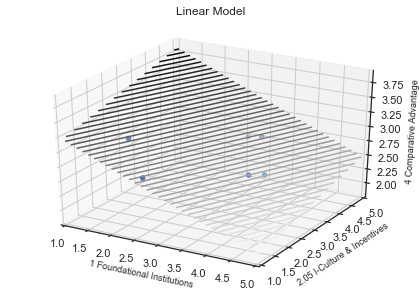




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 1 Foundational Institutions, 3.01 E-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8680046332592102, p-value: [[0.01962602 0.00446007]]
Regression Coefficients: [-0.24610445  0.35690902]
Intercept: 2.3493181417983


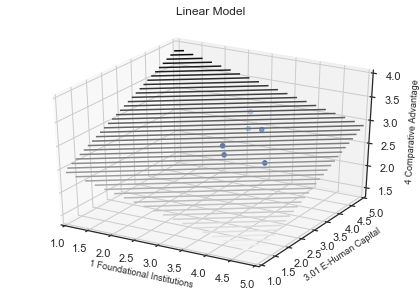




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.01 I-Human Capital, 3.01 E-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8252474839034285, p-value: [[0.00562493 0.01339231]]
Regression Coefficients: [-0.38904339  0.29607652]
Intercept: 3.0370226863801357


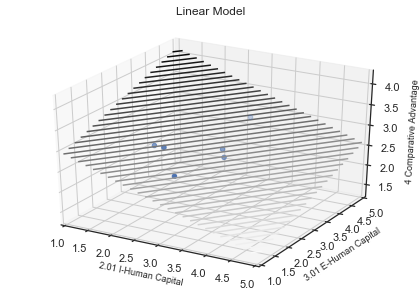




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.03 I-Infrastructure, 2.04 I-Demand
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9088027040907121, p-value: [[0.00010116 0.00224276]]
Regression Coefficients: [-1.43418345 -0.66517779]
Intercept: 8.885471432060623


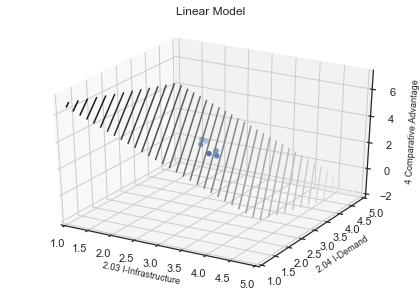




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.03 I-Infrastructure, 3.01 E-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8959885019484376, p-value: [[0.00082338 0.00654579]]
Regression Coefficients: [-0.64191814  0.35068771]
Intercept: 3.6174030738535103


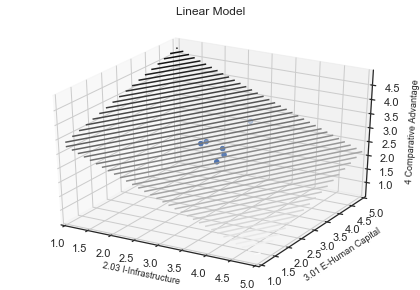




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.03 I-Infrastructure, 3.02 E-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8828683659537775, p-value: [[0.00413262 0.01191097]]
Regression Coefficients: [-0.55698798  0.42263725]
Intercept: 3.142748242204674


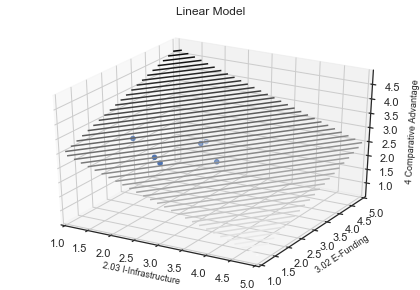




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.03 I-Infrastructure, 6 Economic Impact
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8023059522013232, p-value: [[0.00917382 0.04333979]]
Regression Coefficients: [-0.74421378  0.4644815 ]
Intercept: 3.5598500810063642


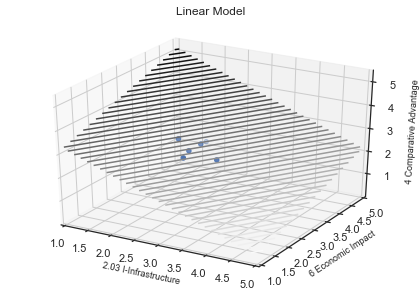




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 2.04 I-Demand, 2.03 I-Infrastructure
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8065861428630028, p-value: [[0.00252234 0.00026651]]
Regression Coefficients: [0.96516304 1.79149816]
Intercept: -3.776388025053799


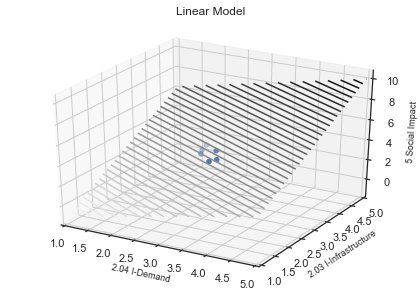




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 1 Foundational Institutions
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8783066730184239, p-value: [[0.00261551 0.02993733]]
Regression Coefficients: [-0.47263332  0.23225349]
Intercept: 3.666500193078298


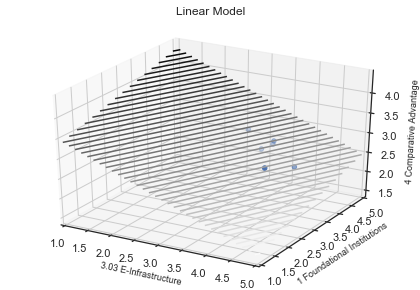




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 2.01 I-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8891614810990456, p-value: [[0.00296594 0.00830086]]
Regression Coefficients: [-0.44414597  0.34669848]
Intercept: 3.136876596203006


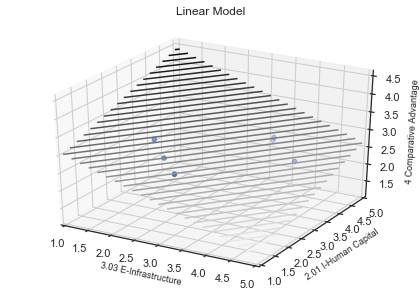




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 2.03 I-Infrastructure
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8877406308631948, p-value: [[0.00447549 0.00642829]]
Regression Coefficients: [-0.55328986  0.50526285]
Intercept: 2.957640926101755


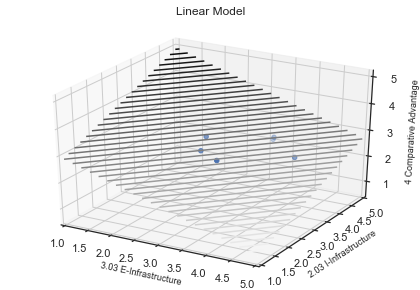




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 2.05 I-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.923967920764924, p-value: [[0.00079869 0.00983197]]
Regression Coefficients: [-0.37962653  0.211728  ]
Intercept: 3.414931370780419


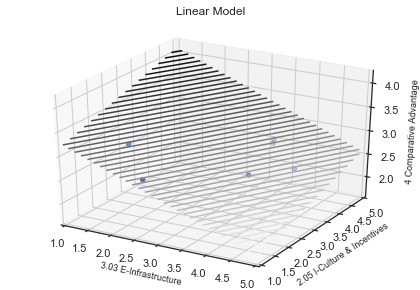




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 3.01 E-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9291860926847311, p-value: [[0.00257472 0.00157257]]
Regression Coefficients: [-0.37328912  0.41167378]
Intercept: 2.5981636320534314


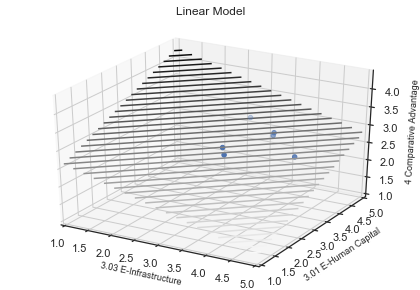




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 3.02 E-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9644610660376559, p-value: [[0.00043928 0.00069192]]
Regression Coefficients: [-0.53209963  0.48196875]
Intercept: 2.9587954420139106


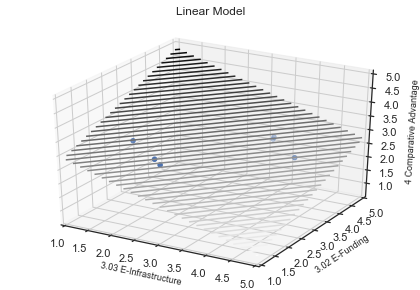




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.03 E-Infrastructure, 6 Economic Impact
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8726364915582316, p-value: [[0.00603562 0.00799709]]
Regression Coefficients: [-0.62954757  0.58731423]
Intercept: 2.9335095464953946


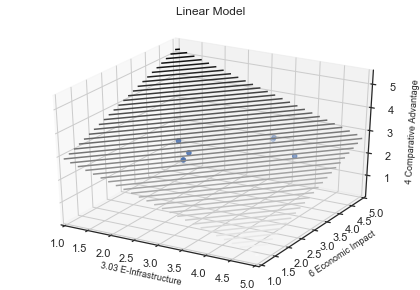




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.04 E-Demand, 3.01 E-Human Capital
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.871078800969902, p-value: [[0.00058252 0.0022578 ]]
Regression Coefficients: [0.76299264 0.52371708]
Intercept: -0.01593702482424053


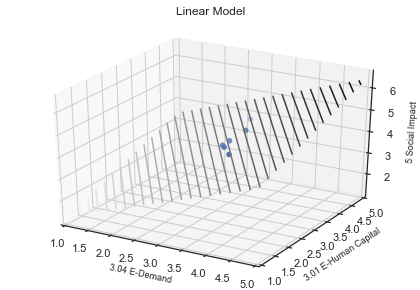




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.04 E-Demand, 3.02 E-Funding
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8181120830535034, p-value: [[0.01750505 0.0110237 ]]
Regression Coefficients: [-0.47646625  0.57536673]
Intercept: 3.959738737614341


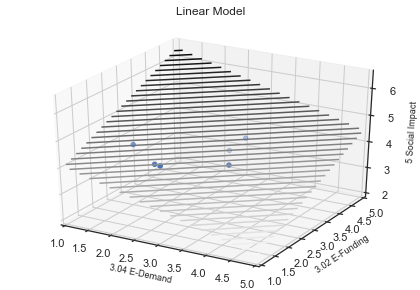




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.04 E-Demand, 3.05 E-Culture & Incentives
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.881560499258964, p-value: [[0.00467905 0.00039918]]
Regression Coefficients: [0.48569315 0.8887761 ]
Intercept: -0.19702031054516755


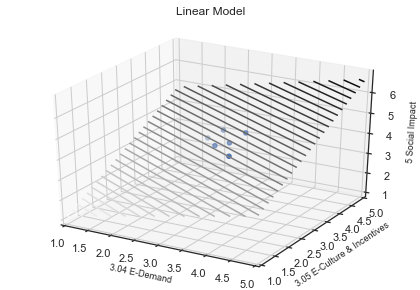




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.05 E-Culture & Incentives, 2.04 I-Demand
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.899104088844401, p-value: [[7.25240710e-05 4.49302401e-02]]
Regression Coefficients: [-1.42096236 -0.22957784]
Intercept: 8.96814095324051


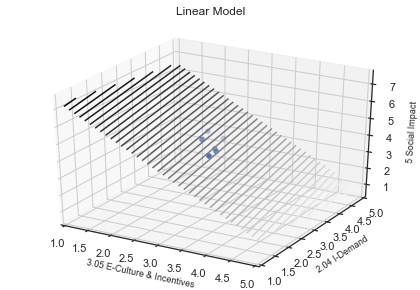




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.05 E-Culture & Incentives, 3.02 E-Funding
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8658745930157823, p-value: [[0.00234225 0.01144778]]
Regression Coefficients: [-0.69168515  0.40672376]
Intercept: 4.780791866549664


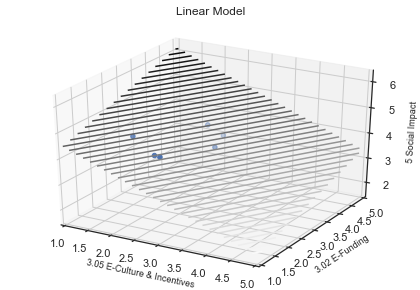




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: 3.05 E-Culture & Incentives, 6 Economic Impact
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9728104751951197, p-value: [[2.12045506e-05 1.03022318e-03]]
Regression Coefficients: [-1.28264307  0.43656799]
Intercept: 6.3397323647929955


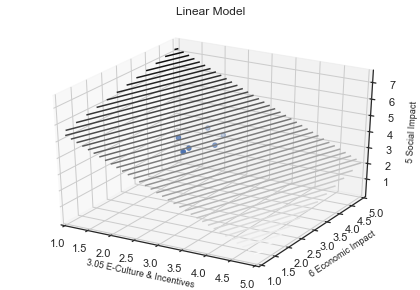




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: GNI per capita, 1 Foundational Institutions
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9016411375664111, p-value: [[0.00343281 0.00406272]]
Regression Coefficients: [-0.32399964  0.31116456]
Intercept: 2.828990014199505


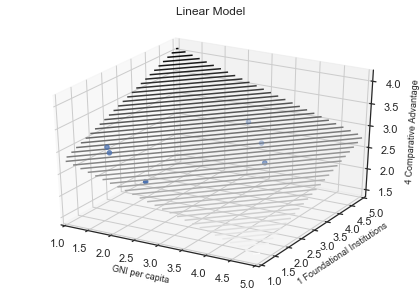




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: GNI per capita, 2.01 I-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9124719627413033, p-value: [[0.00516899 0.00153196]]
Regression Coefficients: [-0.28354418  0.44319472]
Intercept: 2.538561216599491


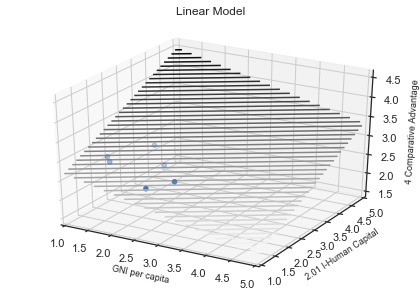




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: GNI per capita, 2.02 I-Funding
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8522415273639866, p-value: [[0.02549055 0.00192936]]
Regression Coefficients: [ 0.30074531 -0.70889948]
Intercept: 4.729716955608209


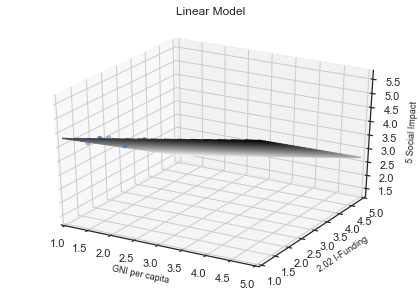




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: GNI per capita, 2.03 I-Infrastructure
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8418240420323302, p-value: [[0.0102447  0.01001266]]
Regression Coefficients: [-0.37264925  0.39084445]
Intercept: 2.7766140953730725


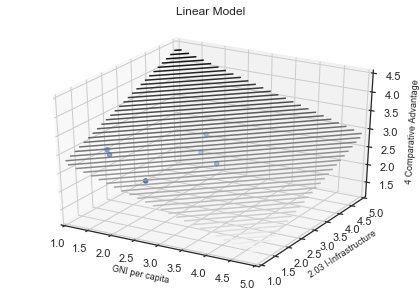




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: GNI per capita, 3.01 E-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9569026616947668, p-value: [[0.00052254 0.00075626]]
Regression Coefficients: [-0.3651363  0.3175078]
Intercept: 2.8840303059978956


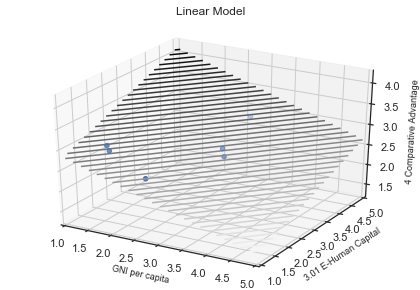




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: GNI per capita, 3.02 E-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.914748593156937, p-value: [[0.00317476 0.00236327]]
Regression Coefficients: [-0.36679368  0.43012511]
Intercept: 2.710127130140055


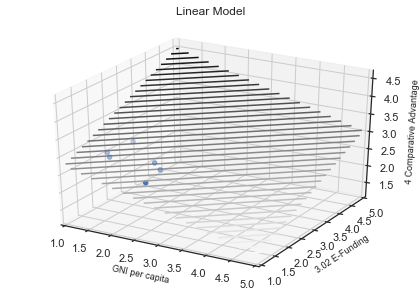




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: SEDA Score, 1 Foundational Institutions
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.89769957038574, p-value: [[0.00384114 0.00449681]]
Regression Coefficients: [-0.31763302  0.30182379]
Intercept: 2.825961718140971


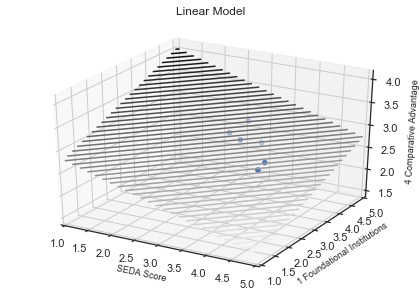




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: SEDA Score, 2.01 I-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9127163969515835, p-value: [[0.00151687 0.00801059]]
Regression Coefficients: [-0.37750424  0.25044703]
Intercept: 3.182582768677997


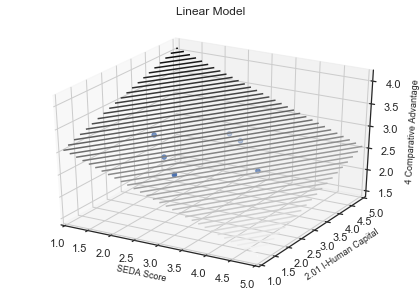




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: SEDA Score, 2.03 I-Infrastructure
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.814209851991354, p-value: [[0.01047002 0.02273661]]
Regression Coefficients: [-0.39151268  0.31333307]
Intercept: 3.03325897010907


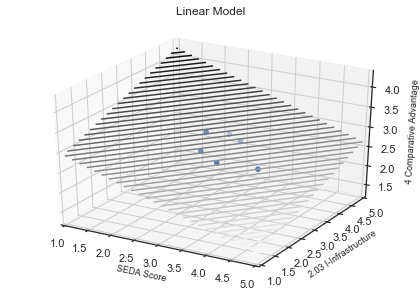




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: SEDA Score, 2.05 I-Culture & Incentives
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9766700700303009, p-value: [[7.35180868e-05 3.16350577e-03]]
Regression Coefficients: [-0.33997038  0.14381275]
Intercept: 3.431184923829238


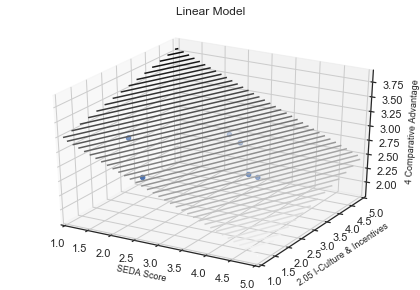




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: SEDA Score, 3.01 E-Human Capital
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9744045585007703, p-value: [[0.00098758 0.00012982]]
Regression Coefficients: [-0.23537     0.38075058]
Intercept: 2.262594933439936


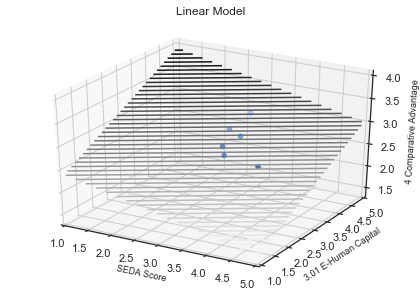




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: SEDA Score, 3.01 E-Human Capital
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8959486267729265, p-value: [[0.00019147 0.00194143]]
Regression Coefficients: [0.76910502 0.40528087]
Intercept: 0.29089567740693933


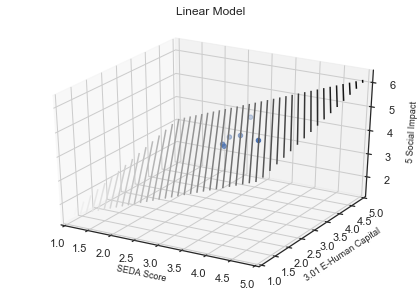




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: SEDA Score, 3.02 E-Funding
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.911302607419086, p-value: [[0.00243711 0.00558248]]
Regression Coefficients: [-0.38890629  0.3167342 ]
Intercept: 2.9961682969017076


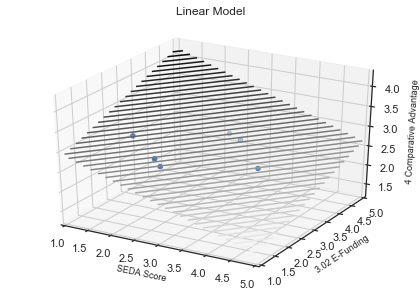

In [104]:
'''
3D linear model for predicting impact and comparative advantage from iEcosystem metrics
'''

for key1 in ieco_key_list:                         # for each pair (a,b) of distinct ieco metrics
    for key2 in ieco_key_list:
        if key1 != key2:
            for predict in ieco_key_predictors:    #or each predictor from Impact and C. Advantage
                
                #numpy array for predicted vals: 2 rows, 6 columns
                X=np.concatenate([df_means[key1].to_numpy(),df_means[key2].to_numpy()],axis=0)
                X=X.reshape(6,2)
                
                #make a numpy array for predictor
                y=df_means[predict].to_numpy()
                
                #make a Linear regression and obtains p-value using previously defined function
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if both p-values are small enough and the linear regression score is greater than 0.8
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 0
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8125445381153824, p-value: [[0.00079287 0.0214341 ]]
Regression Coefficients: [0.22552581 0.06750384]
Intercept: 1.4582242517058064


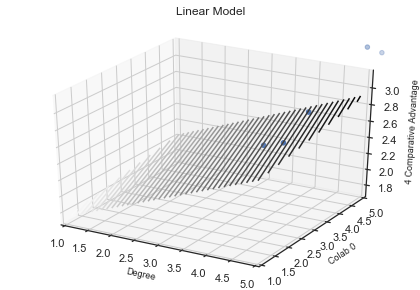




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Radio
Predicted: Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8356600390999225, p-value: [[0.00723806 0.00882837]]
Regression Coefficients: [-0.26310367  0.26905348]
Intercept: 3.463423683258357


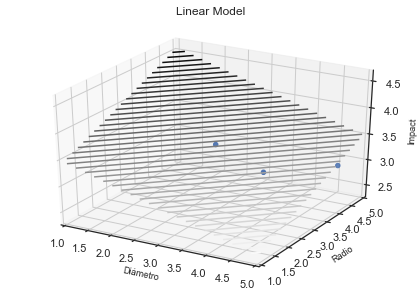




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Radio
Predicted: Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9400128254252107, p-value: [[0.00096884 0.00350636]]
Regression Coefficients: [-0.26650967  0.2110308 ]
Intercept: 3.6557536339544576


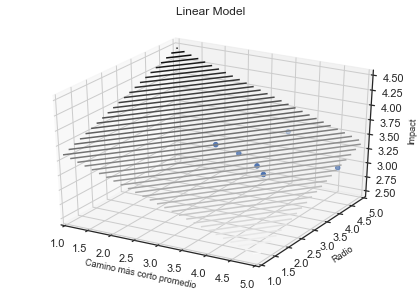




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8434454335582249, p-value: [[0.00069399 0.0072479 ]]
Regression Coefficients: [5.32393759 2.48551966]
Intercept: 0.32245590034261307


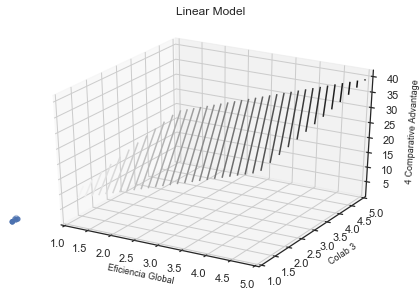




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, avg strength
Predicted: Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8601353417279914, p-value: [[0.00884553 0.0108704 ]]
Regression Coefficients: [-0.96183636  0.9194466 ]
Intercept: 3.5066793141043946


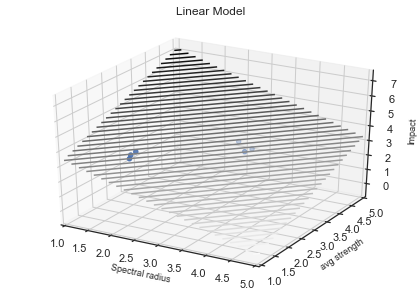




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Radio
Predicted: Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8531667332446559, p-value: [[0.00532111 0.0041006 ]]
Regression Coefficients: [-0.40386629  0.50633138]
Intercept: 3.232126438136304


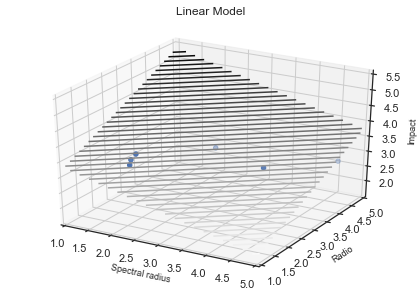




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9253196880781039, p-value: [[0.00230154 0.00142145]]
Regression Coefficients: [-1.08905326  1.23373686]
Intercept: 3.1560140735601863


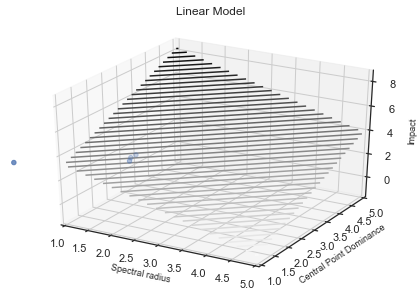




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, avg strength
Predicted: Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8488315814610858, p-value: [[0.00934685 0.0117026 ]]
Regression Coefficients: [-0.81068235  0.77357888]
Intercept: 3.480645524701658


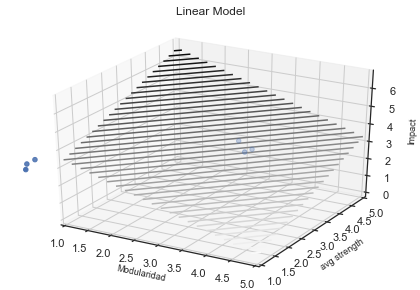




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Radio
Predicted: Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.92600567480919, p-value: [[0.0027961  0.00361816]]
Regression Coefficients: [-0.40084216  0.45221037]
Intercept: 3.4083799126995395


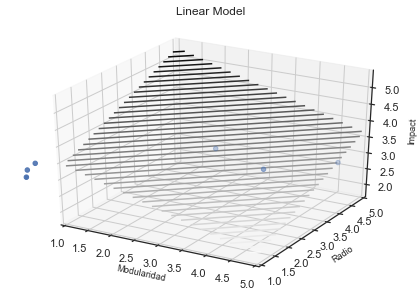




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8300769448403249, p-value: [[0.00425878 0.02905028]]
Regression Coefficients: [6.49668266 3.51819359]
Intercept: -0.2826269653071858


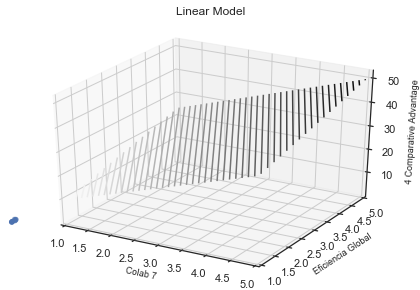




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8378846018153516, p-value: [[0.00070244 0.00995386]]
Regression Coefficients: [5.27714853 2.28805901]
Intercept: 0.4321439084374754


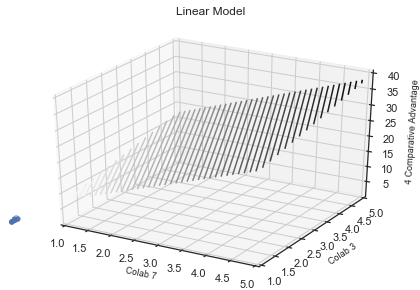




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8324045558491338, p-value: [[0.00077749 0.00562599]]
Regression Coefficients: [5.21331968 2.71007649]
Intercept: 0.21761556775495094


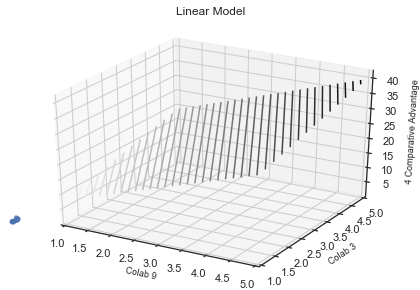




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Colab 7
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.815209361498338, p-value: [[0.00229071 0.01638164]]
Regression Coefficients: [6.74259217 3.69792834]
Intercept: -0.3176015396952723


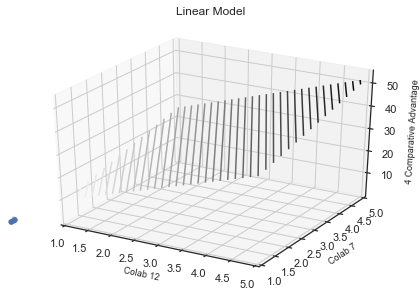




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Colab 11
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8635932194226336, p-value: [[0.00039462 0.00443414]]
Regression Coefficients: [8.17183187 4.03478123]
Intercept: -0.7995889765086912


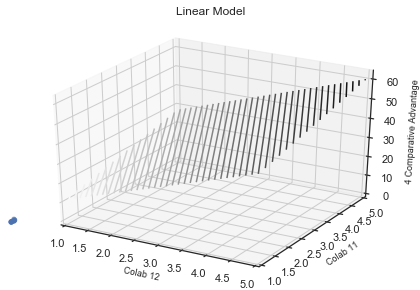




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 14
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8266984715758865, p-value: [[0.00046128 0.00261021]]
Regression Coefficients: [5.08449359 3.05303841]
Intercept: -0.30259582360953097


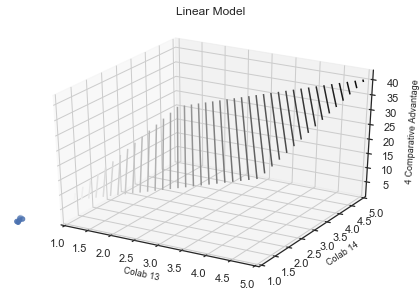

In [108]:
'''
3D linear models for predicting impact and comparative advantage using graph metrics
'''
# list of all global metrics
grf_key_list=list(grf_df.keys())

# our two predictors
ieco_key_predictors=['4 Comparative Advantage','Impact']    

for key1 in grf_key_list:
    for key2 in grf_key_list:                                 # for each pair (a,b) of distinct global metrics
        if key1 != key2:                                      
            for predict in ieco_key_predictors:               # and each predictor
                
                # we make a numpy array with the predicted values and reshape it into 2 rows, 6 columns
                #X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = X.reshape(6,2)
                
                # make a numpy array for our predictor
                y=ieco_grf_df[predict].to_numpy()
                
                #make linear regression with X,y data and obtain p-value
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if p-value is small enough and the regression score is greater than 0.8:
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')

- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9560595353728496, p-value: [[0.00081797 0.0014498 ]]
Regression Coefficients: [-0.65729902  0.63327353]
Intercept: 3.899006312792292


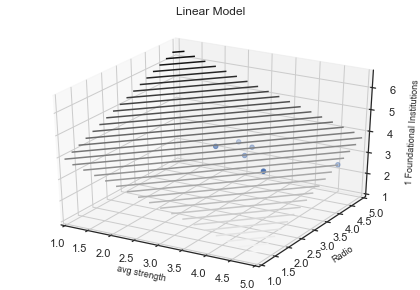




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Radio
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8349420022652829, p-value: [[0.01002605 0.00498841]]
Regression Coefficients: [-0.63160173  0.86056979]
Intercept: 1.7470124024871647


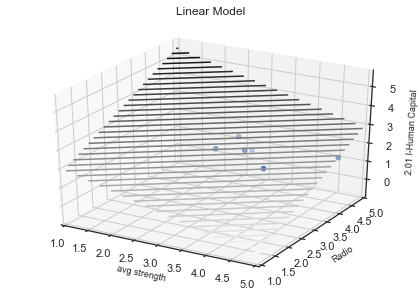




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9265728753682966, p-value: [[0.00239357 0.00495996]]
Regression Coefficients: [-0.25056271  0.23007449]
Intercept: 2.728464566877369


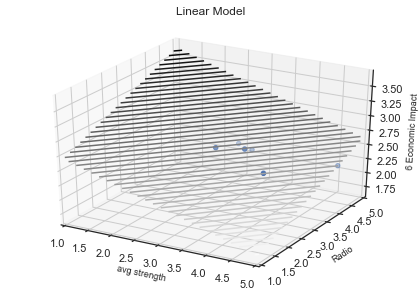




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8035900528047791, p-value: [[0.02759296 0.02292714]]
Regression Coefficients: [-1.21524581  1.30895188]
Intercept: 3.716373991118594


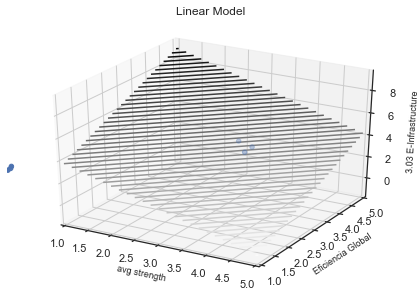




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Eficiencia Global
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8606042953103561, p-value: [[0.01356809 0.01119182]]
Regression Coefficients: [-2.17340112  2.33618765]
Intercept: 1.4629824324763903


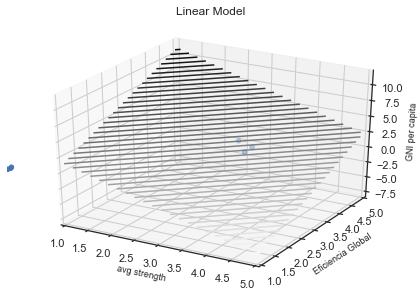




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.821890490337849, p-value: [[0.02261855 0.01588606]]
Regression Coefficients: [-1.41836269  1.60096786]
Intercept: 3.213275200691128


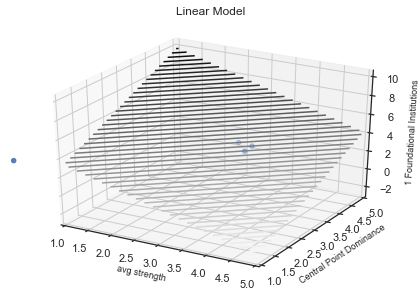




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8532589646121833, p-value: [[0.02015587 0.01342029]]
Regression Coefficients: [-1.30454654  1.49403529]
Intercept: 1.9070550780320956


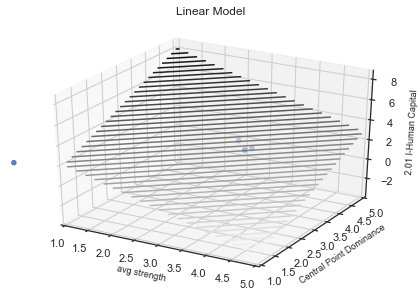




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9284288302499556, p-value: [[0.00173471 0.00137354]]
Regression Coefficients: [-1.08074574  1.16458909]
Intercept: 2.713586235385497


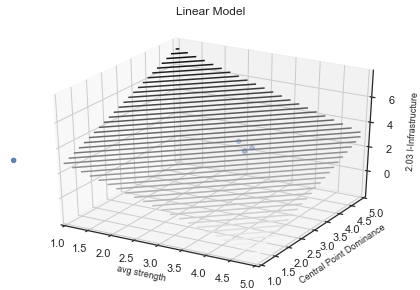




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9518291237394009, p-value: [[0.00121716 0.00086149]]
Regression Coefficients: [-1.09343685  1.21255118]
Intercept: 3.6228566844043097


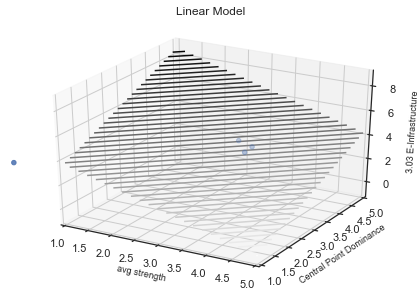




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8782204669327816, p-value: [[0.00816118 0.00586733]]
Regression Coefficients: [-1.77126763  1.96918474]
Intercept: 1.3189188542121035


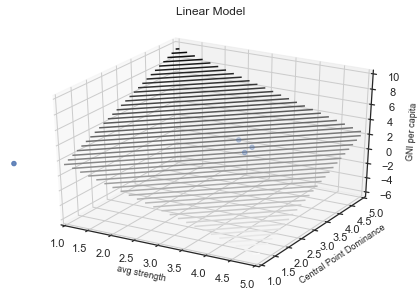




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Central Point Dominance
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9245334029191825, p-value: [[0.00237766 0.0017823 ]]
Regression Coefficients: [-1.84835753  2.02209675]
Intercept: 2.994110396082017


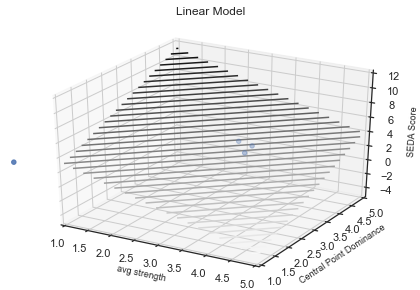




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Spectral radius
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8868599960282026, p-value: [[0.00984794 0.00661468]]
Regression Coefficients: [-2.00083749  2.27266585]
Intercept: 1.0815472846615253


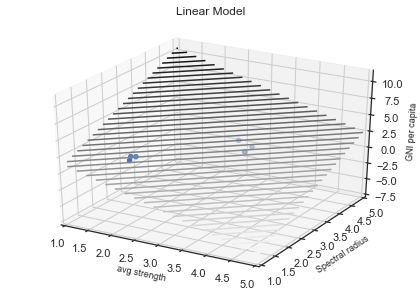




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Spectral radius
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8543112783328078, p-value: [[0.01306945 0.0096001 ]]
Regression Coefficients: [-1.97451821  2.19112059]
Intercept: 2.8579584074806905


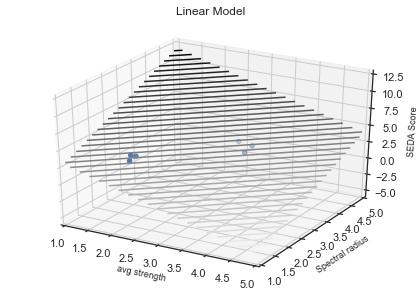




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 0
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8108084213511396, p-value: [[0.0117879  0.03952859]]
Regression Coefficients: [0.17143826 0.09672746]
Intercept: 1.9348817958118005


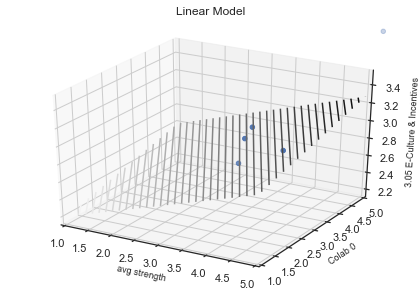




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 5
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8484894874888855, p-value: [[0.01419207 0.0102515 ]]
Regression Coefficients: [-1.22924816  1.36711549]
Intercept: 3.5685832473369667


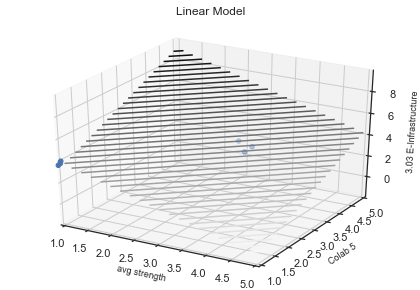




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 5
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8717728706752285, p-value: [[0.01003375 0.00720896]]
Regression Coefficients: [-2.13710478  2.37450291]
Intercept: 1.20969117228431


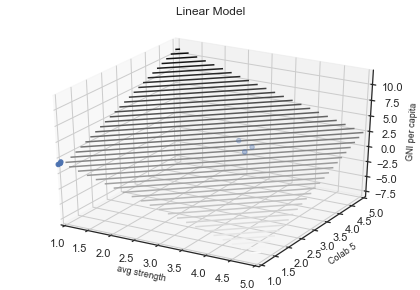




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 7
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8512438994971643, p-value: [[0.01573874 0.01318145]]
Regression Coefficients: [-2.1635654   2.31764838]
Intercept: 1.4916371937369404


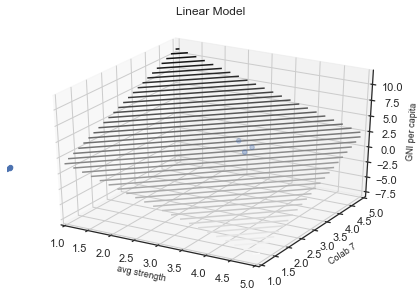




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 9
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8291283155701237, p-value: [[0.02075603 0.01718267]]
Regression Coefficients: [-2.10569231  2.26626073]
Intercept: 1.466485093404643


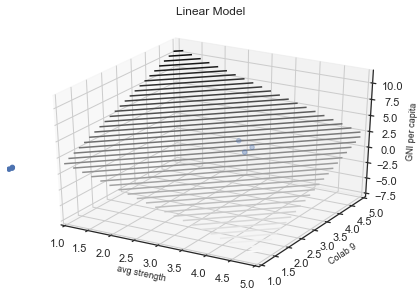




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: avg strength, Colab 11
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8047934784989931, p-value: [[0.02741512 0.02272712]]
Regression Coefficients: [-2.03195569  2.19016353]
Intercept: 1.470261959567715


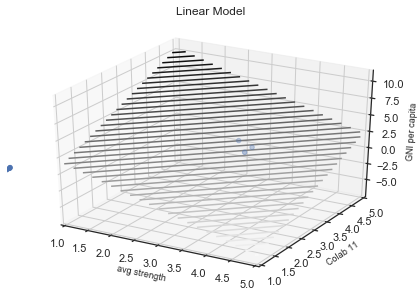




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Small Worldness
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8982065862794902, p-value: [[0.00138839 0.00806508]]
Regression Coefficients: [ 1.09753231 -0.50470712]
Intercept: 2.854121781662412


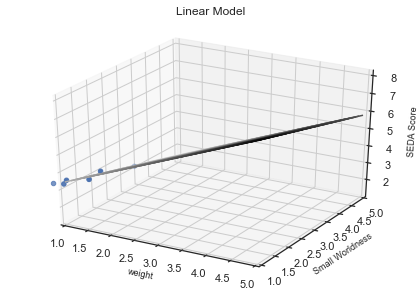




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Core Ratio
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.808414470428533, p-value: [[0.00651574 0.0213248 ]]
Regression Coefficients: [ 1.0496642  -0.55080764]
Intercept: 3.010167954828863


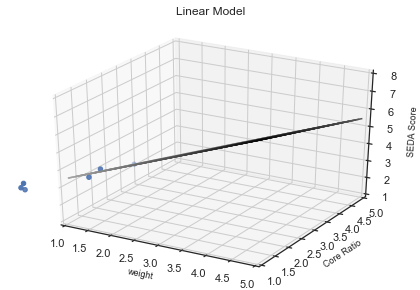




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 1
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8527929824415814, p-value: [[0.00125443 0.01386685]]
Regression Coefficients: [ 1.36240937 -0.53704151]
Intercept: 2.5527104811850014


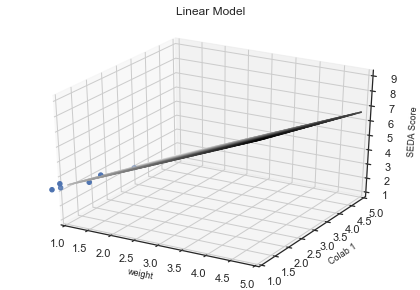




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 2
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8469872889018657, p-value: [[0.00887491 0.0128342 ]]
Regression Coefficients: [ 0.80435095 -0.52191694]
Intercept: 3.3035381630996055


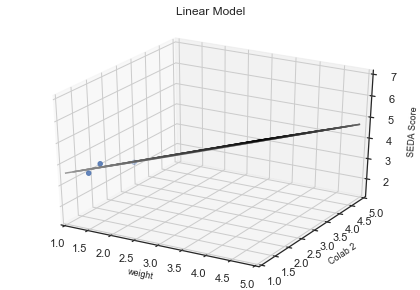




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: weight, Colab 10
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8061111934017071, p-value: [[0.00738887 0.02240667]]
Regression Coefficients: [ 1.02594032 -0.54686535]
Intercept: 3.037858425074458


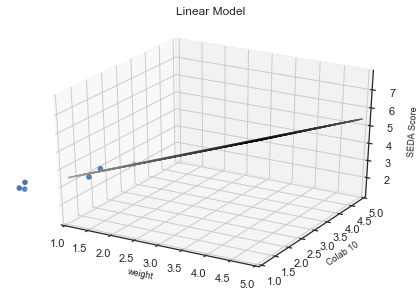




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, weight
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.87240782266958, p-value: [[0.00342191 0.01086615]]
Regression Coefficients: [ 0.31288361 -0.16629786]
Intercept: 3.0871689600898238


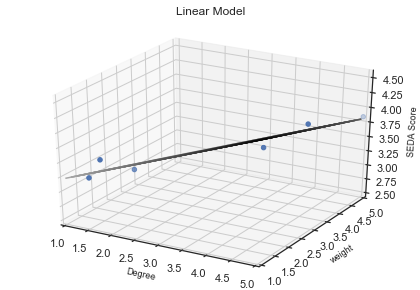




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Small Worldness
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8297985492713946, p-value: [[0.00781812 0.01999646]]
Regression Coefficients: [ 0.29749722 -0.16632896]
Intercept: 3.152360817425266


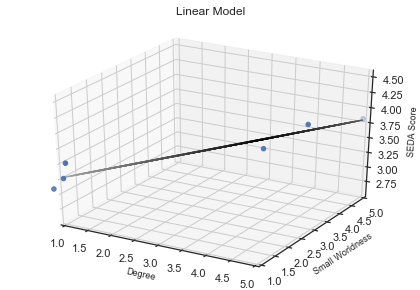




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 0
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8125445381153824, p-value: [[0.00079287 0.0214341 ]]
Regression Coefficients: [0.22552581 0.06750384]
Intercept: 1.4582242517058064


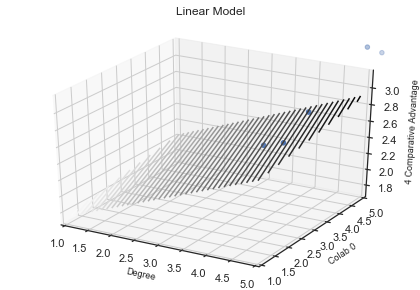




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Degree, Colab 2
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8103292610636523, p-value: [[0.01261008 0.02264405]]
Regression Coefficients: [ 0.27352735 -0.16826241]
Intercept: 3.251829771305564


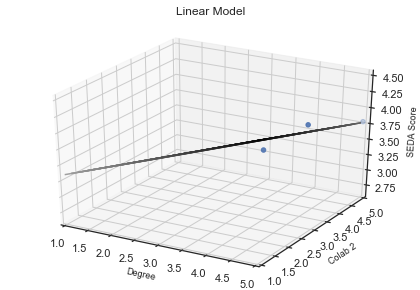




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Degree
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.853061942277597, p-value: [[0.00501481 0.01282181]]
Regression Coefficients: [ 0.10126776 -0.05651684]
Intercept: 3.109836227452941


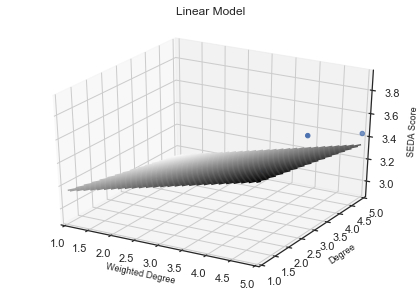




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Average Collaborations
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9622127111647771, p-value: [[3.03008586e-07 4.68838328e-02]]
Regression Coefficients: [ 0.28206276 -0.01000692]
Intercept: -0.6168605704235546


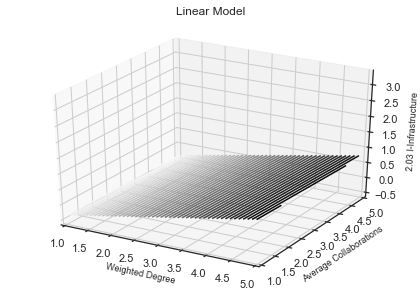




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Average Collaborations
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9571522537013795, p-value: [[7.69504652e-07 1.65841624e-02]]
Regression Coefficients: [0.29557741 0.01849595]
Intercept: -1.994616309290294


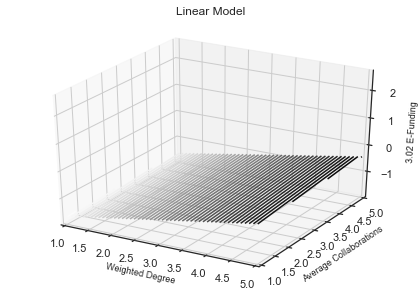




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Average Collaborations
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8931624852716993, p-value: [[4.54058473e-06 2.53574901e-02]]
Regression Coefficients: [ 0.43616897 -0.03734863]
Intercept: -1.7492619235427065


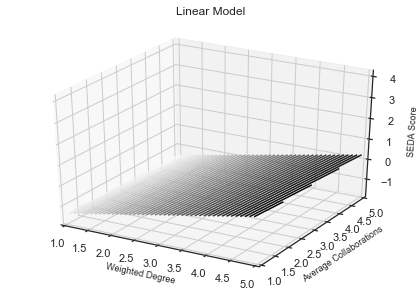




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 0
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.869412215218316, p-value: [[0.0035691  0.01105743]]
Regression Coefficients: [ 0.10155029 -0.05408262]
Intercept: 3.069602969627109


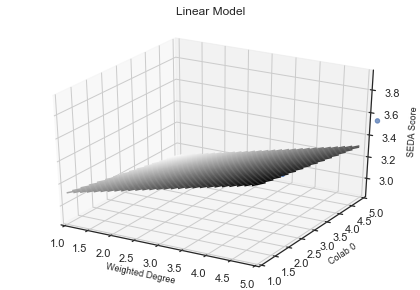




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Weighted Degree, Colab 10 rescaled
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8165116471357965, p-value: [[0.0048431  0.02081204]]
Regression Coefficients: [ 0.114533   -0.05615312]
Intercept: 2.9320492037310086


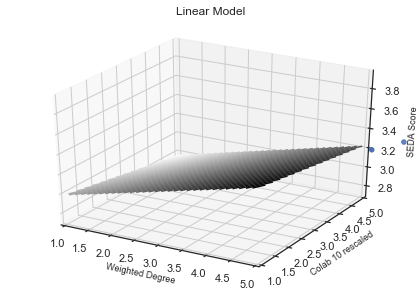




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Excentricidad, Diámetro
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9023880977548948, p-value: [[0.00218037 0.00762037]]
Regression Coefficients: [-0.55204935  0.40364373]
Intercept: 4.367767080376266


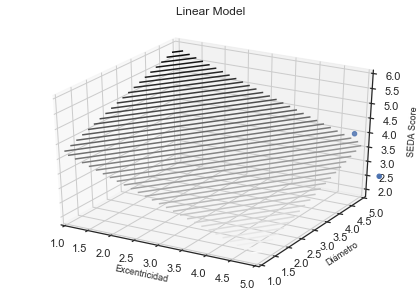




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.851028758114593, p-value: [[0.01915524 0.023092  ]]
Regression Coefficients: [-0.61706801  0.59094288]
Intercept: 2.611104516325944


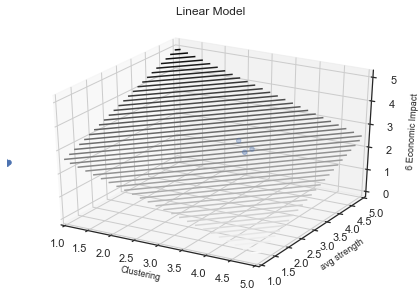




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9018825979514917, p-value: [[0.00338229 0.00248702]]
Regression Coefficients: [-1.20871148  1.58807954]
Intercept: 2.923169593241449


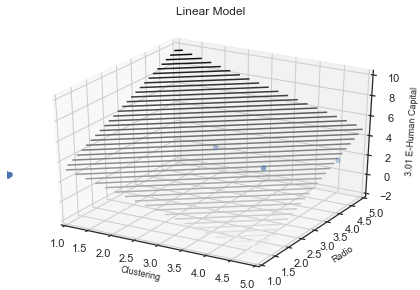




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9653942377688408, p-value: [[0.00135038 0.0022311 ]]
Regression Coefficients: [-0.28137725  0.29790113]
Intercept: 2.622381172664106


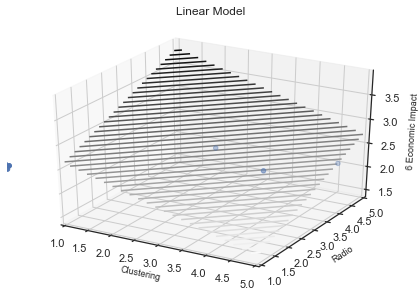




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Transitividad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8861887868917114, p-value: [[0.00474607 0.01294979]]
Regression Coefficients: [ 4.53305046 -2.53871959]
Intercept: 3.1947501636715843


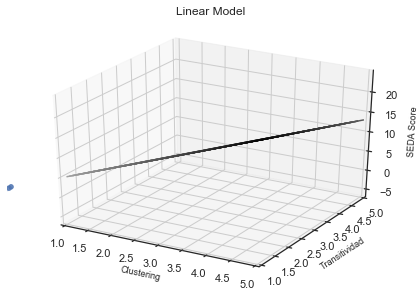




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Central Point Dominance
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9482881488754595, p-value: [[0.00050194 0.00993315]]
Regression Coefficients: [4.86211519 1.51643816]
Intercept: 1.9770476346322146


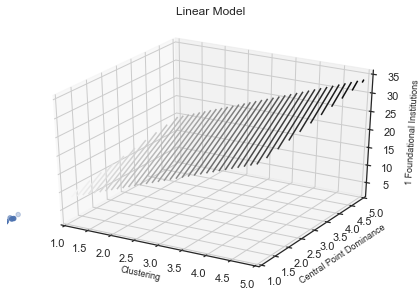




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Colab 4
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9281209962268813, p-value: [[0.00022988 0.04321373]]
Regression Coefficients: [4.24970735 0.75170785]
Intercept: 2.678139023716734


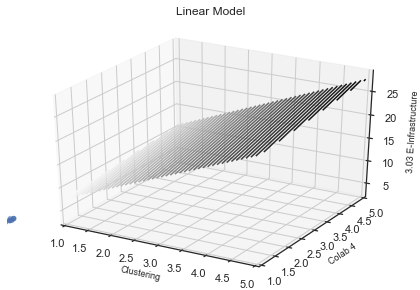




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Clustering, Colab 6
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9175049686125484, p-value: [[0.00021398 0.0070856 ]]
Regression Coefficients: [5.14227932 1.61299691]
Intercept: 2.1334305287273163


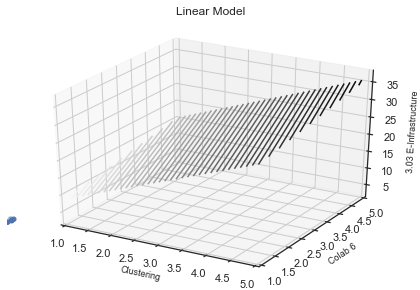




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Diámetro, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8514607219252821, p-value: [[0.00602962 0.00723056]]
Regression Coefficients: [-0.56258462  0.57844615]
Intercept: 3.783451282051283


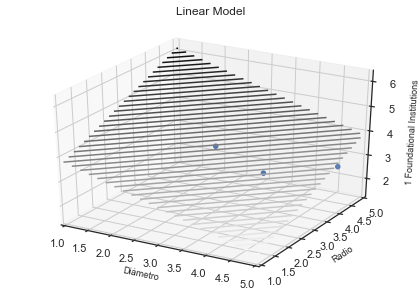




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Excentricidad
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9552835022458922, p-value: [[0.00048469 0.02357938]]
Regression Coefficients: [-0.45057049  0.16451276]
Intercept: 3.7057612010306697


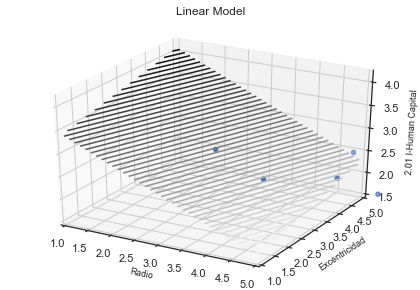




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Clustering
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8440109006262282, p-value: [[0.01167226 0.00772396]]
Regression Coefficients: [-0.94264618  1.2836395 ]
Intercept: 1.378116511923012


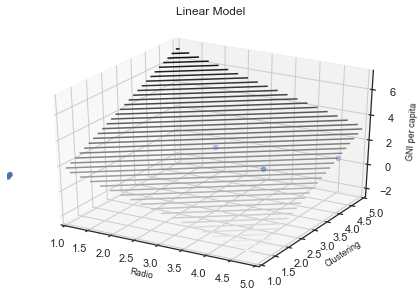




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Diámetro
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.988818355284033, p-value: [[6.02890756e-05 3.75459231e-04]]
Regression Coefficients: [-0.50176617  0.3409073 ]
Intercept: 3.340422153819543


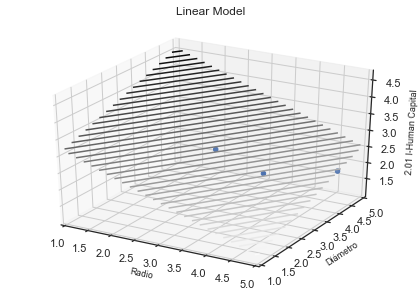




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Diámetro
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8291322451752773, p-value: [[0.00750945 0.02215793]]
Regression Coefficients: [-0.33018505  0.25954901]
Intercept: 3.4108799529474316


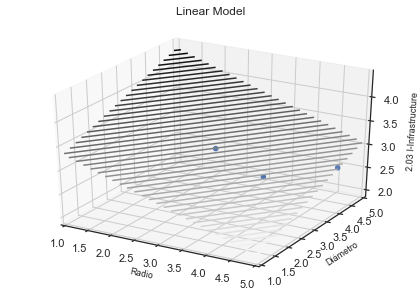




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Transitividad
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8286624290895075, p-value: [[0.01628594 0.01171093]]
Regression Coefficients: [-0.91961787  1.22871676]
Intercept: 1.4687655661059307


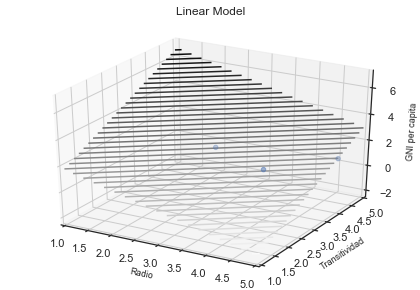




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Eficiencia Global
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8330180419457623, p-value: [[0.01575254 0.01092414]]
Regression Coefficients: [-0.54626547  0.73658663]
Intercept: 3.6960020264300697


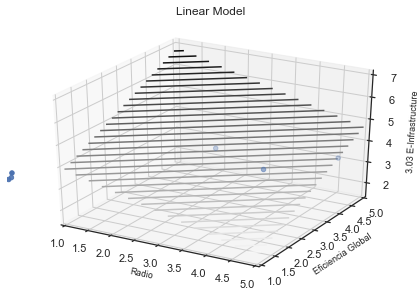




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Eficiencia Global
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9144189003917588, p-value: [[0.00382792 0.00264197]]
Regression Coefficients: [-0.99839227  1.33599142]
Intercept: 1.4297320775914144


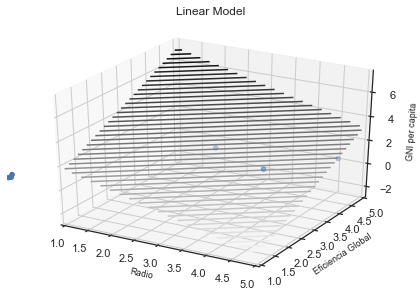




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Core Ratio
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8074726843151164, p-value: [[0.019189   0.01283934]]
Regression Coefficients: [-0.91026308  1.24047634]
Intercept: 1.3891424572118434


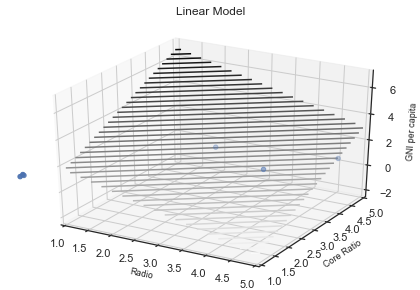




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Central Point Dominance
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8415088815402038, p-value: [[0.00862303 0.00645937]]
Regression Coefficients: [-0.51252747  0.67176086]
Intercept: 2.7471196021738913


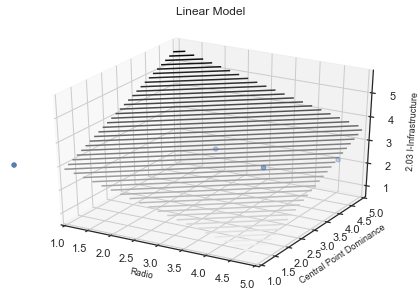




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Central Point Dominance
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9863242967907679, p-value: [[8.68005724e-05 5.27514687e-05]]
Regression Coefficients: [-0.56717089  0.77701588]
Intercept: 3.6446013047719807


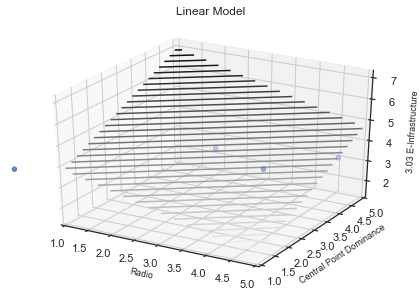




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Central Point Dominance
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9815905646156347, p-value: [[1.50184271e-04 9.30604004e-05]]
Regression Coefficients: [-0.97772509  1.33350137]
Intercept: 1.3510251404658937


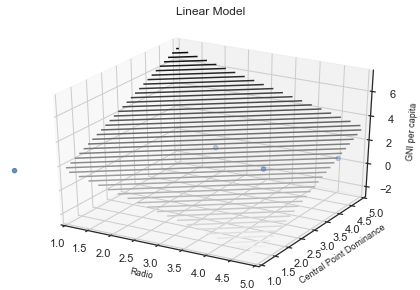




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Central Point Dominance
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9049127922767553, p-value: [[0.00391933 0.00253903]]
Regression Coefficients: [-0.8957962   1.21685086]
Intercept: 3.023768564503598


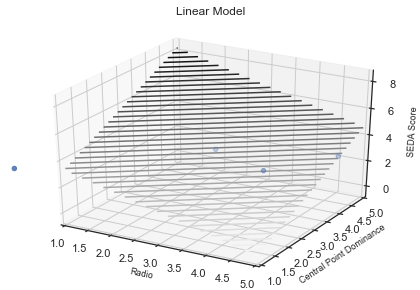




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Spectral radius
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8462544955626001, p-value: [[0.00519255 0.00156082]]
Regression Coefficients: [-0.99243861  1.60155604]
Intercept: 0.473117043169496


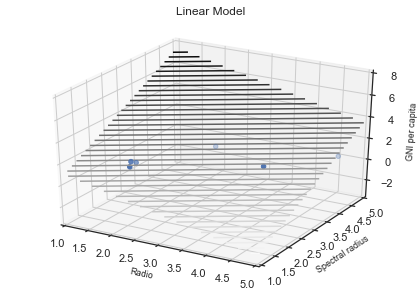




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Spectral radius
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8817146795010417, p-value: [[0.00310522 0.00088949]]
Regression Coefficients: [-0.94613454  1.53741813]
Intercept: 2.1364263234745593


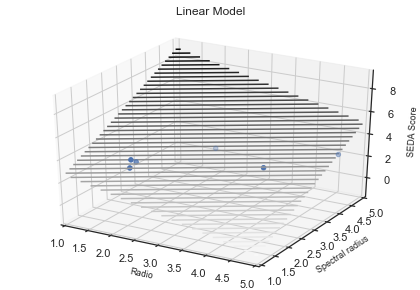




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Modularidad
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9091439700477865, p-value: [[0.00467738 0.00322245]]
Regression Coefficients: [-0.92107729  1.2333934 ]
Intercept: 1.4561257722698617


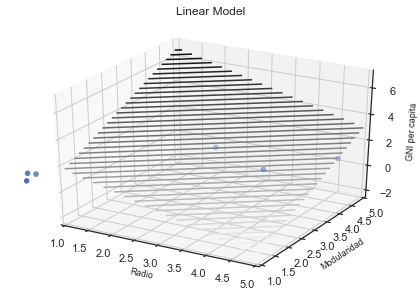




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Modularidad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8143648410084, p-value: [[0.01906228 0.01373502]]
Regression Coefficients: [-0.82925368  1.1069988 ]
Intercept: 3.1219860799207524


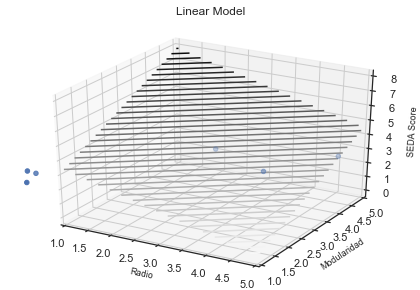




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 0
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9557486872281414, p-value: [[0.00038371 0.00167195]]
Regression Coefficients: [0.18237447 0.10966936]
Intercept: 1.7801558377296045


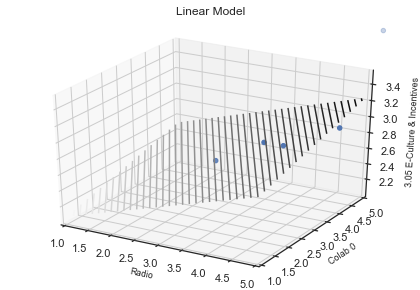




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 3
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8083778588760504, p-value: [[0.01871054 0.01251794]]
Regression Coefficients: [-0.89927078  1.22595978]
Intercept: 1.3937772784732452


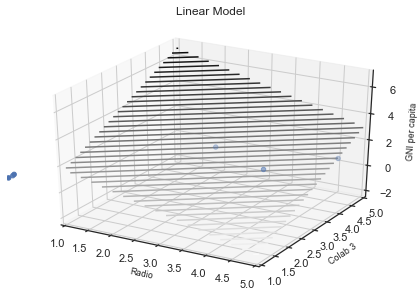




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 5
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8588259591096893, p-value: [[0.00663456 0.00329135]]
Regression Coefficients: [-0.57113302  0.82697874]
Intercept: 3.48978502371254


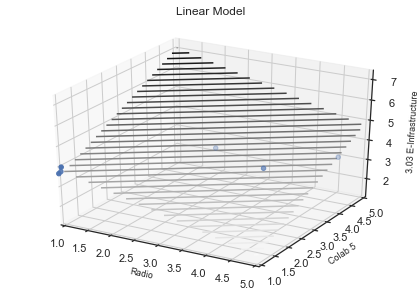




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 5
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9095854361510983, p-value: [[0.00247171 0.00122915]]
Regression Coefficients: [-1.02256326  1.46894424]
Intercept: 1.073394124617144


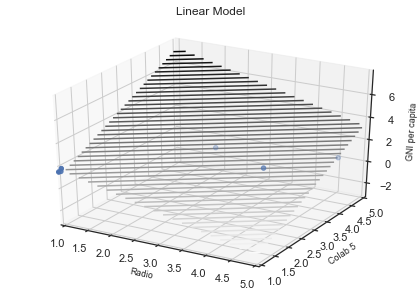




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 6
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8268621271606842, p-value: [[0.01577294 0.0108631 ]]
Regression Coefficients: [-0.91975717  1.24241621]
Intercept: 1.4226650517794917


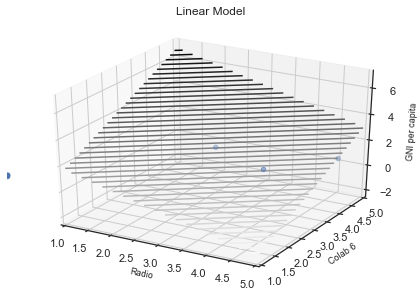




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 7
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8211397636697046, p-value: [[0.01859077 0.013118  ]]
Regression Coefficients: [-0.54086626  0.72704046]
Intercept: 3.706141634969198


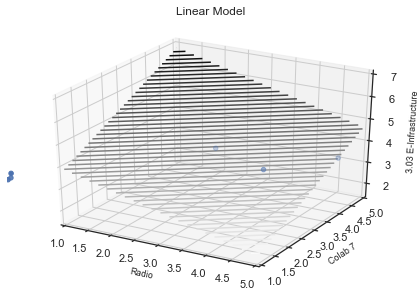




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 7
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9089026038090198, p-value: [[0.0044594  0.00312887]]
Regression Coefficients: [-0.9936631   1.32507855]
Intercept: 1.447339022090311


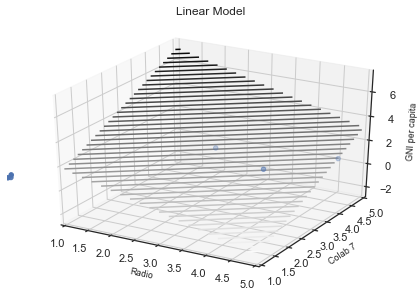




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 8
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.861873240132623, p-value: [[0.01007018 0.0069177 ]]
Regression Coefficients: [-0.95121515  1.2806545 ]
Intercept: 1.4223506665351626


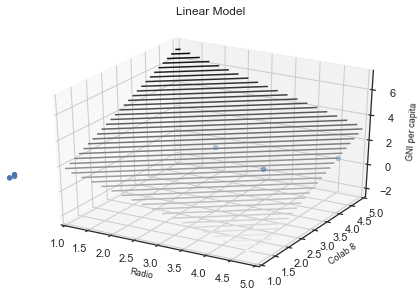




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 9
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8107249648212612, p-value: [[0.02039433 0.01417549]]
Regression Coefficients: [-0.53673768  0.72509313]
Intercept: 3.6956066646719483


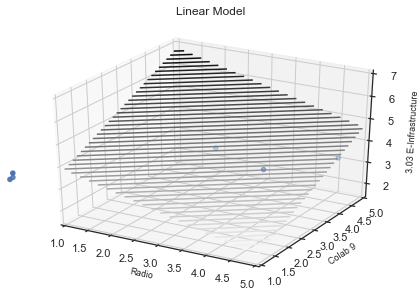




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 9
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8988250068181313, p-value: [[0.00537046 0.00370733]]
Regression Coefficients: [-0.98731571  1.3229564 ]
Intercept: 1.4281426725536985


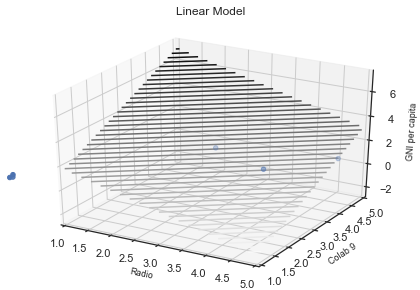




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 10
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8027709710494091, p-value: [[0.0191639  0.01243346]]
Regression Coefficients: [-0.89885484  1.23488215]
Intercept: 1.3609079247253886


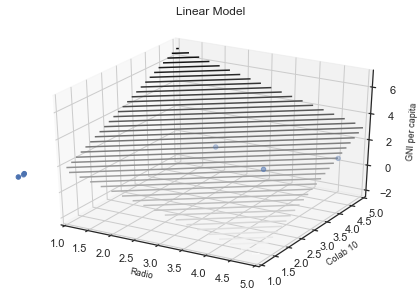




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 11
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8070495716756007, p-value: [[0.02145288 0.01502953]]
Regression Coefficients: [-0.53288704  0.71878768]
Intercept: 3.701145886800078


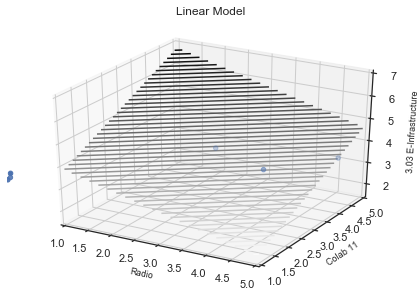




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 11
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8902426881375387, p-value: [[0.00641893 0.00447169]]
Regression Coefficients: [-0.97733867  1.30785487]
Intercept: 1.4383473702890883


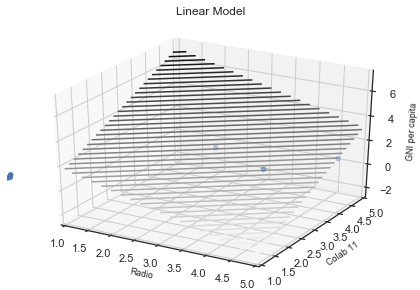




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 12
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8808477481057051, p-value: [[0.00764072 0.00535634]]
Regression Coefficients: [-0.97094602  1.2984478 ]
Intercept: 1.4438297714835706


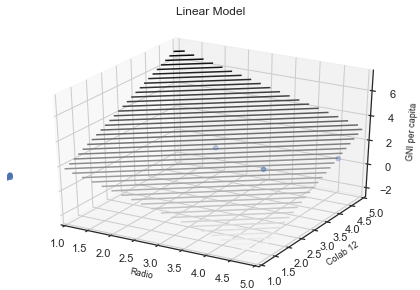




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Radio, Colab 13
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8796907955546349, p-value: [[0.00754837 0.00516502]]
Regression Coefficients: [-0.97251399  1.30818013]
Intercept: 1.4169954095732826


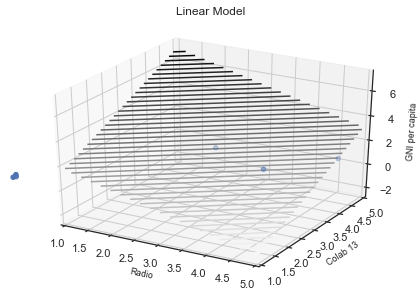




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Degree
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9929843700396194, p-value: [[1.10601375e-07 7.55085095e-05]]
Regression Coefficients: [0.74981485 0.12151153]
Intercept: -0.30985369408605967


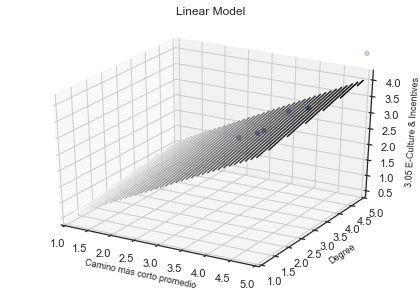




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8886553157441937, p-value: [[0.00329089 0.04102014]]
Regression Coefficients: [-0.56084086  0.29608198]
Intercept: 4.709410003698658


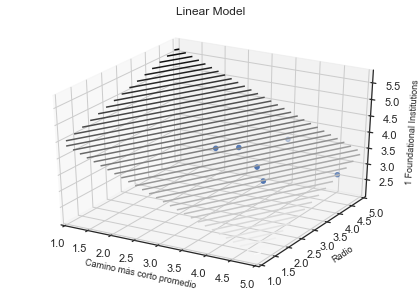




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Radio
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9334344111404429, p-value: [[0.01766529 0.00090502]]
Regression Coefficients: [ 0.20583443 -0.52089043]
Intercept: 4.2319858226976095


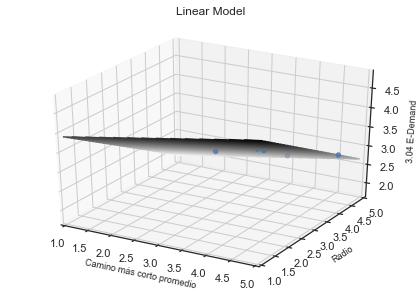




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Radio
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8173048871753296, p-value: [[0.01220399 0.01566114]]
Regression Coefficients: [-0.34881808  0.36103258]
Intercept: 4.247001293835427


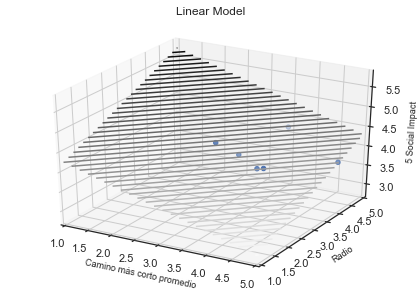




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Central Point Dominance
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8034539486085243, p-value: [[0.02378449 0.0164687 ]]
Regression Coefficients: [ 0.48546972 -0.55274022]
Intercept: 3.356315504495808


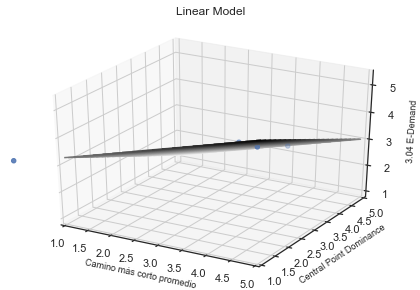




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Spectral radius
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8447546827077091, p-value: [[0.02001709 0.01093729]]
Regression Coefficients: [ 0.47034452 -0.57304747]
Intercept: 3.477827054845432


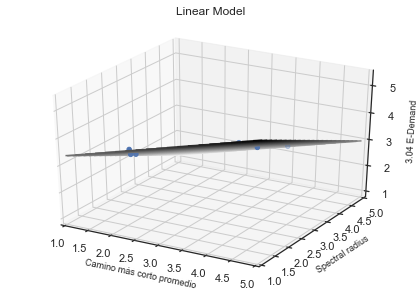




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Modularidad
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8643690216319689, p-value: [[0.01012764 0.00806779]]
Regression Coefficients: [ 0.52218429 -0.56930876]
Intercept: 3.279895063860278


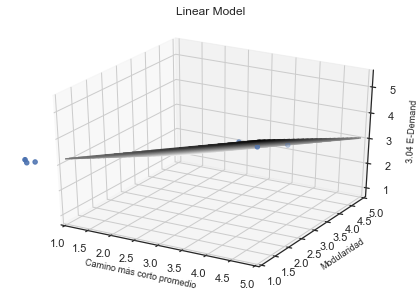




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Camino más corto promedio, Colab 0
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9098637174901159, p-value: [[0.00160423 0.0074312 ]]
Regression Coefficients: [0.199063   0.10892742]
Intercept: 1.7351791240245178


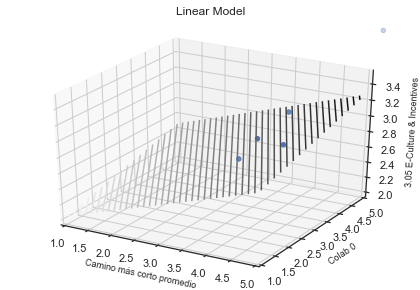




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8533078335657083, p-value: [[0.02091479 0.02568218]]
Regression Coefficients: [-0.61301422  0.58402513]
Intercept: 2.620167629043861


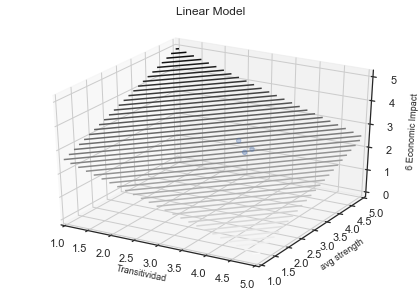




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Clustering
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8310085812883075, p-value: [[0.04067761 0.0062516 ]]
Regression Coefficients: [ 2.90018363 -3.81123022]
Intercept: 3.754995544144357


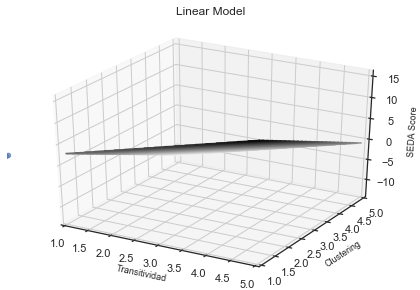




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9032225472935209, p-value: [[0.00382767 0.00303691]]
Regression Coefficients: [-1.19250856  1.53864591]
Intercept: 3.02469048251981


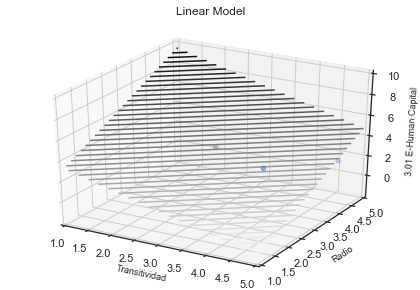




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9672952730860082, p-value: [[0.00137041 0.00237043]]
Regression Coefficients: [-0.2799439   0.29333214]
Intercept: 2.631933134532931


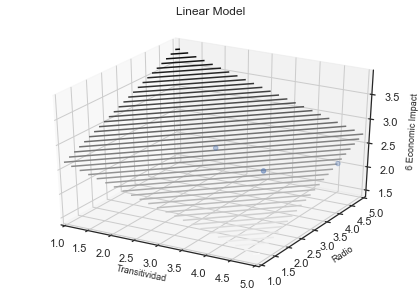




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Core Ratio
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8137884038029735, p-value: [[0.03660593 0.01023895]]
Regression Coefficients: [ 2.53887829 -3.46411367]
Intercept: 3.732485363861736


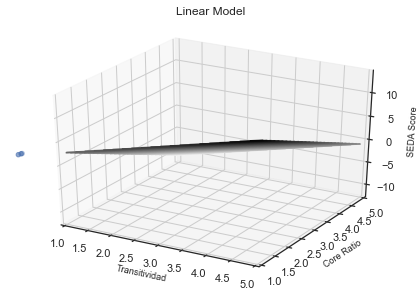




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Transitividad, Colab 13
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8002741016781669, p-value: [[0.04674289 0.01023571]]
Regression Coefficients: [ 2.89532403 -4.23544044]
Intercept: 3.8017033311163893


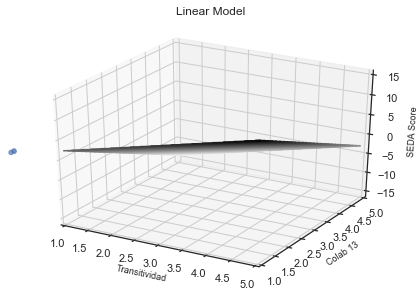




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8722458070927165, p-value: [[0.00853279 0.00739883]]
Regression Coefficients: [-2.71966188  2.87695114]
Intercept: 3.0196081230455496


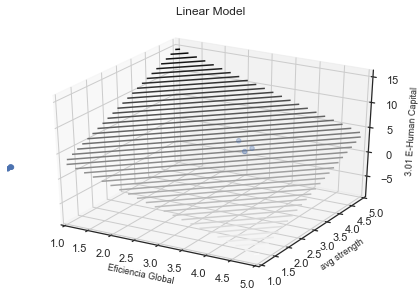




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9265768462676629, p-value: [[0.00541933 0.00686649]]
Regression Coefficients: [-0.71868975  0.68341382]
Intercept: 2.6473766144166566


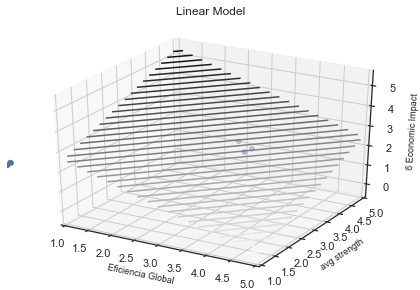




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Clustering
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9149702652575257, p-value: [[0.00055908 0.00397621]]
Regression Coefficients: [6.95062682 3.55886134]
Intercept: -0.7833374865656588


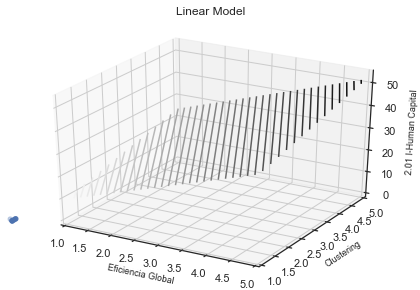




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Clustering
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9496720781956665, p-value: [[1.44746273e-03 3.94215852e-05]]
Regression Coefficients: [2.50792666 5.42893463]
Intercept: 0.4412532171068966


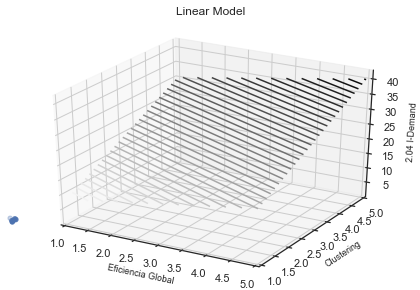




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8151329336259958, p-value: [[0.03020639 0.04349174]]
Regression Coefficients: [-0.71808041  0.7698371 ]
Intercept: 3.719443333573105


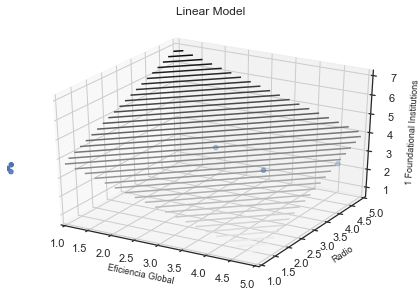




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.947529421965688, p-value: [[0.00108127 0.00083705]]
Regression Coefficients: [-1.25097785  1.61878691]
Intercept: 2.9929927082892975


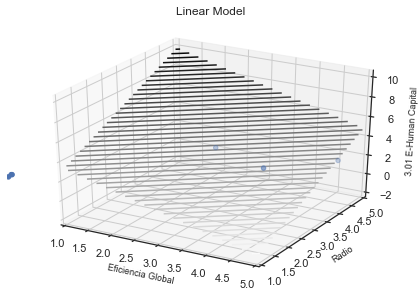




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9821889882778212, p-value: [[0.0004004  0.00070325]]
Regression Coefficients: [-0.28926993  0.30276525]
Intercept: 2.6385337317429407


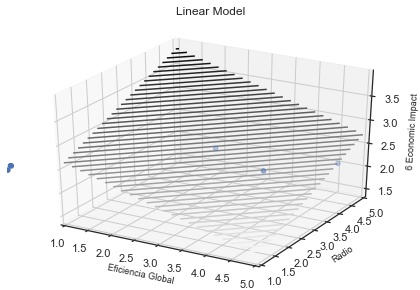




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9206046571621571, p-value: [[0.01587234 0.00228674]]
Regression Coefficients: [-2.83110581  3.80537119]
Intercept: 2.780159075146592


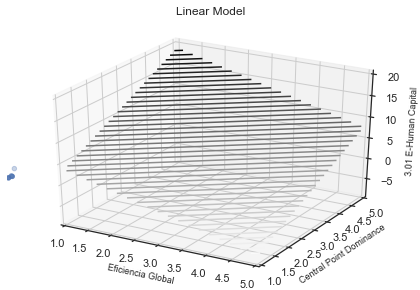




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.991658074174167, p-value: [[2.07722874e-05 4.13343902e-04]]
Regression Coefficients: [1.61893969 0.59183239]
Intercept: 1.9640137230279784


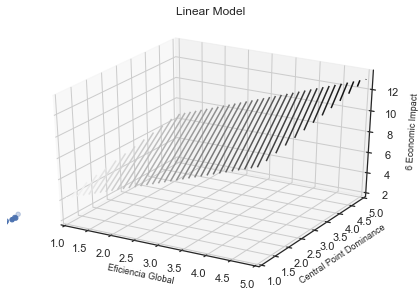




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8434454335582249, p-value: [[0.00069399 0.0072479 ]]
Regression Coefficients: [5.32393759 2.48551966]
Intercept: 0.32245590034261307


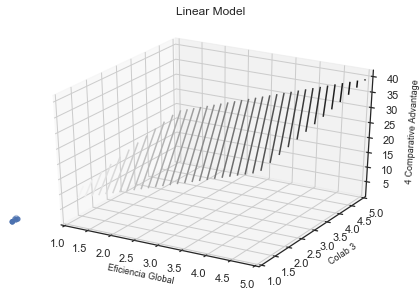




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 6
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8909986406952146, p-value: [[0.00283943 0.01066512]]
Regression Coefficients: [3.80261855 2.31544251]
Intercept: 0.3836736921092192


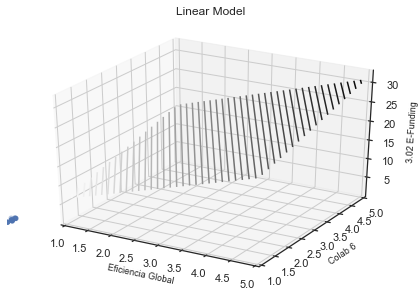




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 7
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8182736855563885, p-value: [[0.02962621 0.01828435]]
Regression Coefficients: [3.38460002 3.74303867]
Intercept: 0.6917389443247837


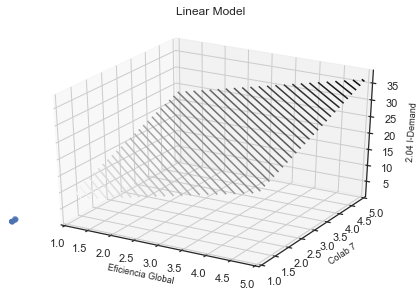




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 7
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.821633079686981, p-value: [[0.00339079 0.03872847]]
Regression Coefficients: [7.75873368 3.59224026]
Intercept: -1.3577781177327686


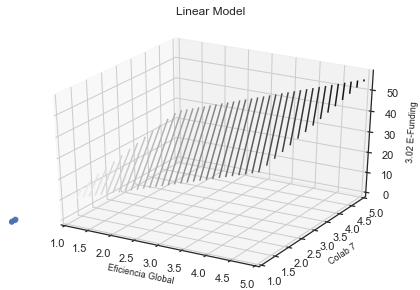




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 11
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8124719335868471, p-value: [[0.01026362 0.01260518]]
Regression Coefficients: [4.04912565 3.56062929]
Intercept: 0.567597369890871


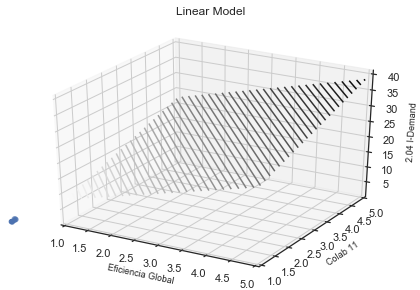




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 11
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9299196267324127, p-value: [[0.00023542 0.00369908]]
Regression Coefficients: [8.33473481 3.78391714]
Intercept: -1.5520454824008527


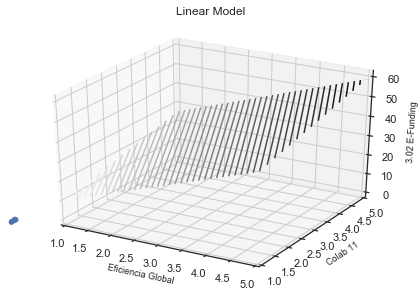




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Eficiencia Global, Colab 12
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9585798282302137, p-value: [[6.92329160e-05 2.09948872e-03]]
Regression Coefficients: [8.72028647 3.38989916]
Intercept: -1.5175699304892567


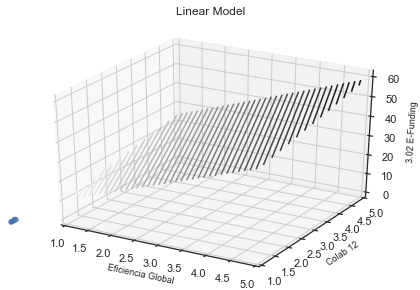




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Clustering
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9203718035109557, p-value: [[0.00271315 0.0067652 ]]
Regression Coefficients: [ 1.91694546 -1.16648837]
Intercept: 3.137455964370044


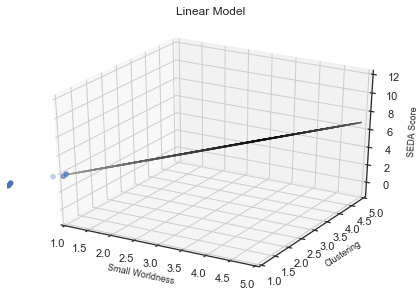




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.86889760207972, p-value: [[0.00953361 0.01319962]]
Regression Coefficients: [-0.2195868  0.2352027]
Intercept: 2.57989113646756


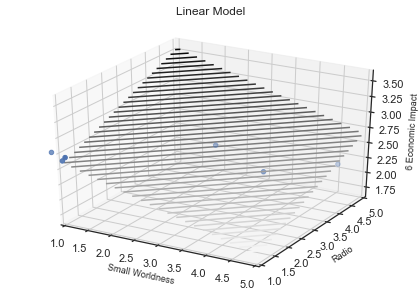




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Transitividad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9051672714073853, p-value: [[0.00396793 0.00705994]]
Regression Coefficients: [ 1.88814178 -1.25338376]
Intercept: 3.2557614242778783


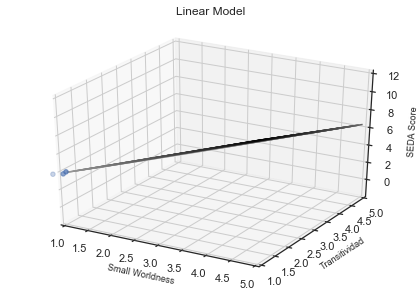




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Eficiencia Global
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8265260032867459, p-value: [[0.01125924 0.03982464]]
Regression Coefficients: [ 1.92160743 -1.03170681]
Intercept: 2.9846099269097097


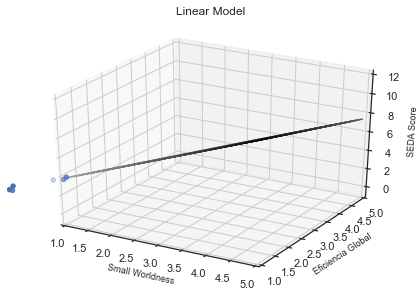




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Rich Club Coefficient
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9161155991085205, p-value: [[0.00053766 0.00079226]]
Regression Coefficients: [1.13844082 0.87445661]
Intercept: 1.8667902415700595


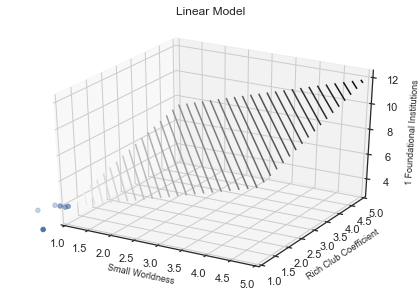




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Rich Club Coefficient
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.848655087833599, p-value: [[0.00315003 0.00207522]]
Regression Coefficients: [0.37568408 0.35684731]
Intercept: 1.940592927714642


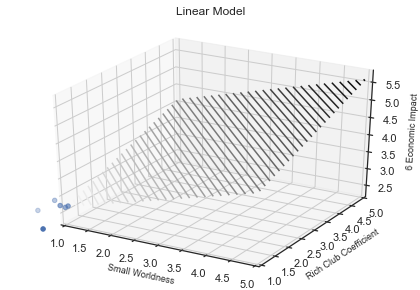




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Core Ratio
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9219147976593216, p-value: [[0.00153742 0.01285134]]
Regression Coefficients: [ 2.05788836 -0.92829874]
Intercept: 2.748747229035869


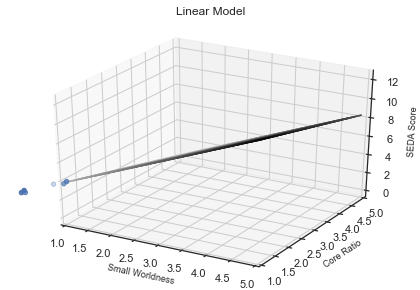




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 2
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8242080808074678, p-value: [[0.01297607 0.02222861]]
Regression Coefficients: [ 1.25809909 -0.81428999]
Intercept: 3.333292786027532


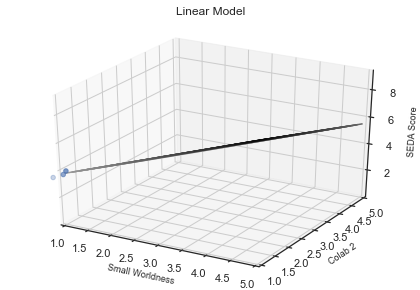




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 3
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9108440337060979, p-value: [[0.00305316 0.0102357 ]]
Regression Coefficients: [ 1.90980734 -1.07291015]
Intercept: 3.042459398460617


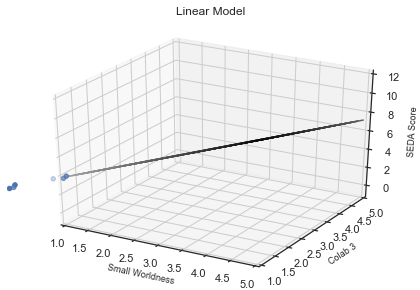




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 4
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9155410716753858, p-value: [[0.00296255 0.0071025 ]]
Regression Coefficients: [ 1.87040754 -1.14630675]
Intercept: 3.1558744267330883


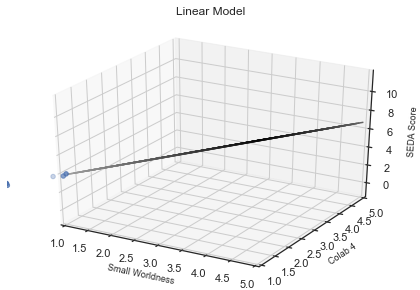




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 6
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9090744737182125, p-value: [[0.00337883 0.00894321]]
Regression Coefficients: [ 1.92238145 -1.14964638]
Intercept: 3.113607559116124


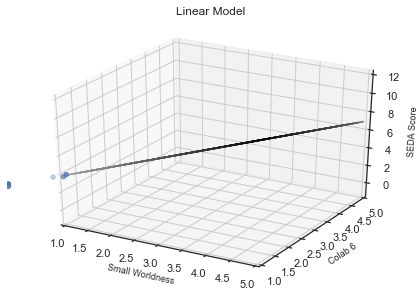




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 7
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8349769852245612, p-value: [[0.00976195 0.03582957]]
Regression Coefficients: [ 1.93779296 -1.03645181]
Intercept: 2.9749660380830036


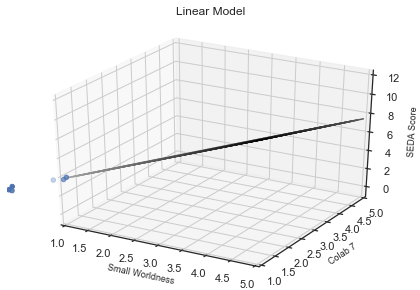




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 8
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8748046698004421, p-value: [[0.00536973 0.02194814]]
Regression Coefficients: [ 1.96384338 -1.03758534]
Intercept: 2.9542350119543674


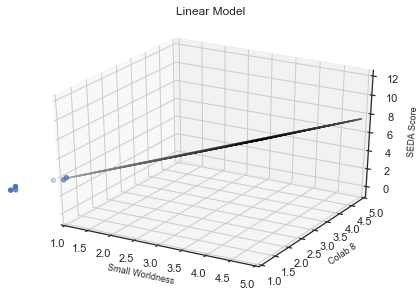




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 9
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8460493135005765, p-value: [[0.00841172 0.03223076]]
Regression Coefficients: [ 1.95234272 -1.03643964]
Intercept: 2.961971363592638


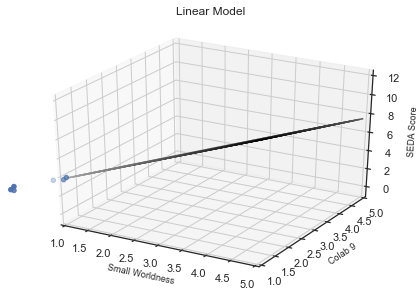




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 10
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9188229572769921, p-value: [[0.00191657 0.01345514]]
Regression Coefficients: [ 2.00465843 -0.93564687]
Intercept: 2.8081715103547955


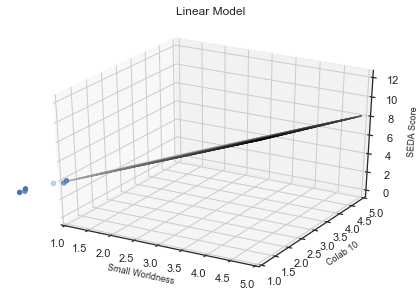




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 11
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8536926206056503, p-value: [[0.00793211 0.02746122]]
Regression Coefficients: [ 1.93933817 -1.06199436]
Intercept: 3.0020184799460456


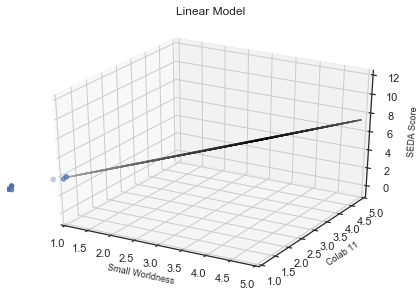




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 12
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8660799748949599, p-value: [[0.00653436 0.02260878]]
Regression Coefficients: [ 1.95766843 -1.07939617]
Intercept: 3.0041254367742267


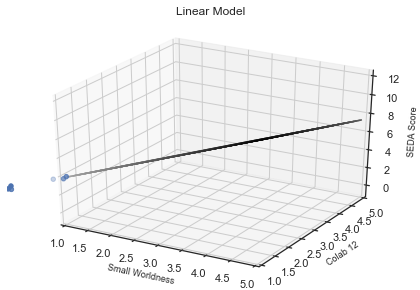




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 13
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.865432660254652, p-value: [[0.00582365 0.02735157]]
Regression Coefficients: [ 1.98650186 -1.00827987]
Intercept: 2.900612616213696


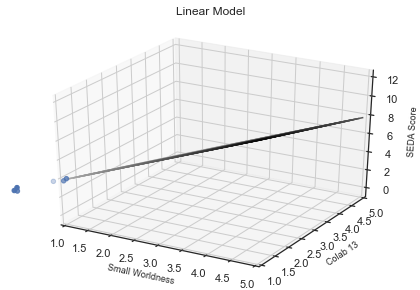




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Small Worldness, Colab 14
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8886951842171049, p-value: [[0.00366456 0.02263878]]
Regression Coefficients: [ 1.90197231 -0.90347234]
Intercept: 2.863930744258306


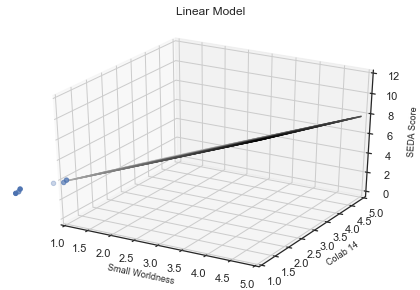




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, avg strength
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8063101608412179, p-value: [[0.01460569 0.01722878]]
Regression Coefficients: [-0.38991392  0.37601478]
Intercept: 2.9283727638458923


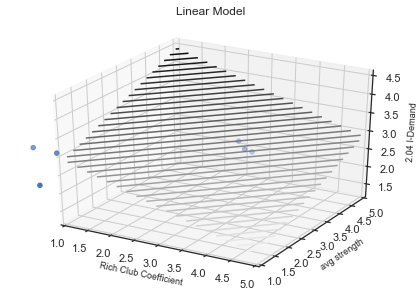




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Clustering
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8544591323870631, p-value: [[0.01046281 0.01040439]]
Regression Coefficients: [-0.55291102  0.51834137]
Intercept: 3.226301888311767


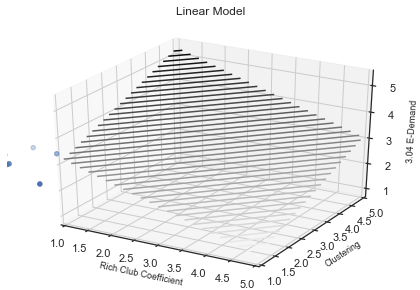




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Transitividad
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8184536708877214, p-value: [[0.04998863 0.00990669]]
Regression Coefficients: [-0.29009083  0.4572914 ]
Intercept: 2.80794883575433


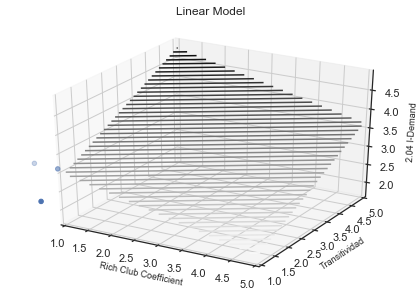




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Transitividad
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.856032335444891, p-value: [[0.00984205 0.01117999]]
Regression Coefficients: [-0.56053764  0.51220549]
Intercept: 3.234701988890983


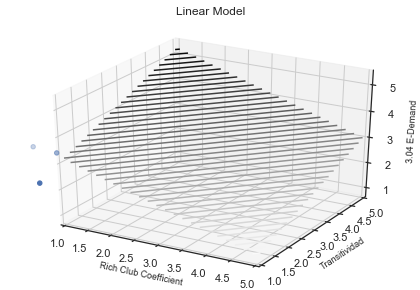




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Eficiencia Global
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8597855131751402, p-value: [[0.04928963 0.00476886]]
Regression Coefficients: [-0.2556105   0.49619154]
Intercept: 2.7587805840424


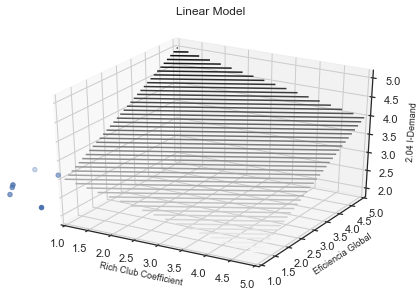




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Eficiencia Global
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.803236241471174, p-value: [[0.01622769 0.02191967]]
Regression Coefficients: [-0.56438058  0.49175904]
Intercept: 3.262183666711855


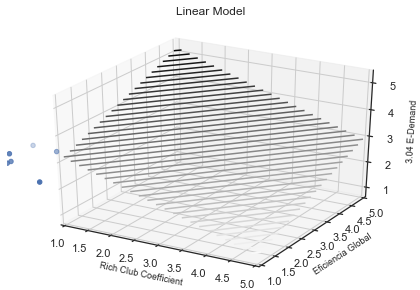




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Small Worldness
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9352021171221567, p-value: [[0.00612598 0.0009026 ]]
Regression Coefficients: [-0.40059983  0.56867274]
Intercept: 3.022156466592791


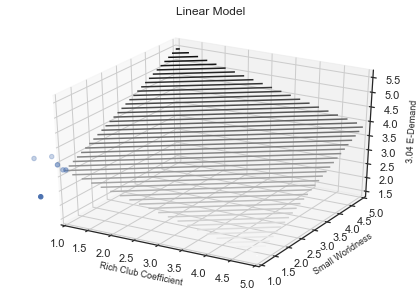




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Core Ratio
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8383993640314127, p-value: [[0.01341857 0.01168727]]
Regression Coefficients: [-0.53208714  0.52978953]
Intercept: 3.224843920098972


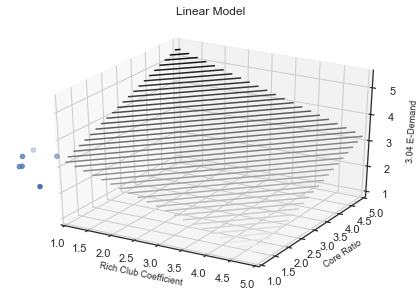




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Central Point Dominance
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8898718933956723, p-value: [[0.04097497 0.00257539]]
Regression Coefficients: [-0.24119116  0.49734668]
Intercept: 2.741771648922749


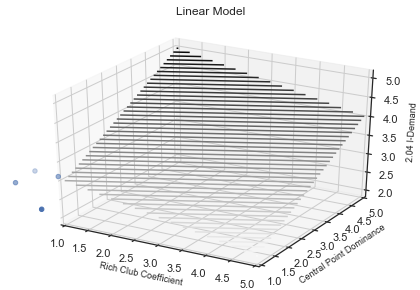




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Modularidad
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8357477938341096, p-value: [[0.00258065 0.0031137 ]]
Regression Coefficients: [-0.96537551 -0.91575386]
Intercept: 4.279514839523605


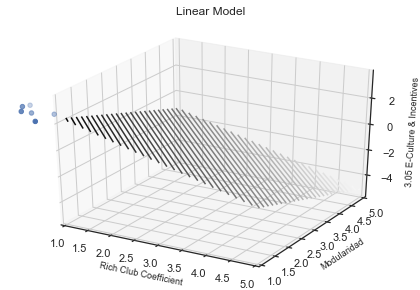




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Modularidad
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8065163366760616, p-value: [[0.00137213 0.01076879]]
Regression Coefficients: [1.51333758 0.85865354]
Intercept: 0.1754826229933546


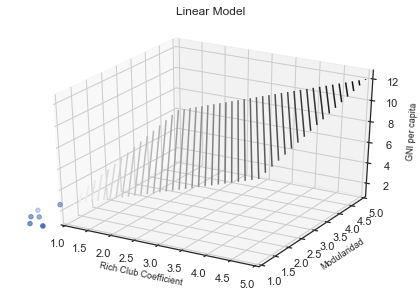




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 1
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9735296808669662, p-value: [[1.14780119e-02 9.17141571e-05]]
Regression Coefficients: [-0.21966273  0.72719629]
Intercept: 2.787115756344987


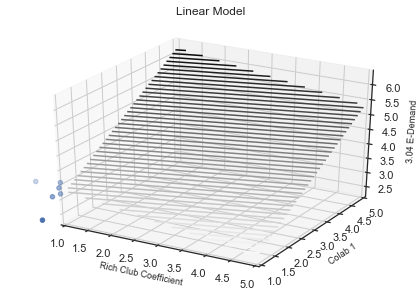




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 2
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9309746713095103, p-value: [[0.00289483 0.00214857]]
Regression Coefficients: [-0.50187371  0.49538181]
Intercept: 3.1962248051202273


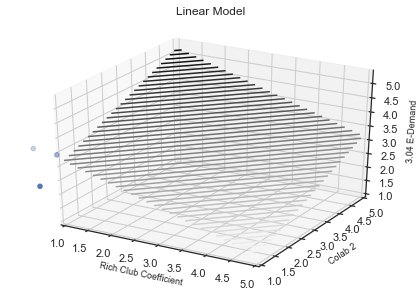




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 3
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8682684843184978, p-value: [[0.00867237 0.0082773 ]]
Regression Coefficients: [-0.55176213  0.52428717]
Intercept: 3.2280074869758404


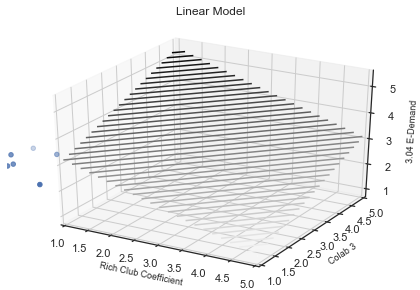




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 4
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8766421416456257, p-value: [[0.0075919  0.00752238]]
Regression Coefficients: [-0.55535857  0.52207478]
Intercept: 3.2285043288767024


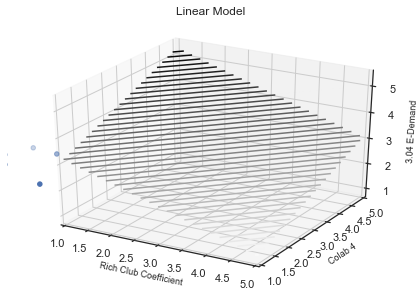




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 6
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8563824923262234, p-value: [[0.0098178  0.01057437]]
Regression Coefficients: [-0.55887682  0.51554541]
Intercept: 3.236859475182489


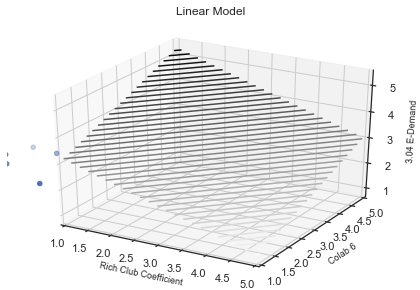




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 7
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8014354531265173, p-value: [[0.01588989 0.02313476]]
Regression Coefficients: [-0.5696472   0.48710865]
Intercept: 3.2698614887790285


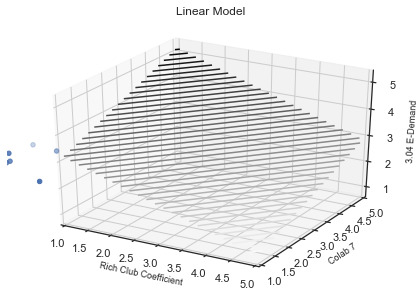




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 8
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8329157732141306, p-value: [[0.01229399 0.01480698]]
Regression Coefficients: [-0.56211225  0.5067131 ]
Intercept: 3.25274869227476


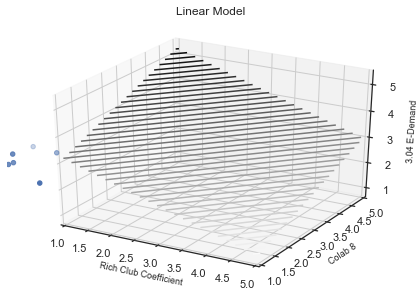




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 9
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.808508753044411, p-value: [[0.0154465  0.02046637]]
Regression Coefficients: [-0.5640638  0.4951105]
Intercept: 3.2612176475286314


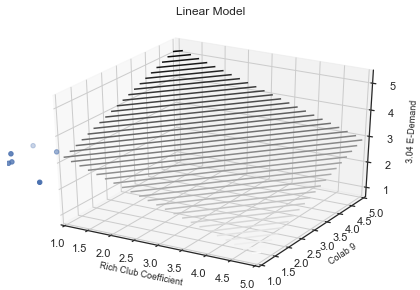




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 10
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8630899055946175, p-value: [[0.01087841 0.00760349]]
Regression Coefficients: [-0.52259145  0.54565687]
Intercept: 3.202759562897749


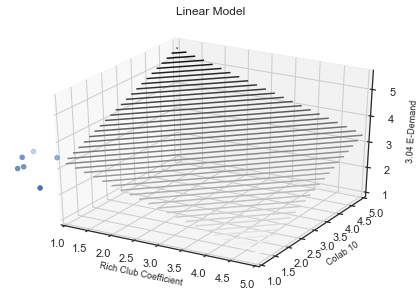




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 11
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8185234892805647, p-value: [[0.0137521  0.01875417]]
Regression Coefficients: [-0.5689838   0.49496998]
Intercept: 3.262432948405667


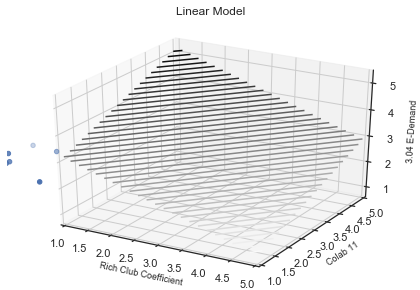




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 12
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8183000973391432, p-value: [[0.01378175 0.01881455]]
Regression Coefficients: [-0.5688693   0.49513456]
Intercept: 3.262736798124692


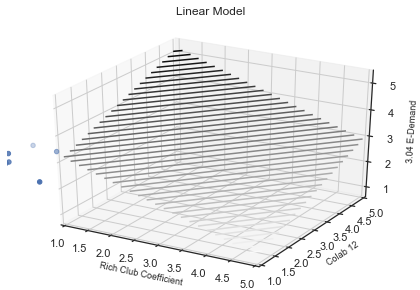




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 13
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8158648918424135, p-value: [[0.01451605 0.01826933]]
Regression Coefficients: [-0.56116389  0.50117661]
Intercept: 3.2579481402104236


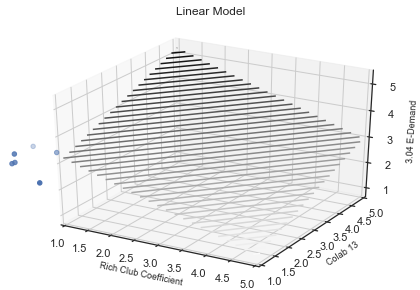




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Rich Club Coefficient, Colab 14
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8637792483906169, p-value: [[0.00780555 0.01000064]]
Regression Coefficients: [-0.56931475  0.50634512]
Intercept: 3.2596813748818154


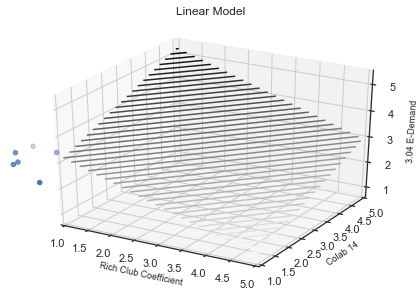




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.827570245959292, p-value: [[0.03189415 0.04123274]]
Regression Coefficients: [-0.59309174  0.55284391]
Intercept: 2.656829095183629


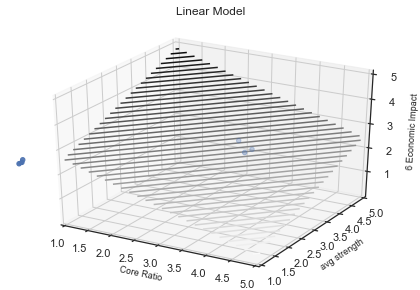




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Clustering
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.893745378550338, p-value: [[0.00453998 0.00394466]]
Regression Coefficients: [ 3.59626271 -3.35918313]
Intercept: 3.4350354830263754


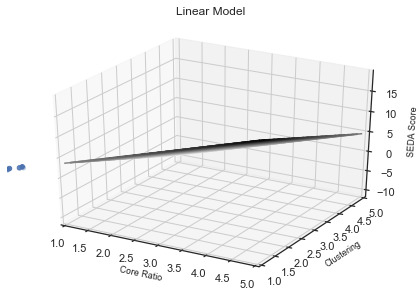




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8802280025591317, p-value: [[0.00544286 0.00404981]]
Regression Coefficients: [-1.18185561  1.54882376]
Intercept: 2.9436205697859474


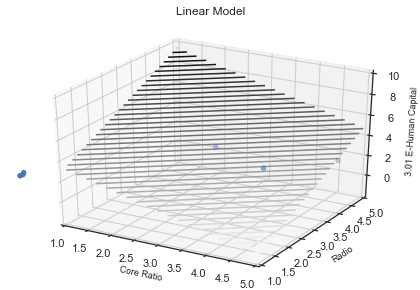




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9565422063161055, p-value: [[0.00232148 0.00406906]]
Regression Coefficients: [-0.27539416  0.28587679]
Intercept: 2.638543013322971


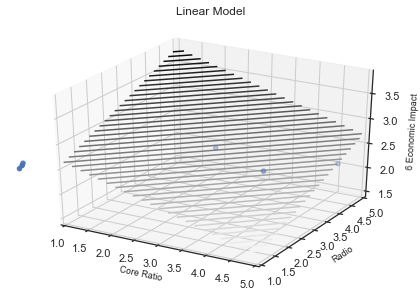




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Transitividad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8712453837601446, p-value: [[0.0064734 0.0072793]]
Regression Coefficients: [ 3.56033374 -3.17514571]
Intercept: 3.373107765666164


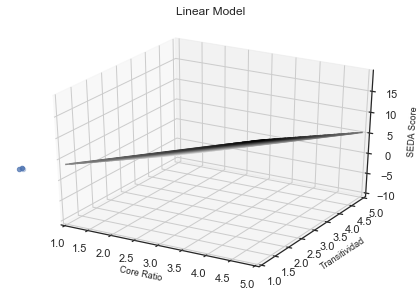




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Eficiencia Global
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8457684591731938, p-value: [[0.00562939 0.03984497]]
Regression Coefficients: [ 5.6580404  -2.96469101]
Intercept: 0.7645222592917433


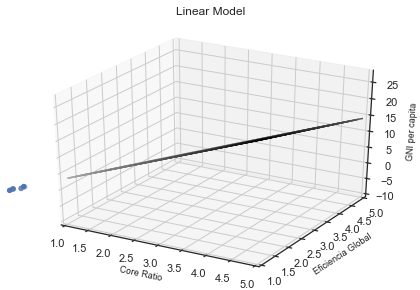




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Eficiencia Global
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.892054195336415, p-value: [[0.00268876 0.01039164]]
Regression Coefficients: [ 5.46954346 -3.55218283]
Intercept: 2.7017478038775318


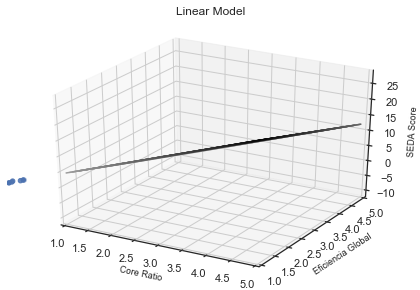




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 6
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8557837251616732, p-value: [[0.00726951 0.01274839]]
Regression Coefficients: [ 3.71225181 -2.88300518]
Intercept: 3.174607367487895


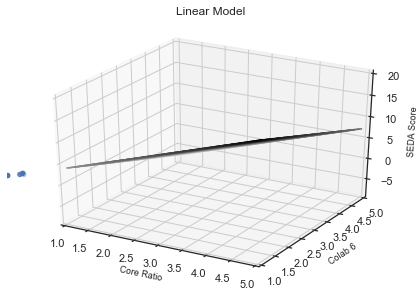




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 7
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8644725739542972, p-value: [[0.00393818 0.03086893]]
Regression Coefficients: [ 5.82667672 -3.0421763 ]
Intercept: 0.7210607880575703


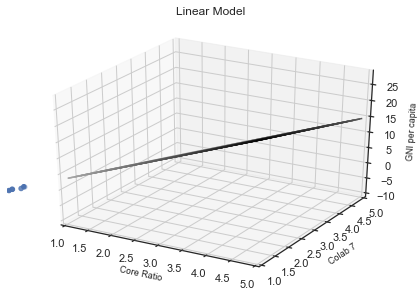




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 7
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9279365454710387, p-value: [[0.00104912 0.00471785]]
Regression Coefficients: [ 5.70859586 -3.64715532]
Intercept: 2.633863932590196


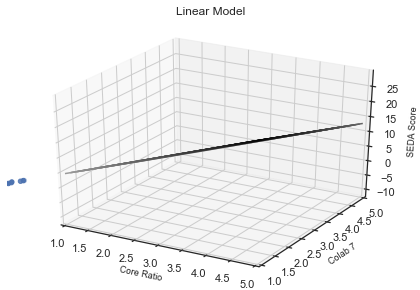




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 8
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9064794524984857, p-value: [[0.00137809 0.00980313]]
Regression Coefficients: [ 5.22323201 -2.87080842]
Intercept: 2.4985777034366015


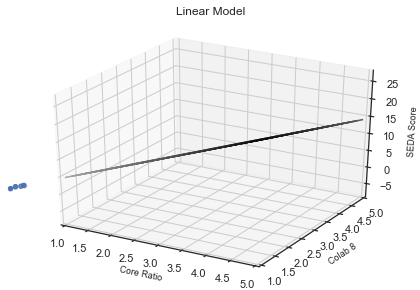




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 9
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8639952431824248, p-value: [[0.00360078 0.03545805]]
Regression Coefficients: [ 5.87845654 -2.83979942]
Intercept: 0.6046589001228195


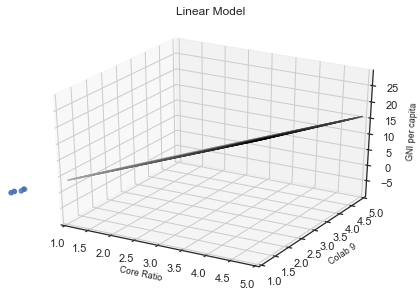




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 9
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9402633792843018, p-value: [[0.00069325 0.00338289]]
Regression Coefficients: [ 5.68996469 -3.54630332]
Intercept: 2.595803002671187


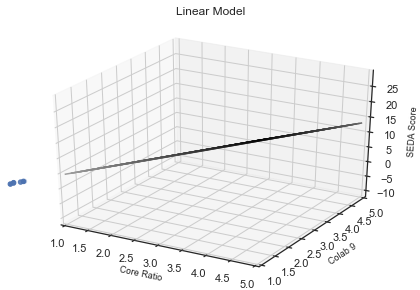




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 11
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9035850557544005, p-value: [[0.00222761 0.0080017 ]]
Regression Coefficients: [ 5.09732891 -3.38950844]
Intercept: 2.7891810086697086


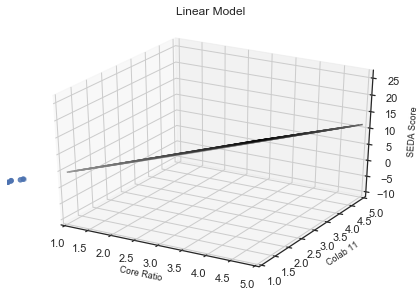




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 12
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.828314694569695, p-value: [[0.00740022 0.04548888]]
Regression Coefficients: [ 5.18014975 -2.80396731]
Intercept: 0.8981918974964089


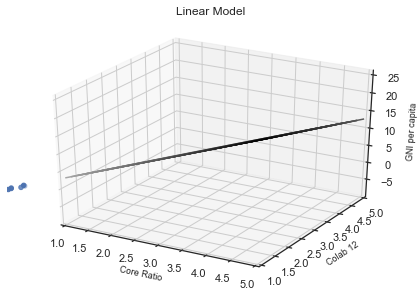




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 12
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9452063350998444, p-value: [[0.00069853 0.00248954]]
Regression Coefficients: [ 5.20711168 -3.52721341]
Intercept: 2.8009903068141764


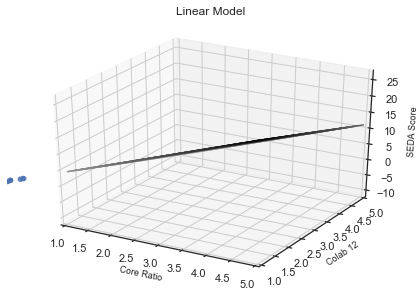




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 13
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9654538032064418, p-value: [[0.00013755 0.00164414]]
Regression Coefficients: [ 6.23509491 -3.1240488 ]
Intercept: 2.147764909761582


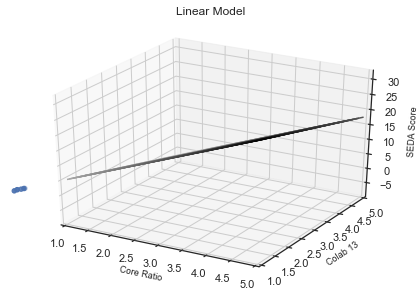




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 14
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8260138461118414, p-value: [[0.00267832 0.01102374]]
Regression Coefficients: [3.11112131 1.98533098]
Intercept: -0.059088033445820365


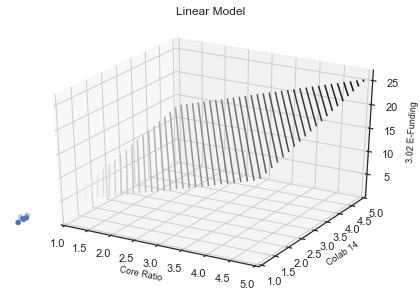




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Core Ratio, Colab 14
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.825598828794357, p-value: [[0.00122698 0.04187882]]
Regression Coefficients: [2.07331634 0.70937428]
Intercept: 1.3929209720503497


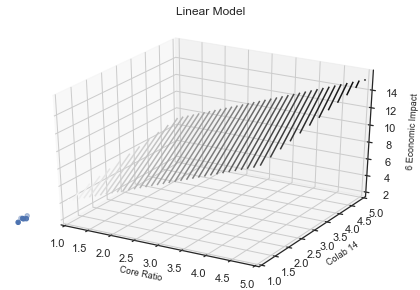




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, avg strength
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8660552337427729, p-value: [[0.0088451  0.00978917]]
Regression Coefficients: [-1.62636672  1.60053348]
Intercept: 3.591163500075986


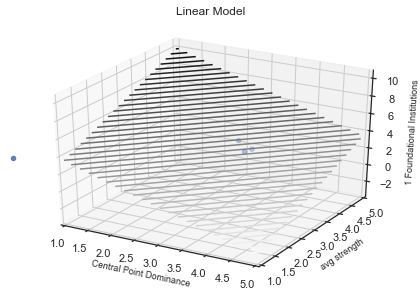




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, avg strength
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9237335102399358, p-value: [[0.00341678 0.00396549]]
Regression Coefficients: [-1.56300591  1.52068006]
Intercept: 2.326693809658788


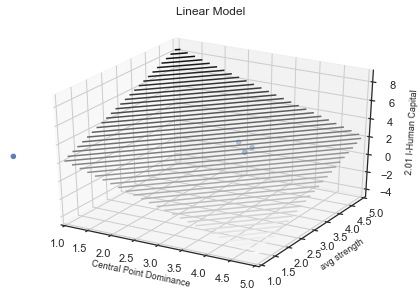




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, avg strength
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9164425777911092, p-value: [[0.00209334 0.00199809]]
Regression Coefficients: [-1.11087901  1.13955152]
Intercept: 2.814186455767382


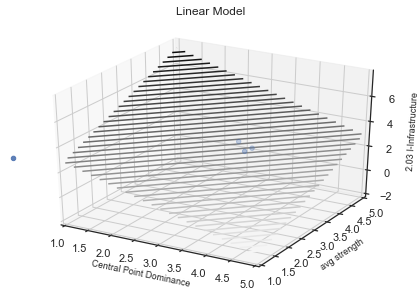




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9587513272371371, p-value: [[0.00105615 0.00142712]]
Regression Coefficients: [-0.79379292  0.88599036]
Intercept: 3.637723429072347


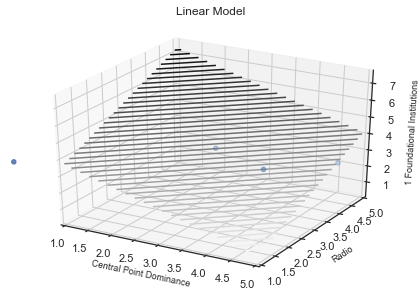




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Radio
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8118999761320183, p-value: [[0.01274152 0.01294387]]
Regression Coefficients: [-0.49866741  0.59955396]
Intercept: 2.8495972745976745


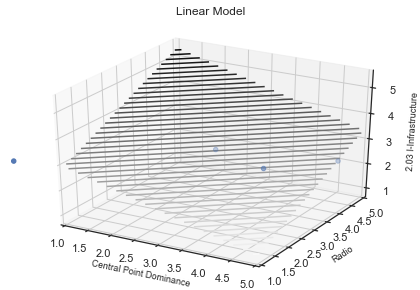




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8617391603792572, p-value: [[0.00679813 0.00492423]]
Regression Coefficients: [-1.12204936  1.48263169]
Intercept: 2.919725128088068


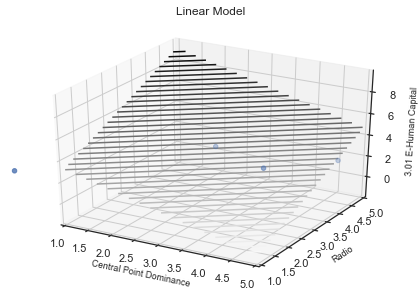




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9539506104187011, p-value: [[0.00229522 0.0038076 ]]
Regression Coefficients: [-0.26735384  0.28171414]
Intercept: 2.618895903086298


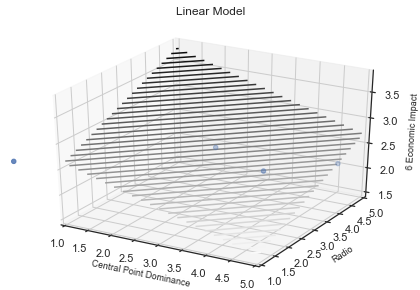




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Eficiencia Global
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.807229127771279, p-value: [[0.02674951 0.0143505 ]]
Regression Coefficients: [-3.28656792  3.10596279]
Intercept: 1.5832521147105914


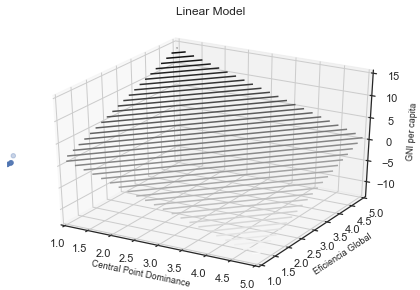




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Spectral radius
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8425102175506703, p-value: [[0.00859558 0.00871386]]
Regression Coefficients: [-2.62516136  2.60687611]
Intercept: 1.6310578714078556


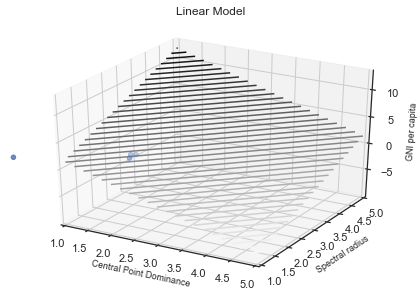




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 5
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8111520362033622, p-value: [[0.01327664 0.01310511]]
Regression Coefficients: [-1.85789001  1.70512386]
Intercept: 3.822435323339687


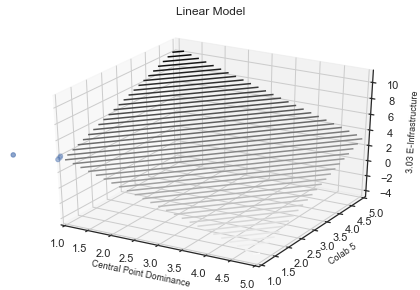




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 5
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8292888896573323, p-value: [[0.01071893 0.01052304]]
Regression Coefficients: [-3.21101229  2.95143298]
Intercept: 1.6436199569775263


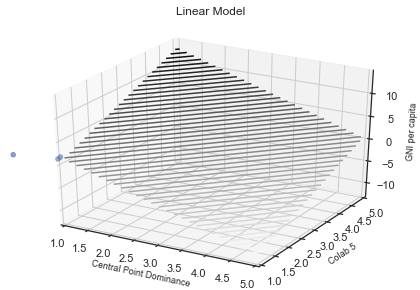




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Central Point Dominance, Colab 7
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8034536099109589, p-value: [[0.03665175 0.0146767 ]]
Regression Coefficients: [-2.89684876  3.05049333]
Intercept: 1.5171834499328092


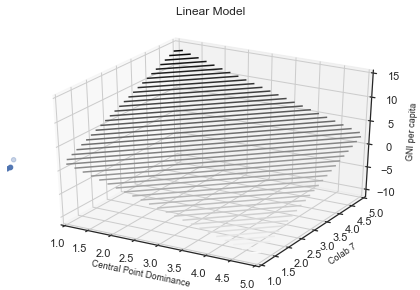




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, avg strength
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.885420481994244, p-value: [[0.00825372 0.01219735]]
Regression Coefficients: [-1.89729693  1.71947522]
Intercept: 4.114525765087759


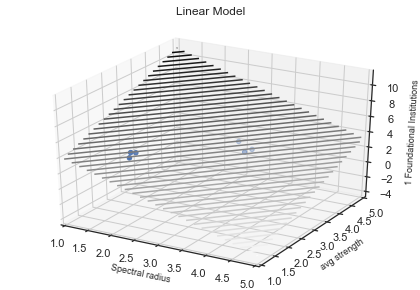




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9223883855537937, p-value: [[0.002352   0.00254957]]
Regression Coefficients: [-0.78335021  0.8945887 ]
Intercept: 3.5585540537403557


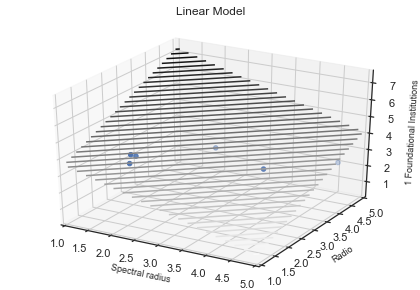




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.924361783149541, p-value: [[0.00426417 0.0071863 ]]
Regression Coefficients: [-0.25761554  0.26005012]
Intercept: 2.651049106696453


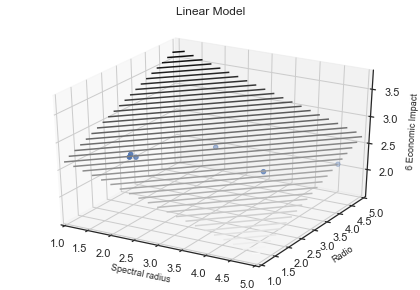




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8974128891655385, p-value: [[0.00751842 0.00410944]]
Regression Coefficients: [-1.97157505  2.32472825]
Intercept: 3.109019885896473


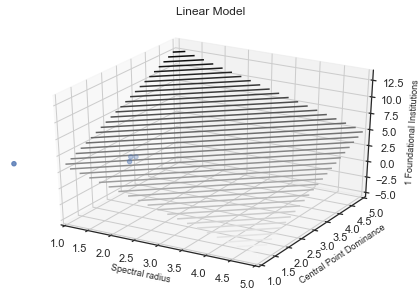




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Spectral radius, Central Point Dominance
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8007171311522117, p-value: [[0.01203277 0.00885114]]
Regression Coefficients: [-1.68340406  1.83406045]
Intercept: 3.916104963463756


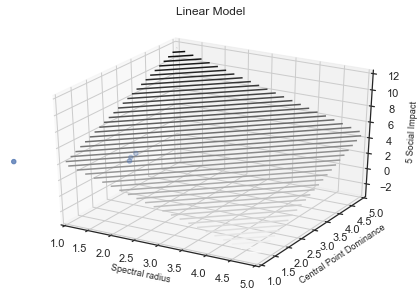




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, avg strength
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8398819421951399, p-value: [[0.0152379  0.02117966]]
Regression Coefficients: [-1.54518638  1.42372146]
Intercept: 3.9068487076161817


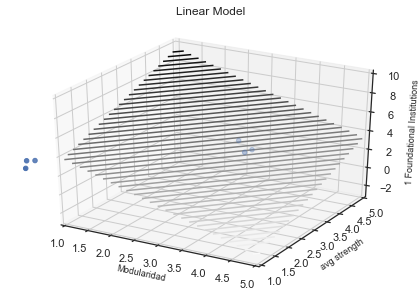




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9549261319084834, p-value: [[0.00165493 0.00269099]]
Regression Coefficients: [-0.76886072  0.81699589]
Intercept: 3.768359103928047


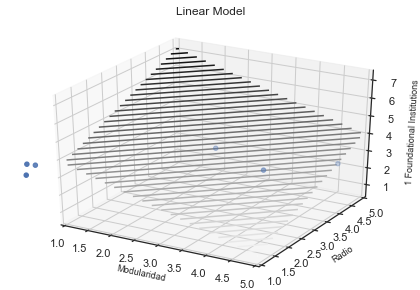




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8807074782395233, p-value: [[0.02270859 0.04524312]]
Regression Coefficients: [-0.2337659   0.22566342]
Intercept: 2.67019005894913


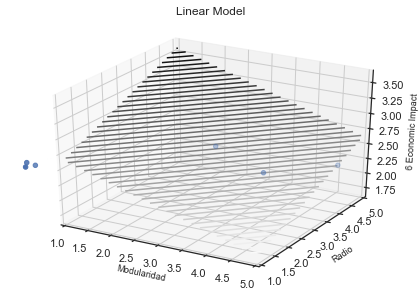




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Modularidad, Central Point Dominance
Predicted: 5 Social Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8983864593522444, p-value: [[0.03754874 0.00246096]]
Regression Coefficients: [-0.69909755  1.50398858]
Intercept: 3.8023841092280795


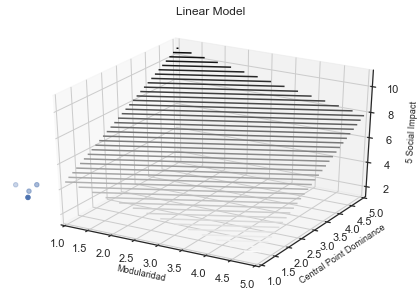




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Average Collaborations, weight
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8295980323931595, p-value: [[0.01095674 0.01031333]]
Regression Coefficients: [-0.22157055  0.22983684]
Intercept: 3.1659615085262125


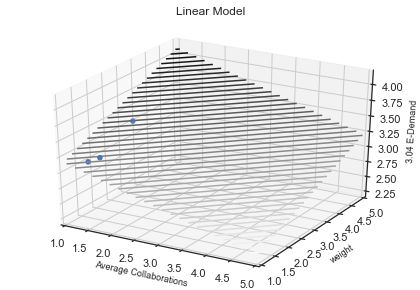




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, weight
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8437727549184237, p-value: [[0.00603196 0.02444094]]
Regression Coefficients: [ 0.23579798 -0.11759593]
Intercept: 3.09881457485176


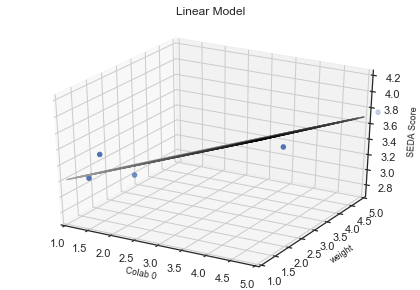




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Degree
Predicted: 2.05 I-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8685434585503032, p-value: [[0.00046149 0.00771237]]
Regression Coefficients: [0.85366297 0.30033984]
Intercept: -2.9001862444778554


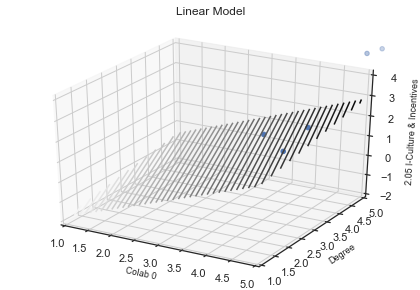




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Degree
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9817021800918094, p-value: [[6.74132406e-06 2.90945246e-03]]
Regression Coefficients: [ 0.37715515 -0.05957712]
Intercept: 2.0744011638705553


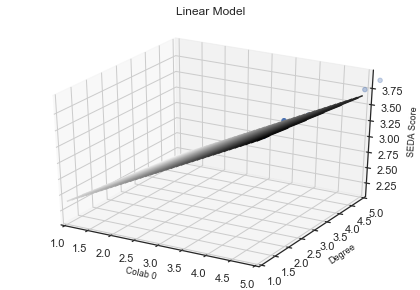




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Radio
Predicted: 3.05 E-Culture & Incentives
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9389714347535688, p-value: [[0.00018672 0.01504188]]
Regression Coefficients: [-0.25748512 -0.06993275]
Intercept: 4.478917744634052


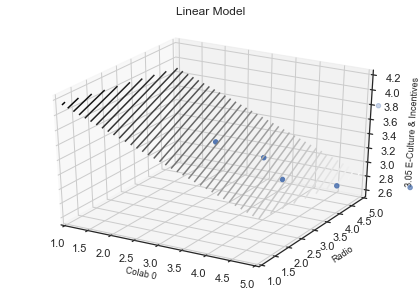




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Small Worldness
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8035325683778253, p-value: [[0.01159186 0.03873514]]
Regression Coefficients: [ 0.22429351 -0.11652075]
Intercept: 3.1502321870380703


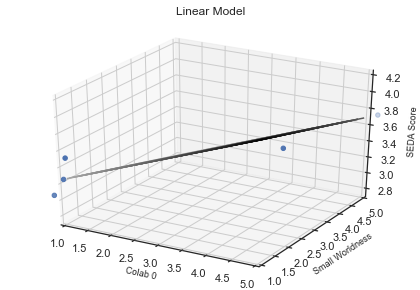




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 0, Colab 10 rescaled
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8997977462145921, p-value: [[0.00543749 0.00136568]]
Regression Coefficients: [0.12118173 0.1469125 ]
Intercept: 1.7726648271033203


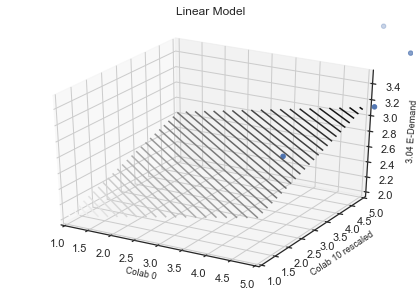




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9568032077783942, p-value: [[0.00143524 0.00223747]]
Regression Coefficients: [-0.26249108  0.27798872]
Intercept: 2.611412843155139


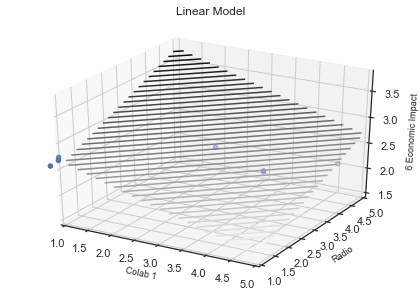




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Rich Club Coefficient
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8790245284331734, p-value: [[0.00392064 0.00092555]]
Regression Coefficients: [0.6001542  0.81218031]
Intercept: 0.9369735602683684


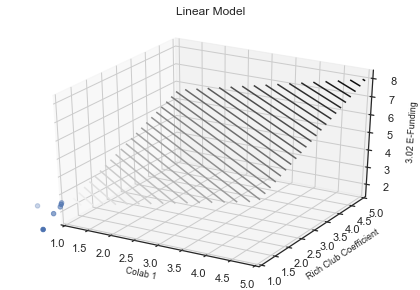




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Rich Club Coefficient
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9793709854761157, p-value: [[1.70848678e-05 3.69402345e-05]]
Regression Coefficients: [0.5439927  0.41294278]
Intercept: 1.7816379453054507


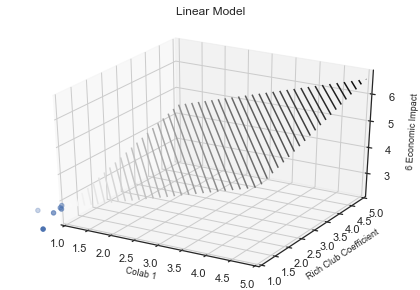




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Core Ratio
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8266278035195201, p-value: [[0.00756714 0.0225832 ]]
Regression Coefficients: [ 2.9388102  -1.92581121]
Intercept: 2.7994644131513224


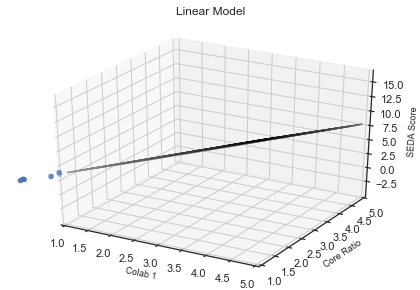




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 1, Colab 5
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.839893588489316, p-value: [[0.02391754 0.0057201 ]]
Regression Coefficients: [1.57191988 2.20121732]
Intercept: -0.32047752086142145


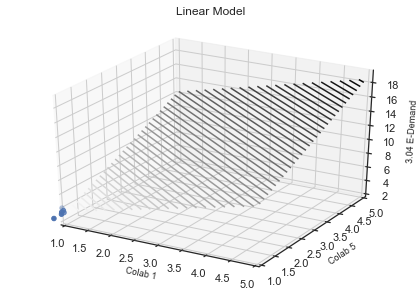




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8690404947077908, p-value: [[0.02101722 0.03860075]]
Regression Coefficients: [-0.20262965  0.20140104]
Intercept: 2.624866469576319


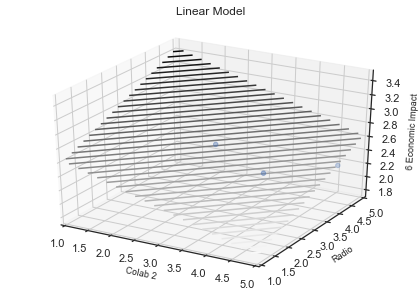




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 2, Transitividad
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9293777076883109, p-value: [[0.02611276 0.00099864]]
Regression Coefficients: [1.22981181 1.21046791]
Intercept: 3.0352431337160364


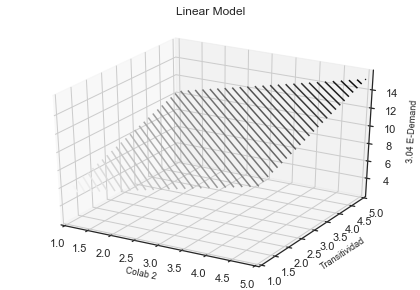




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8395594729645377, p-value: [[0.02465793 0.03079883]]
Regression Coefficients: [-0.57770437  0.54588312]
Intercept: 2.6277620548637857


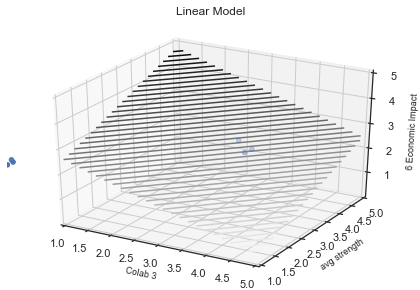




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Clustering
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.975376034401099, p-value: [[3.77702289e-05 7.48740403e-04]]
Regression Coefficients: [5.86076197 2.20568928]
Intercept: -0.08265908939017308


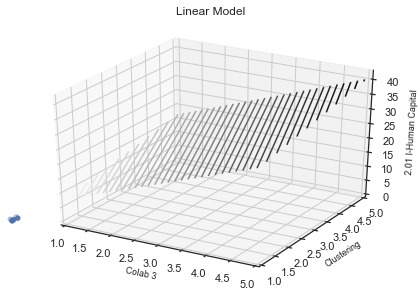




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8811521643076926, p-value: [[0.00524095 0.00388723]]
Regression Coefficients: [-1.16903718  1.53410122]
Intercept: 2.9416683312599616


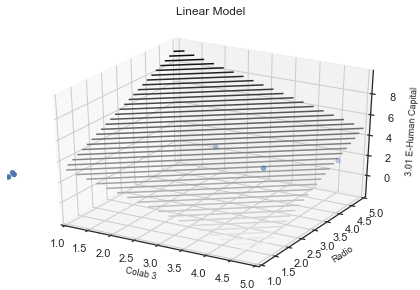




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9712218912710704, p-value: [[0.00095083 0.00161688]]
Regression Coefficients: [-0.27869785  0.29306677]
Intercept: 2.627781151670536


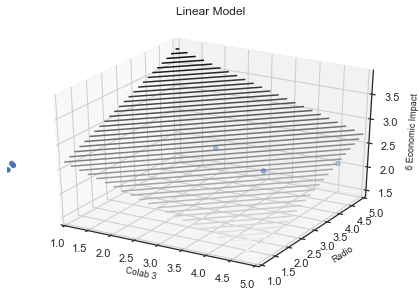




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Transitividad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8301572276665046, p-value: [[0.01065495 0.02142909]]
Regression Coefficients: [ 3.77638087 -2.43455628]
Intercept: 3.237423289081001


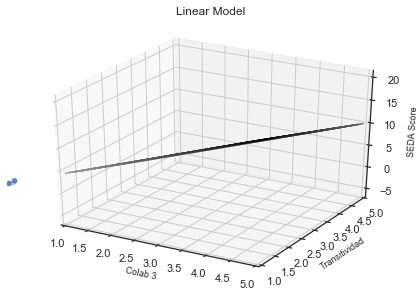




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Eficiencia Global
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9396382067457295, p-value: [[0.00111794 0.00043941]]
Regression Coefficients: [2.598867   2.90032973]
Intercept: 1.1133721936440666


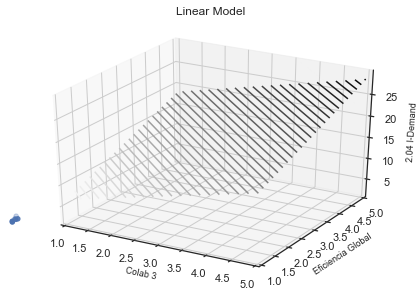




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Eficiencia Global
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8170453863804197, p-value: [[0.00251584 0.0058857 ]]
Regression Coefficients: [4.49223816 3.1202409 ]
Intercept: -0.3141599041928216


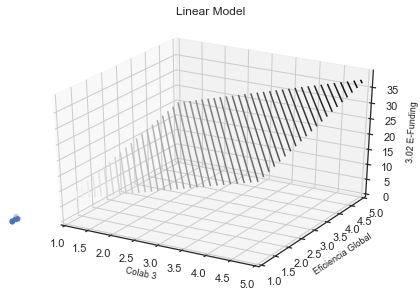




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9692676592872634, p-value: [[0.00058818 0.00181907]]
Regression Coefficients: [1.2066339  0.65978553]
Intercept: 2.037069666004863


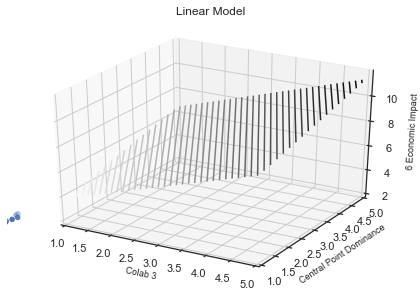




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 4
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8113300943411544, p-value: [[0.01304972 0.03009244]]
Regression Coefficients: [2.30314905 1.41680099]
Intercept: 1.0793513032441364


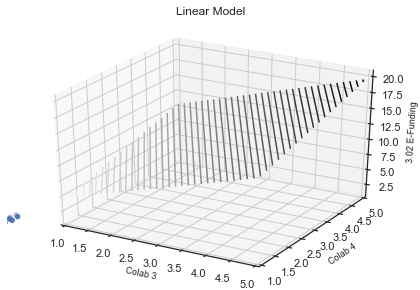




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 6
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.879447702812409, p-value: [[0.00318945 0.00871515]]
Regression Coefficients: [3.01170784 1.86689212]
Intercept: 0.6993283515809459


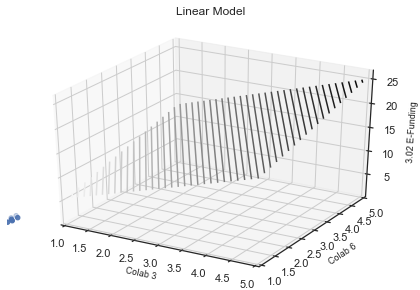




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 6
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.946928684568964, p-value: [[0.00019713 0.02239017]]
Regression Coefficients: [ 6.02079451 -1.36416893]
Intercept: 2.182160551938865


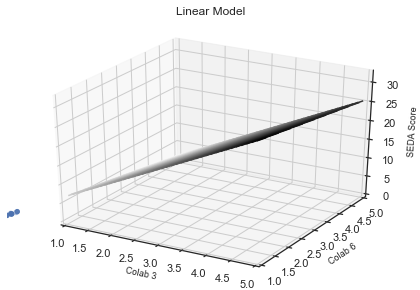




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 7
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8815952051923465, p-value: [[0.00445142 0.00206694]]
Regression Coefficients: [2.45797751 2.68449075]
Intercept: 1.2548571016343022


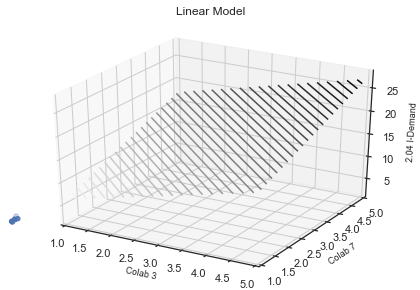




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 7
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8785486077639786, p-value: [[0.00090232 0.00296934]]
Regression Coefficients: [4.68820905 3.03641653]
Intercept: -0.31230752101700565


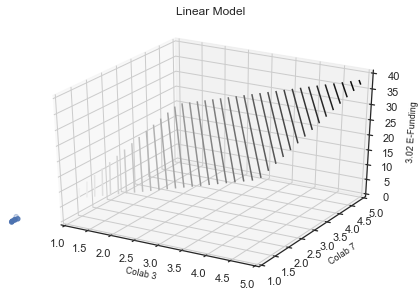




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 9
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.924653236859748, p-value: [[0.00131005 0.00052946]]
Regression Coefficients: [2.71491642 3.03182022]
Intercept: 0.9895608328025469


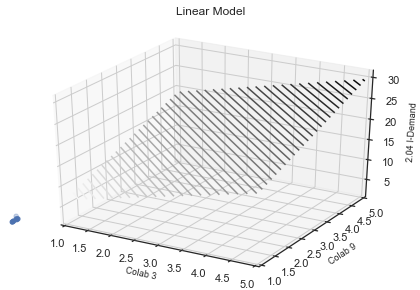




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 11
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8008456514185223, p-value: [[0.00071664 0.04046442]]
Regression Coefficients: [8.44650977 2.3427916 ]
Intercept: -0.9934710608733903


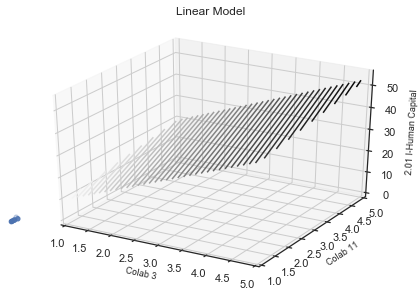




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 11
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8471258614614551, p-value: [[0.00794165 0.00337287]]
Regression Coefficients: [2.32924081 2.57475593]
Intercept: 1.3406445928617432


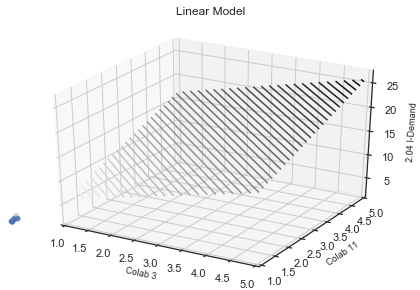




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 11
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9011733116719689, p-value: [[0.00052254 0.00191819]]
Regression Coefficients: [4.77549648 2.96423144]
Intercept: -0.2920995769138748


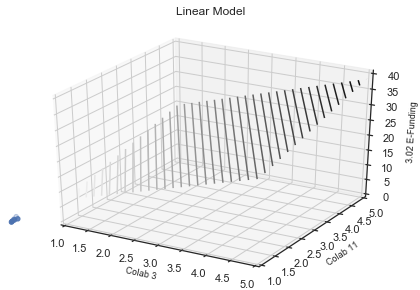




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 12
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8866779041154536, p-value: [[0.00064419 0.00323887]]
Regression Coefficients: [4.82659446 2.75370873]
Intercept: -0.22079019400552768


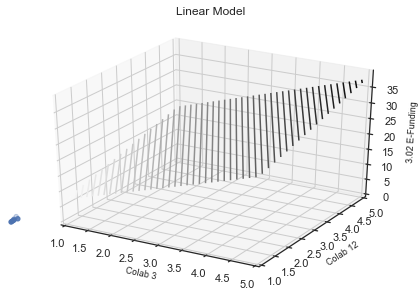




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 12
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9660062825669068, p-value: [[1.41165751e-05 4.37372869e-02]]
Regression Coefficients: [6.30477777 0.62917812]
Intercept: 1.8059679590400997


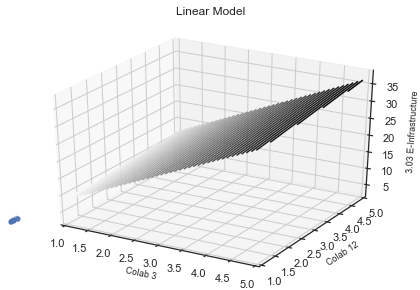




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 3, Colab 13
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8947095964288685, p-value: [[0.04062475 0.00122691]]
Regression Coefficients: [1.47533428 3.6069308 ]
Intercept: 1.4095080332128465


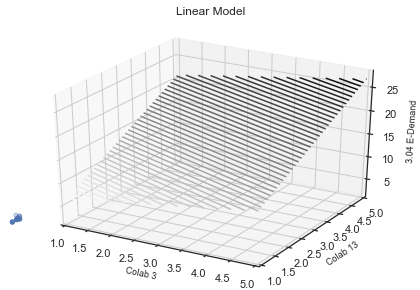




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8192107758472958, p-value: [[0.03189439 0.03979167]]
Regression Coefficients: [-0.5500744   0.51875573]
Intercept: 2.6243728273359936


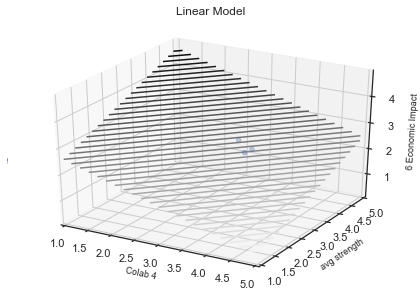




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8670991725883148, p-value: [[0.00689435 0.00525291]]
Regression Coefficients: [-1.14670595  1.49688268]
Intercept: 2.976252707615844


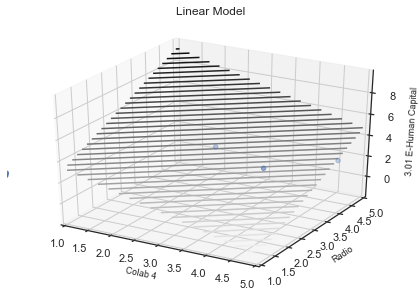




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9648673631930302, p-value: [[0.00147858 0.00254001]]
Regression Coefficients: [-0.27463547  0.28778982]
Intercept: 2.6288638349289233


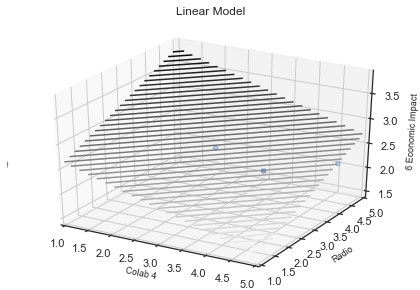




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Transitividad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8882004571091751, p-value: [[0.00314955 0.01351768]]
Regression Coefficients: [ 4.60945653 -2.15379731]
Intercept: 3.1307792119773095


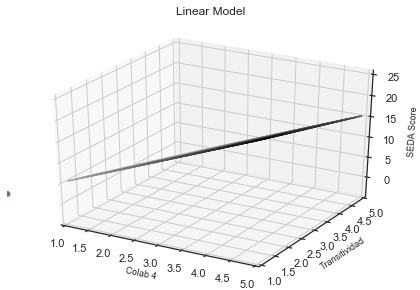




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 4, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9069503551694235, p-value: [[0.00235608 0.0090975 ]]
Regression Coefficients: [5.20770839 2.39426255]
Intercept: 1.4742384531104253


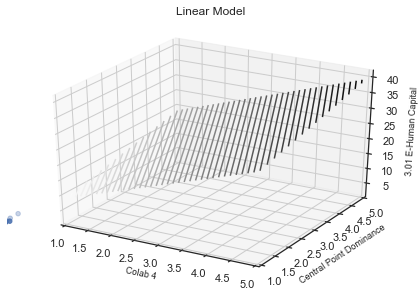




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8663699148286383, p-value: [[0.00813239 0.00624704]]
Regression Coefficients: [-2.64711922  2.88309517]
Intercept: 2.749866465295587


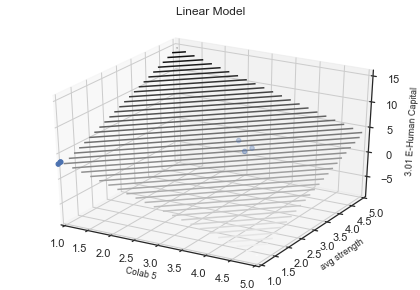




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9374306737937778, p-value: [[0.00325018 0.0040707 ]]
Regression Coefficients: [-0.71642921  0.68136201]
Intercept: 2.6462421868201447


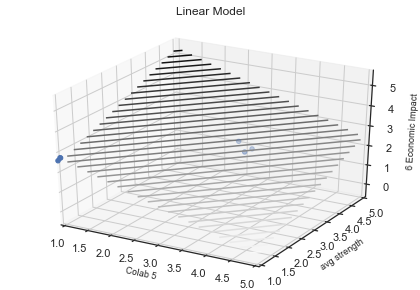




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8190029493594189, p-value: [[0.01962869 0.02528262]]
Regression Coefficients: [-0.7205209   0.79494656]
Intercept: 3.6417766303762784


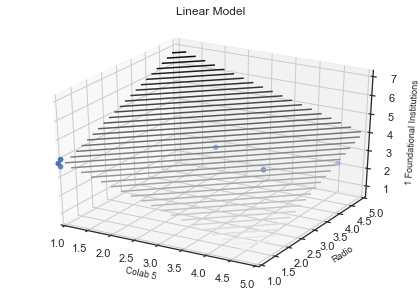




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9036367332590768, p-value: [[0.00215164 0.00124031]]
Regression Coefficients: [-1.25165794  1.72850953]
Intercept: 2.6145448043216275


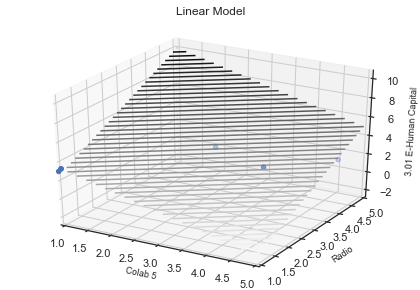




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9895240095089946, p-value: [[8.32916261e-05 1.25526445e-04]]
Regression Coefficients: [-0.2930418   0.31527366]
Intercept: 2.6113898425159183


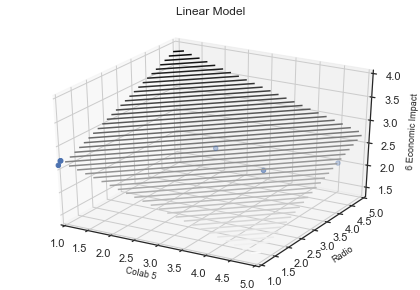




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Eficiencia Global
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8764184649136559, p-value: [[0.00603718 0.00665321]]
Regression Coefficients: [-5.31805803  4.88598108]
Intercept: 3.318677924718104


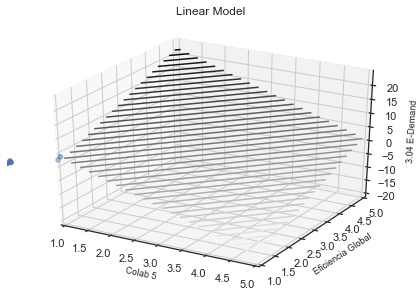




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Rich Club Coefficient
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9687490315744633, p-value: [[6.64028562e-05 1.31305040e-04]]
Regression Coefficients: [0.48135316 0.38493637]
Intercept: 1.8347452610091604


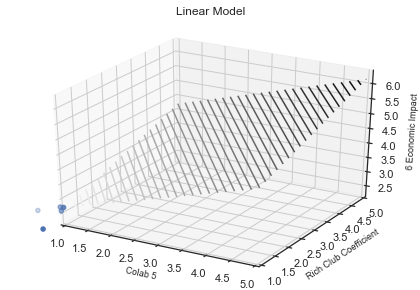




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8970920004228318, p-value: [[0.00347857 0.00282706]]
Regression Coefficients: [-3.90219806  3.77338431]
Intercept: 3.0419958101971


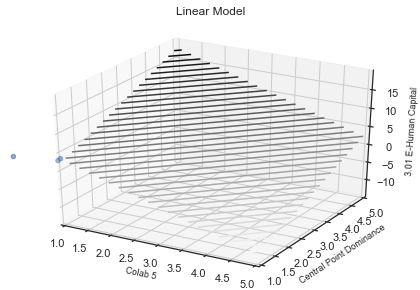




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9727290599408572, p-value: [[0.00300219 0.00052759]]
Regression Coefficients: [-0.6414064  0.9264796]
Intercept: 2.33493159948694


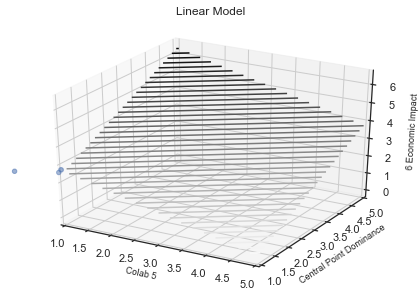




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 1
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8386324769913264, p-value: [[0.00085114 0.01860358]]
Regression Coefficients: [3.77729657 1.4831787 ]
Intercept: -2.7218954590297506


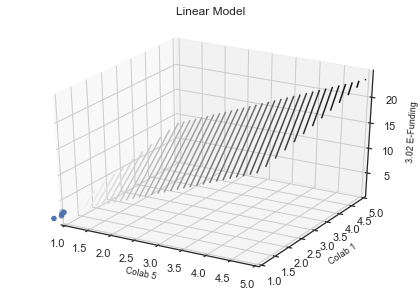




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 7
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8957415265634852, p-value: [[0.00390172 0.00458907]]
Regression Coefficients: [-5.48843674  4.97184898]
Intercept: 3.393442337735681


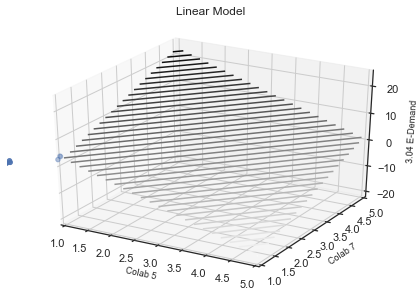




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 5, Colab 9
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8632610330581711, p-value: [[0.00728958 0.00821415]]
Regression Coefficients: [-5.04927192  4.61203203]
Intercept: 3.339229579120876


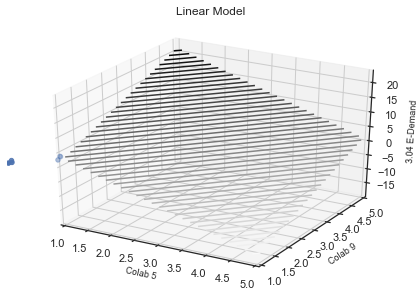




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8528740775996486, p-value: [[0.0210678  0.02616071]]
Regression Coefficients: [-0.60838294  0.57711772]
Intercept: 2.6276267483113713


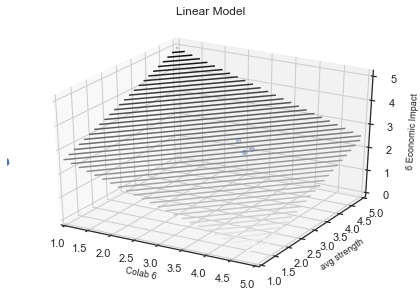




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8976612522516412, p-value: [[0.00404313 0.00308448]]
Regression Coefficients: [-1.19048013  1.550571  ]
Intercept: 2.9749230091781325


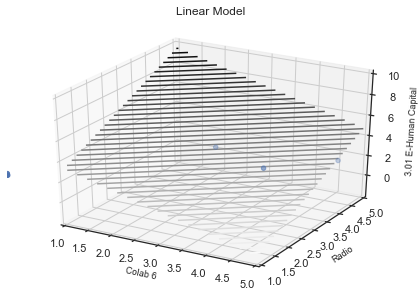




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9696190501116613, p-value: [[0.00111846 0.00191954]]
Regression Coefficients: [-0.28044429  0.29432522]
Intercept: 2.630704191247372


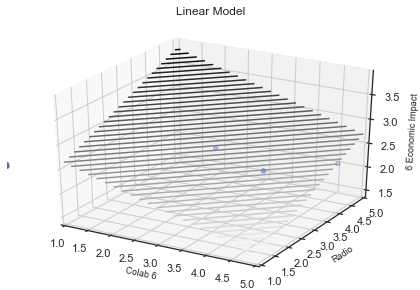




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Transitividad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8492072059130282, p-value: [[0.00760186 0.01766451]]
Regression Coefficients: [ 4.44281398 -2.64715009]
Intercept: 3.214300278654288


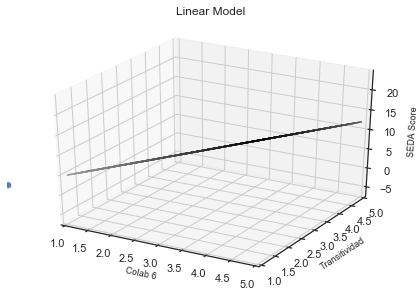




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Colab 4
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8963321492229376, p-value: [[0.00012225 0.04976603]]
Regression Coefficients: [8.78086528 1.28128084]
Intercept: -0.002774144976215087


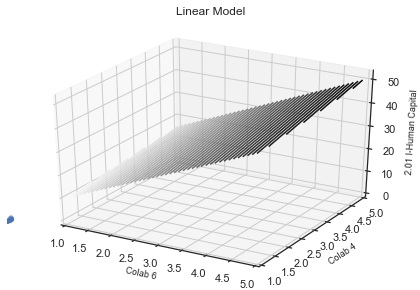




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Colab 4
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.946045588782433, p-value: [[3.17038820e-05 3.44716806e-02]]
Regression Coefficients: [5.30369625 0.62346205]
Intercept: 1.5522604858005866


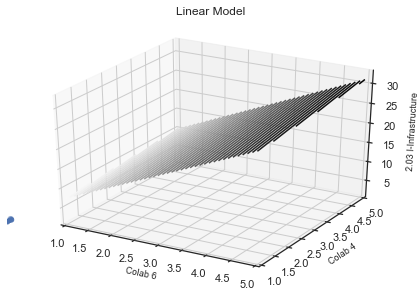




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 6, Colab 4
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9616670420700613, p-value: [[2.22683031e-05 2.55401488e-04]]
Regression Coefficients: [6.07153866 2.53735689]
Intercept: 0.07008650547495066


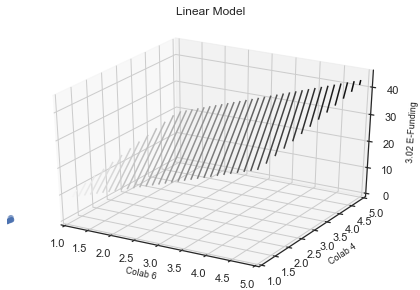




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8683627137956855, p-value: [[0.00921473 0.00810716]]
Regression Coefficients: [-2.72005584  2.86701036]
Intercept: 3.0543950579883976


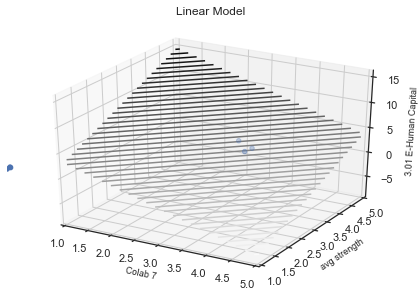




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9205105326070175, p-value: [[0.00649066 0.0083202 ]]
Regression Coefficients: [-0.71622485  0.67853825]
Intercept: 2.65534679487698


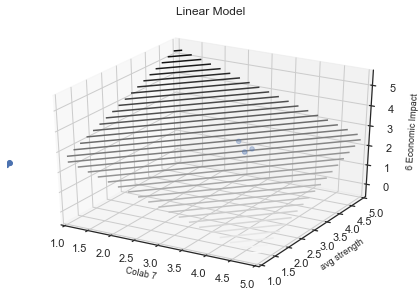




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Clustering
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8793019378174572, p-value: [[0.00077737 0.00979089]]
Regression Coefficients: [7.359265   3.23725191]
Intercept: -0.7524226093900754


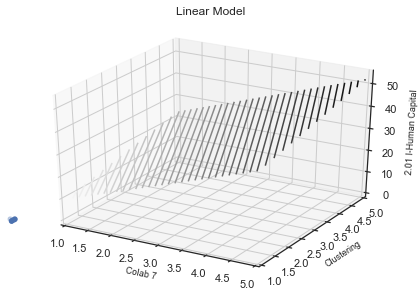




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Clustering
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9917416448627716, p-value: [[1.08485930e-05 7.03297623e-07]]
Regression Coefficients: [3.42382138 5.93411368]
Intercept: 0.07678528353391689


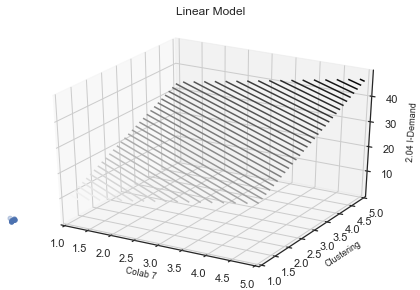




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Clustering
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9301021176873628, p-value: [[3.90073588e-02 6.23328614e-05]]
Regression Coefficients: [1.44206836 7.29405999]
Intercept: 0.5293935809181076


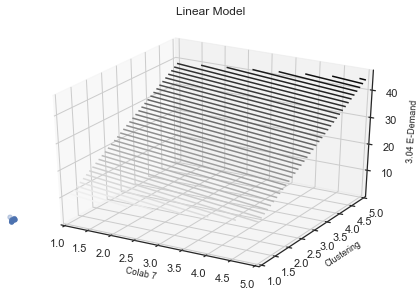




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Radio
Predicted: 1 Foundational Institutions
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8113443696849287, p-value: [[0.03227823 0.04695112]]
Regression Coefficients: [-0.71404334  0.76206262]
Intercept: 3.7291747708240552


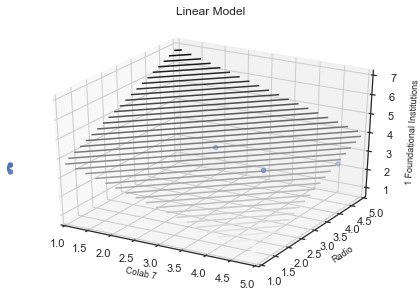




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9467033895144708, p-value: [[0.00114622 0.00090121]]
Regression Coefficients: [-1.24889895  1.61026566]
Intercept: 3.0135306300111755


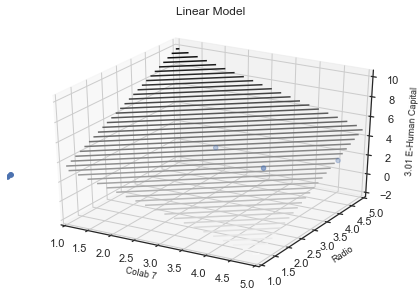




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9791312266039863, p-value: [[0.00056639 0.00100927]]
Regression Coefficients: [-0.28802004  0.30015702]
Intercept: 2.6422548014682543


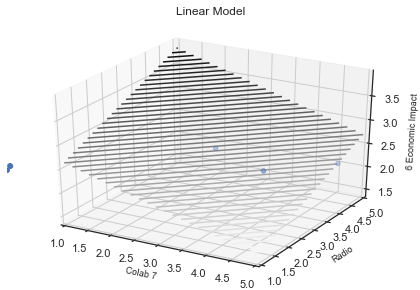




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Eficiencia Global
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8300769448403249, p-value: [[0.00425878 0.02905028]]
Regression Coefficients: [6.49668266 3.51819359]
Intercept: -0.2826269653071858


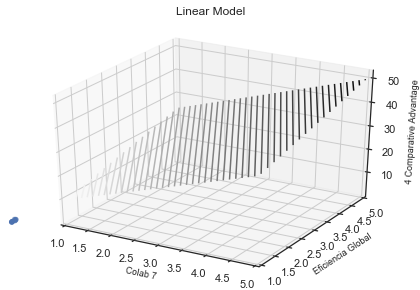




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9248458116245631, p-value: [[0.02518969 0.00202746]]
Regression Coefficients: [-2.31120545  3.74352397]
Intercept: 2.688973740956271


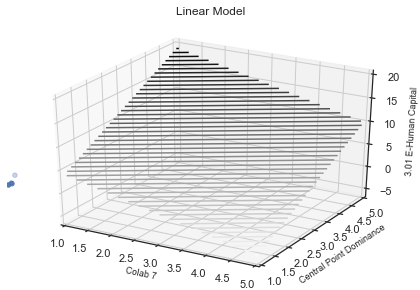




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9906944812720605, p-value: [[1.52760674e-05 5.75977977e-04]]
Regression Coefficients: [1.78662054 0.56190931]
Intercept: 1.9382509320715244


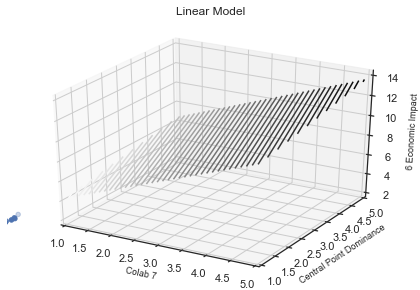




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8378846018153516, p-value: [[0.00070244 0.00995386]]
Regression Coefficients: [5.27714853 2.28805901]
Intercept: 0.4321439084374754


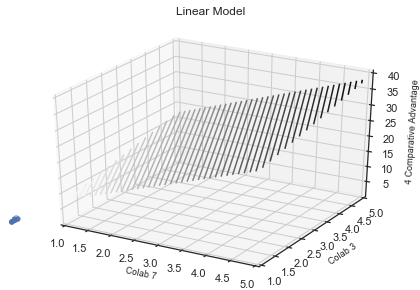




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 4
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8200681794930628, p-value: [[0.00677943 0.03233109]]
Regression Coefficients: [3.08095141 1.67961621]
Intercept: 0.8479246047718401


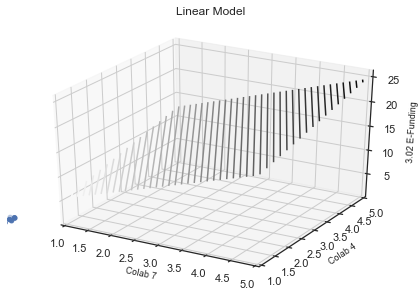




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 6
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9251572257670967, p-value: [[0.00071001 0.00415454]]
Regression Coefficients: [4.4162825  2.47356481]
Intercept: 0.19847400417083838


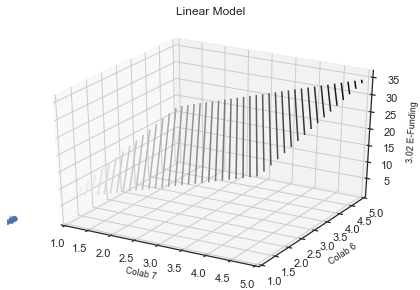




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 11
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8469878598721872, p-value: [[0.00251592 0.00796031]]
Regression Coefficients: [5.32850539 3.68598225]
Intercept: 0.18785162567674574


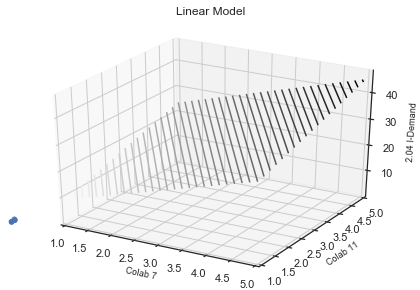




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 11
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8181071981066891, p-value: [[0.0010945  0.02383871]]
Regression Coefficients: [8.91184478 3.57073645]
Intercept: -1.6104509363760129


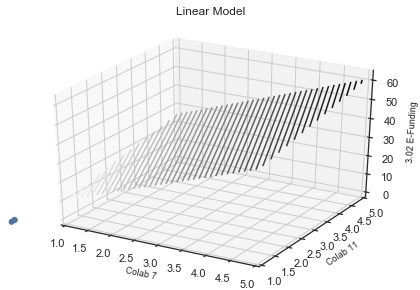




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 12
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8249187208538744, p-value: [[0.00305279 0.0119789 ]]
Regression Coefficients: [5.40808031 3.51565488]
Intercept: 0.23611452622081597


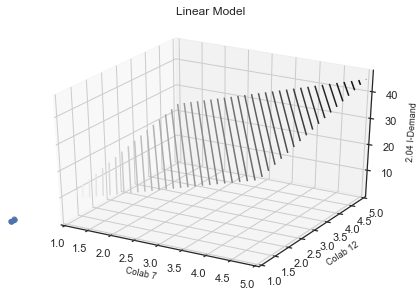




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 7, Colab 12
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8988145673070926, p-value: [[0.0002613  0.01120268]]
Regression Coefficients: [9.617644   3.35414031]
Intercept: -1.7254552873555586


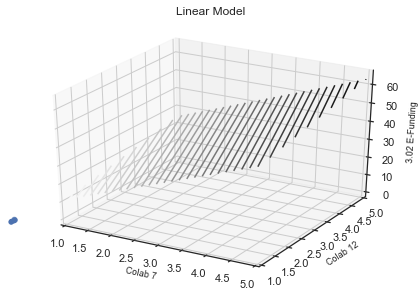




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8917157634840029, p-value: [[0.01191254 0.01520385]]
Regression Coefficients: [-0.65946822  0.6231472 ]
Intercept: 2.6474385232365556


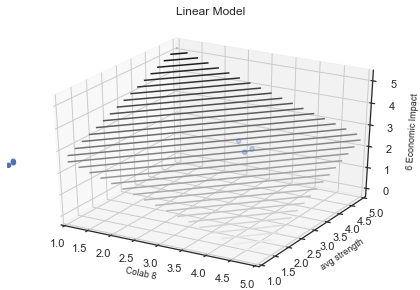




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9201367335902043, p-value: [[0.00249636 0.00191248]]
Regression Coefficients: [-1.21593266  1.57940685]
Intercept: 2.9814834039432054


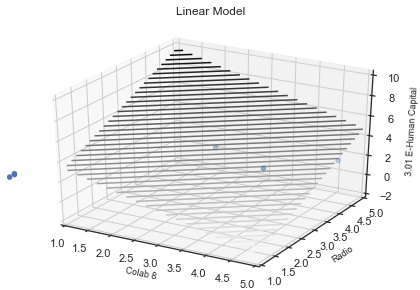




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9793622516722202, p-value: [[0.00052683 0.00092537]]
Regression Coefficients: [-0.28522837  0.29817046]
Intercept: 2.6374518029955047


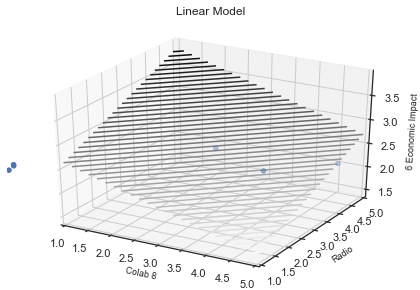




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Eficiencia Global
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.871489695652291, p-value: [[0.01729665 0.00822644]]
Regression Coefficients: [2.37875422 2.74302793]
Intercept: 1.2099470005485293


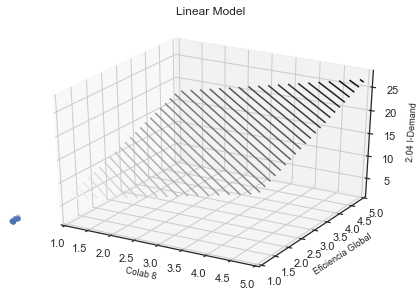




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Eficiencia Global
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9626725390549168, p-value: [[9.19857672e-05 2.66649608e-03]]
Regression Coefficients: [6.39566347 2.48207264]
Intercept: -0.7532903908720914


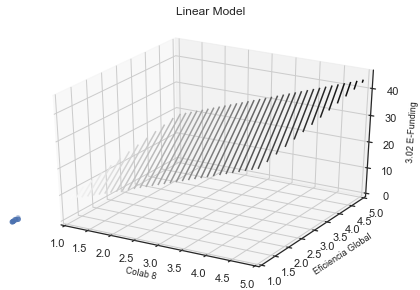




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Eficiencia Global
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9930019304574805, p-value: [[9.17720364e-07 2.91490175e-04]]
Regression Coefficients: [12.8487728  -2.79214222]
Intercept: 0.2308772328607831


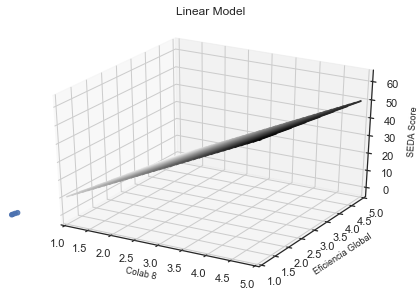




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9888847695087217, p-value: [[0.00010335 0.00040516]]
Regression Coefficients: [1.13421994 0.63068067]
Intercept: 2.051816890966552


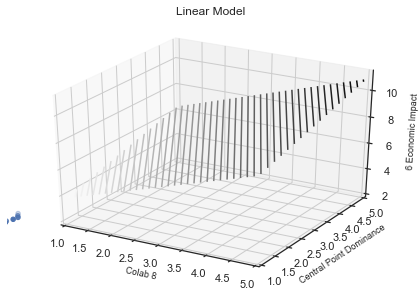




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 3
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8302735184966961, p-value: [[0.00272481 0.0050229 ]]
Regression Coefficients: [3.07157632 2.27282301]
Intercept: 1.1085078332473124


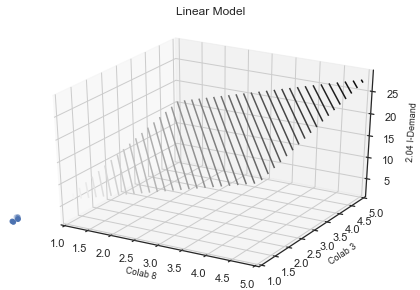




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 3
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8914961325845623, p-value: [[0.00031556 0.00432451]]
Regression Coefficients: [5.30913654 2.33052478]
Intercept: -0.39853165466703055


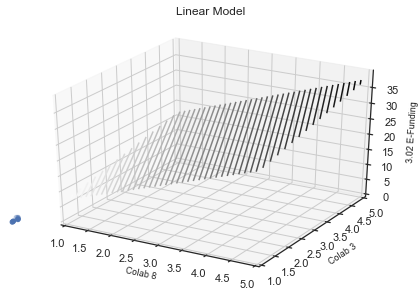




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 7
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9606616353035016, p-value: [[0.00012651 0.00414148]]
Regression Coefficients: [5.97111566 2.26235943]
Intercept: -0.5152830457211093


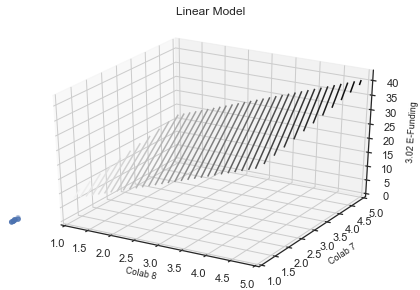




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 7
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9986240784015977, p-value: [[3.71282456e-08 9.06959222e-06]]
Regression Coefficients: [12.53194169 -2.9777746 ]
Intercept: 0.3978071956209406


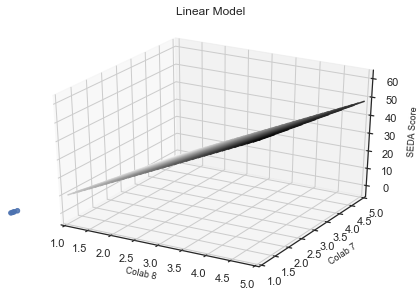




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 9
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9401240116609481, p-value: [[0.00058357 0.0014899 ]]
Regression Coefficients: [3.96996548 2.89646421]
Intercept: 0.6014088271804172


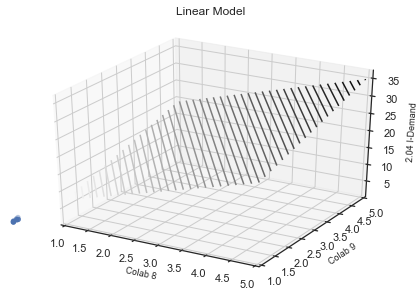




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 9
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8428687839659383, p-value: [[0.00079061 0.02633788]]
Regression Coefficients: [7.3158547  2.56015572]
Intercept: -1.148583920781403


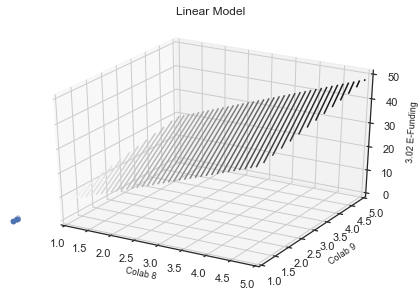




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 9
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9420071109885257, p-value: [[4.94946576e-05 1.77717621e-02]]
Regression Coefficients: [13.14356163 -2.56167378]
Intercept: -0.027951803628294858


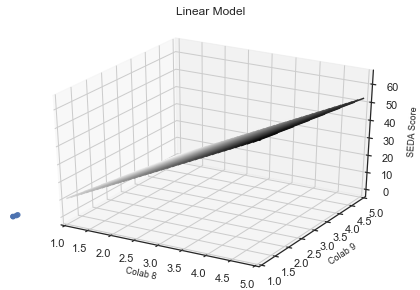




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 11
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9252463113864581, p-value: [[0.00062223 0.00864715]]
Regression Coefficients: [5.08112959 2.31803205]
Intercept: -0.22969712477558346


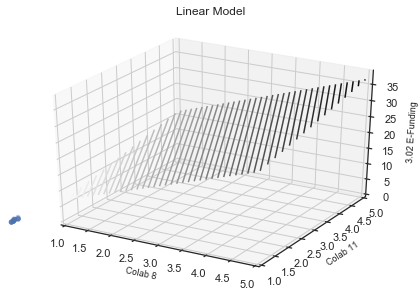




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 11
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9321505373111333, p-value: [[0.0001484  0.01966516]]
Regression Coefficients: [10.18781386 -2.52599216]
Intercept: 1.036696492006913


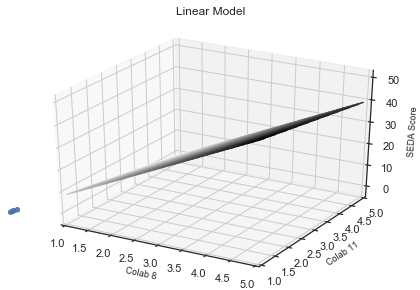




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 12
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.90399499337316, p-value: [[0.00099389 0.02088448]]
Regression Coefficients: [5.0852429  2.02373209]
Intercept: -0.11927260739236711


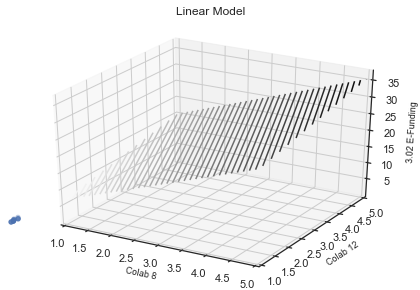




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 8, Colab 12
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9505458174243241, p-value: [[8.74795484e-05 8.23418884e-03]]
Regression Coefficients: [ 9.92013302 -2.78749714]
Intercept: 1.2148801191704917


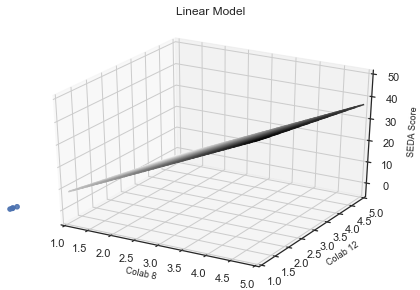




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8545712256287673, p-value: [[0.01118002 0.00971166]]
Regression Coefficients: [-2.67081241  2.82607148]
Intercept: 3.0236263379798354


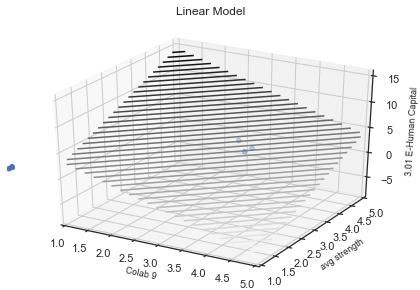




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9138362221026439, p-value: [[0.00755502 0.00960262]]
Regression Coefficients: [-0.70577773  0.66959883]
Intercept: 2.649670845616103


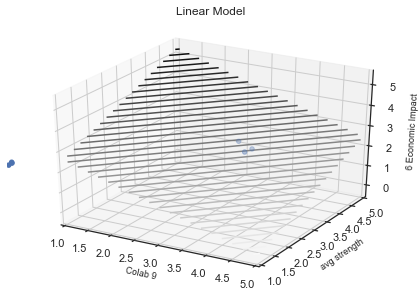




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Clustering
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8647898919758211, p-value: [[0.00245632 0.03926361]]
Regression Coefficients: [5.74096633 2.21429859]
Intercept: -0.07718603555965142


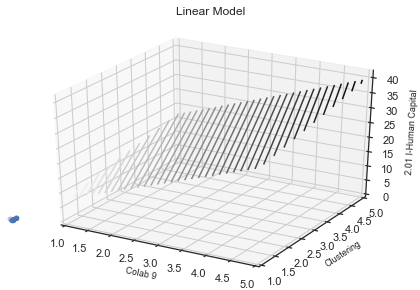




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9400870188810698, p-value: [[0.00141035 0.00109004]]
Regression Coefficients: [-1.24448903  1.61154592]
Intercept: 2.9906772881058696


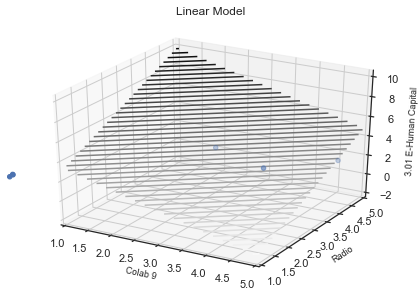




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.97816713299208, p-value: [[0.00060388 0.00106202]]
Regression Coefficients: [-0.28756956  0.30052448]
Intercept: 2.639123012937441


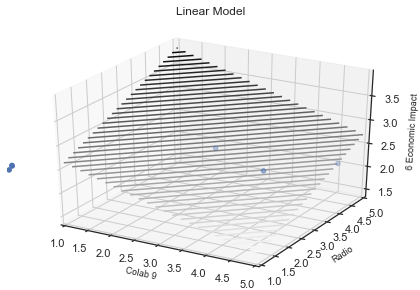




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Eficiencia Global
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8057231787046464, p-value: [[0.02467017 0.01999168]]
Regression Coefficients: [3.52995651 3.5408176 ]
Intercept: 0.62356915573086


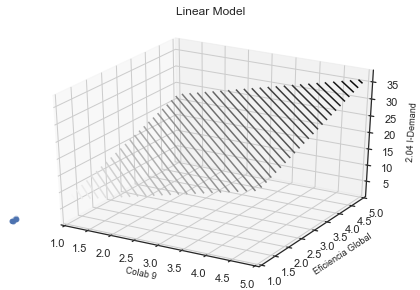




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Eficiencia Global
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9592860789052646, p-value: [[0.00011418 0.00301279]]
Regression Coefficients: [8.51570749 3.42150828]
Intercept: -1.6690393557149652


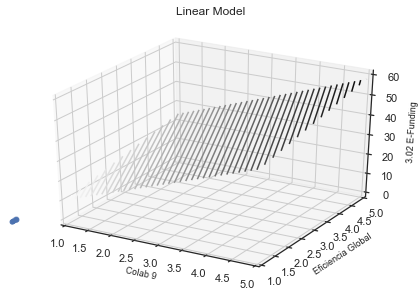




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Eficiencia Global
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9537171812016635, p-value: [[4.65322194e-05 1.17216871e-02]]
Regression Coefficients: [16.60947931 -3.63764596]
Intercept: -0.6169016869780637


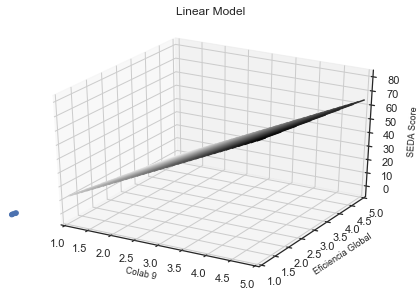




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8948131820756485, p-value: [[0.02276892 0.00380052]]
Regression Coefficients: [-2.81387812  3.73671109]
Intercept: 2.7932822424600134


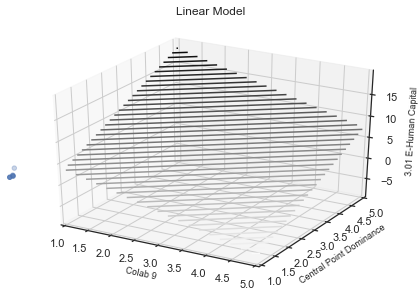




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9988754224914379, p-value: [[7.36393044e-07 5.26267987e-06]]
Regression Coefficients: [1.32425386 0.64086205]
Intercept: 2.009058986433236


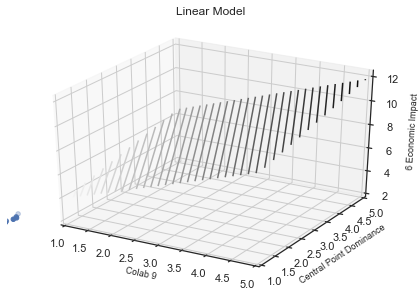




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Colab 3
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8324045558491338, p-value: [[0.00077749 0.00562599]]
Regression Coefficients: [5.21331968 2.71007649]
Intercept: 0.21761556775495094


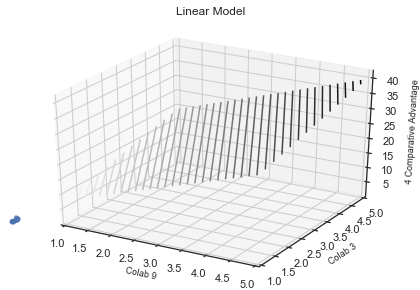




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Colab 6
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8120177829686513, p-value: [[0.01522453 0.0413564 ]]
Regression Coefficients: [3.01467866 1.94911089]
Intercept: 0.6682860231646326


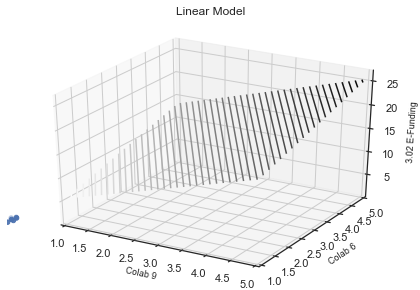




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Colab 7
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9938187312105187, p-value: [[3.38968672e-06 1.06805128e-04]]
Regression Coefficients: [7.97030313 3.19193253]
Intercept: -1.3830214176514102


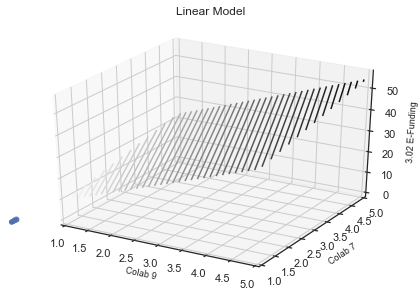




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Colab 7
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9582955950161454, p-value: [[4.15679345e-05 7.78306972e-03]]
Regression Coefficients: [16.07649779 -3.91047219]
Intercept: -0.35668164613190756


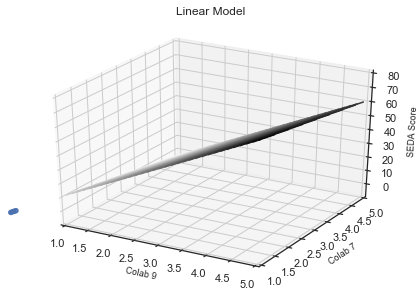




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Colab 11
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.981637536649437, p-value: [[2.99112686e-05 4.03752073e-04]]
Regression Coefficients: [6.86750874 3.32702625]
Intercept: -1.053002481525148


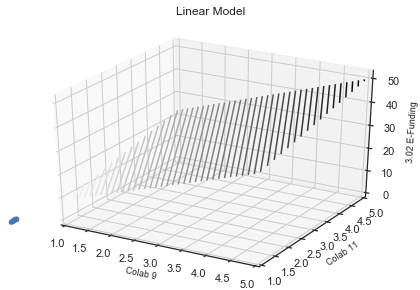




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 9, Colab 12
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9521814688595802, p-value: [[0.00020424 0.00459233]]
Regression Coefficients: [6.80097022 2.82847508]
Intercept: -0.8524031893643436


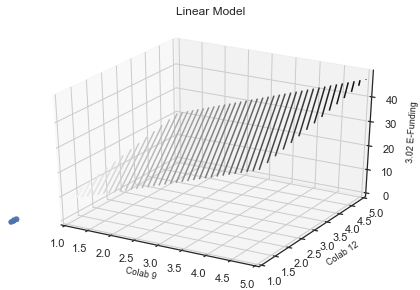




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8382484884314726, p-value: [[0.02594314 0.03298701]]
Regression Coefficients: [-0.58041365  0.54480038]
Intercept: 2.640570481365108


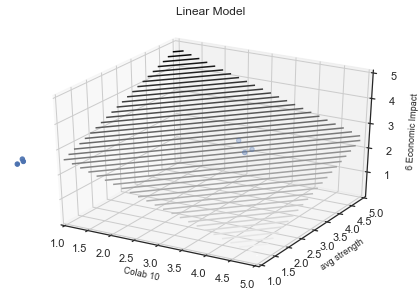




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Clustering
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8405633944963651, p-value: [[0.00910813 0.01793417]]
Regression Coefficients: [ 3.59256592 -2.53592619]
Intercept: 3.1474036342095264


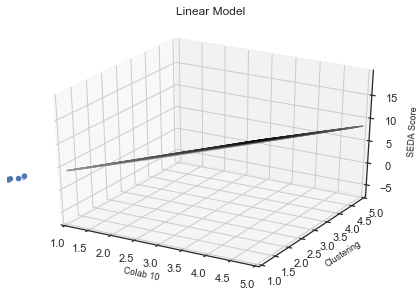




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.874629807244324, p-value: [[0.00563134 0.0040628 ]]
Regression Coefficients: [-1.16812164  1.54254872]
Intercept: 2.9078457160751756


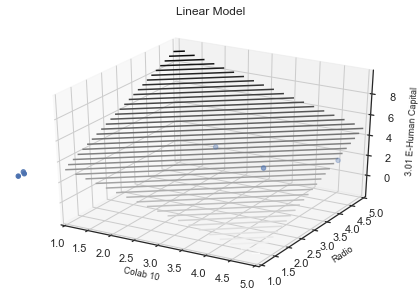




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9693184583544978, p-value: [[0.00105242 0.00179201]]
Regression Coefficients: [-0.27812548  0.29179186]
Intercept: 2.6297469219873566


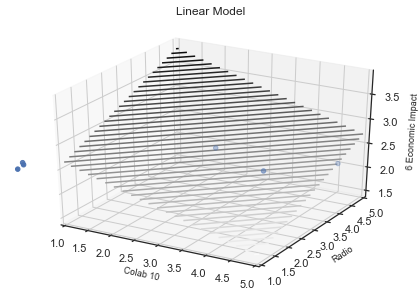




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Transitividad
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8177677327090414, p-value: [[0.01347885 0.01837508]]
Regression Coefficients: [ 3.37945504 -2.68711896]
Intercept: 3.3117856918950976


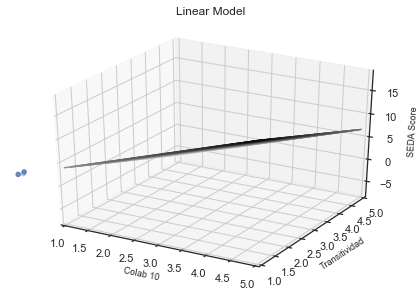




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Eficiencia Global
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.869356765620843, p-value: [[0.00265261 0.02307168]]
Regression Coefficients: [ 5.51516331 -2.69913828]
Intercept: 2.398453834872998


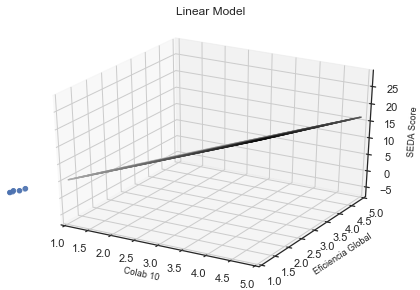




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Core Ratio
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8440302438321209, p-value: [[0.00094952 0.00266104]]
Regression Coefficients: [3.51255694 2.46749666]
Intercept: 0.14274067800041124


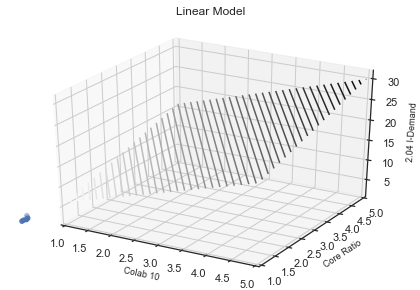




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Core Ratio
Predicted: 3.04 E-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8918905903465516, p-value: [[0.00192501 0.00105257]]
Regression Coefficients: [3.16292132 3.42082744]
Intercept: 0.18174413774007458


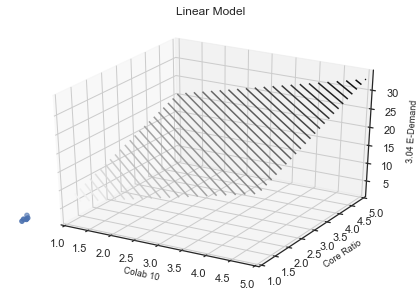




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 3
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8232060319808436, p-value: [[0.00585684 0.04825938]]
Regression Coefficients: [ 3.9878755  -1.82424257]
Intercept: 2.649447969953705


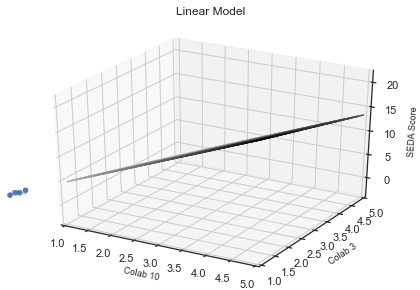




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 6
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.836852132761921, p-value: [[0.00793284 0.02374525]]
Regression Coefficients: [ 3.77966654 -2.38420137]
Intercept: 3.001944722273061


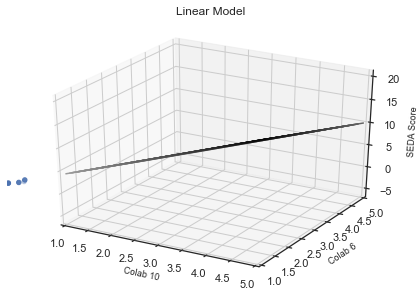




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 7
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8956498382297519, p-value: [[0.0014834  0.01422091]]
Regression Coefficients: [ 5.67037251 -2.78115903]
Intercept: 2.365017932196874


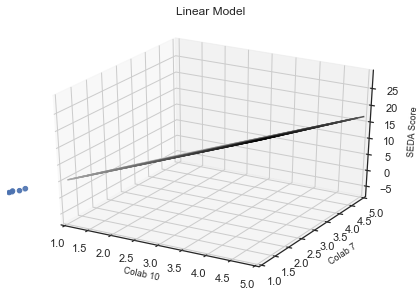




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 8
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9256549052942121, p-value: [[0.00052694 0.01076697]]
Regression Coefficients: [ 5.63089413 -2.25832547]
Intercept: 2.137358558588272


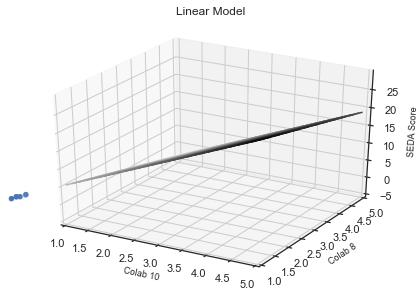




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 9
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9183493166411292, p-value: [[0.00080894 0.01033004]]
Regression Coefficients: [ 5.83787284 -2.66733319]
Intercept: 2.2379614541400943


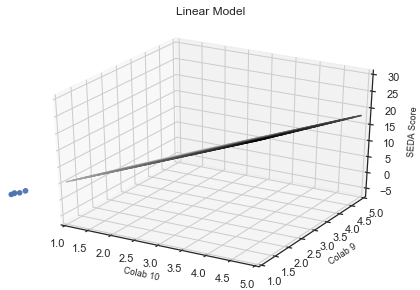




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 11
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8808752129675361, p-value: [[0.00240077 0.01799816]]
Regression Coefficients: [ 5.14532412 -2.64139752]
Intercept: 2.5295638767091186


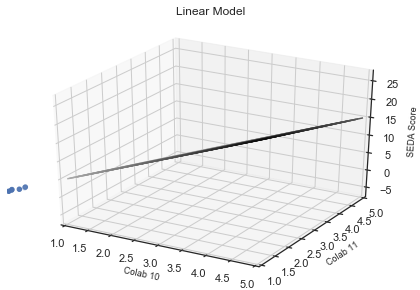




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 12
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9108817831001327, p-value: [[0.00130892 0.00955393]]
Regression Coefficients: [ 5.21410221 -2.75207212]
Intercept: 2.549388622734752


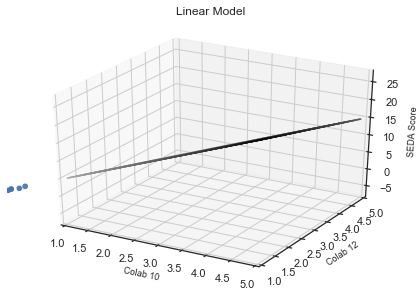




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 13
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9737147759972955, p-value: [[4.04661642e-05 2.23073132e-03]]
Regression Coefficients: [ 6.7909077  -2.22149739]
Intercept: 1.5965560196916833


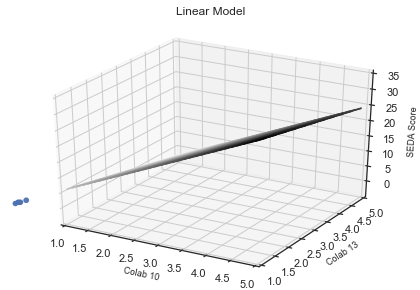




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 14
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.98047657466436, p-value: [[8.38344921e-06 2.75112148e-03]]
Regression Coefficients: [5.955538   1.23585669]
Intercept: -0.7121185890842625


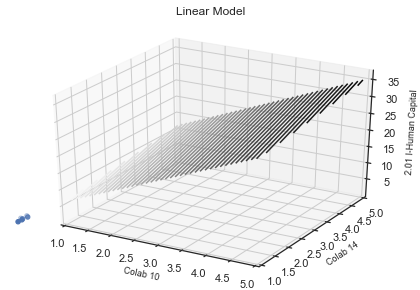




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10, Colab 14
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9208971243582922, p-value: [[0.00065244 0.00200479]]
Regression Coefficients: [2.93878655 2.00245677]
Intercept: 0.012581673154587136


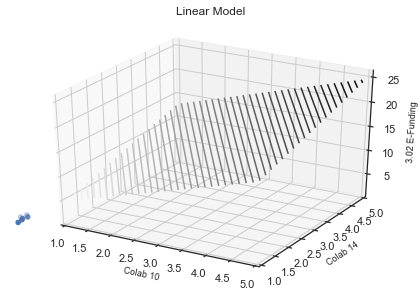




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8378994376547901, p-value: [[0.01398199 0.01214649]]
Regression Coefficients: [-2.60152501  2.75482927]
Intercept: 3.0262564826032046


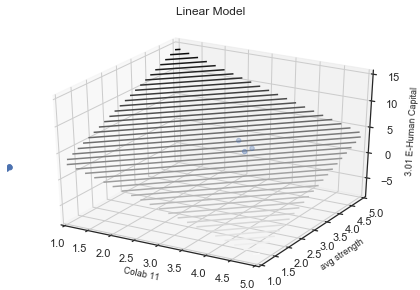




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9104472599724379, p-value: [[0.00816628 0.01038211]]
Regression Coefficients: [-0.69343279  0.65760564]
Intercept: 2.647773704512603


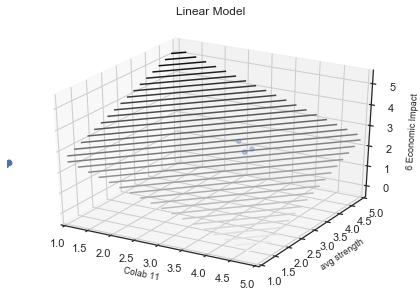




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Clustering
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8619788423032081, p-value: [[0.0006806  0.00694238]]
Regression Coefficients: [7.99058183 3.66649915]
Intercept: -1.0230147273465402


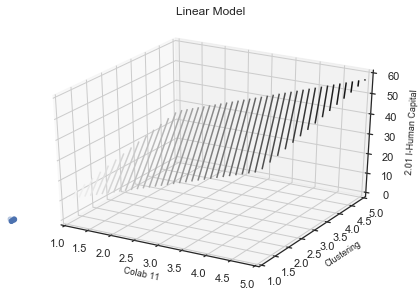




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Clustering
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9741710811831255, p-value: [[7.70979181e-05 6.66132208e-06]]
Regression Coefficients: [3.62416843 5.7386072 ]
Intercept: 0.09941849754149557


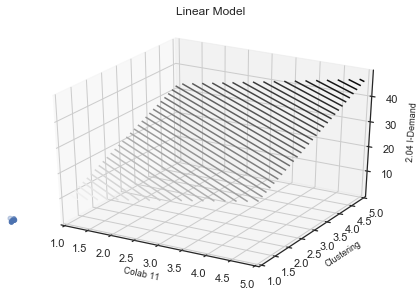




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9372755943179005, p-value: [[0.00156566 0.001219  ]]
Regression Coefficients: [-1.23728608  1.59981983]
Intercept: 3.000951715406036


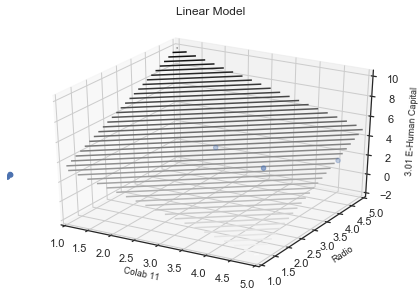




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9800588047932891, p-value: [[0.00050648 0.000894  ]]
Regression Coefficients: [-0.28725966  0.30013554]
Intercept: 2.63914522970839


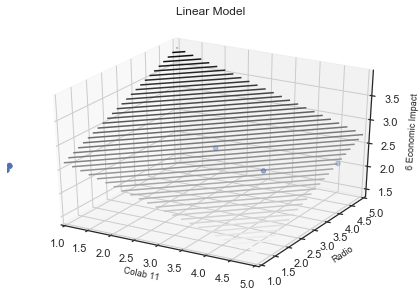




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.978982765738946, p-value: [[6.28426773e-05 2.60580960e-03]]
Regression Coefficients: [1.90876411 0.56320141]
Intercept: 1.9157741916150948


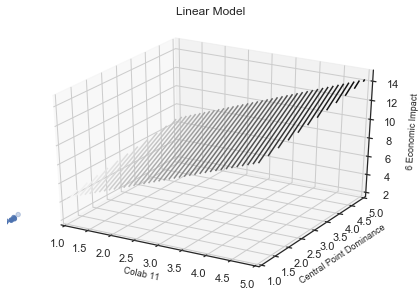




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Colab 3
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8940837083079423, p-value: [[0.00014823 0.03338389]]
Regression Coefficients: [12.03573582  2.37620727]
Intercept: -1.0906135485135833


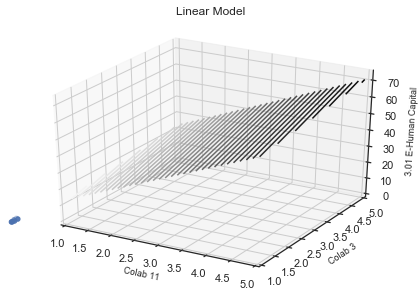




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Colab 4
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8266746718204573, p-value: [[0.00466325 0.02228641]]
Regression Coefficients: [3.33218883 1.79874156]
Intercept: 0.7659045844190318


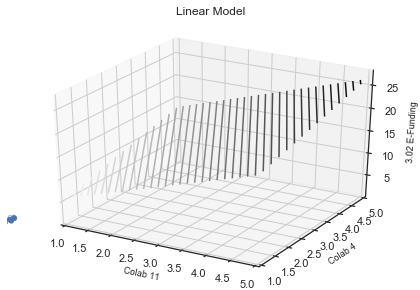




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Colab 6
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9402520103694842, p-value: [[0.00027136 0.00160997]]
Regression Coefficients: [4.91665219 2.71163676]
Intercept: 0.01763193014715414


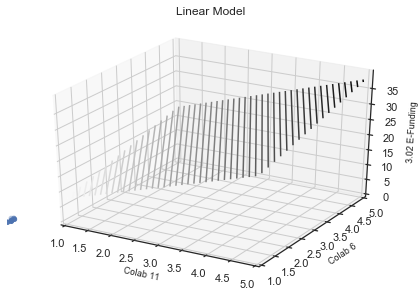




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 11, Colab 12
Predicted: 2.03 I-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9795568238183547, p-value: [[2.49141466e-06 1.14669131e-02]]
Regression Coefficients: [10.01948794  1.05314353]
Intercept: -0.30972797044906564


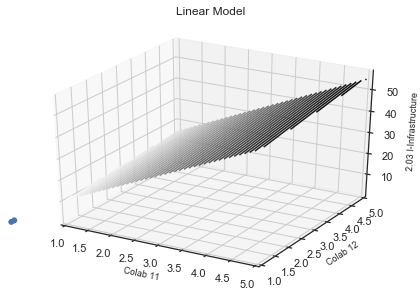




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8282700403996329, p-value: [[0.01581608 0.01379366]]
Regression Coefficients: [-2.58504655  2.73567379]
Intercept: 3.034297878175436


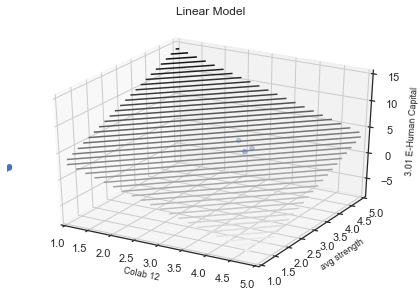




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8987527807620654, p-value: [[0.01058248 0.01346806]]
Regression Coefficients: [-0.6855417   0.64906143]
Intercept: 2.6495191966686247


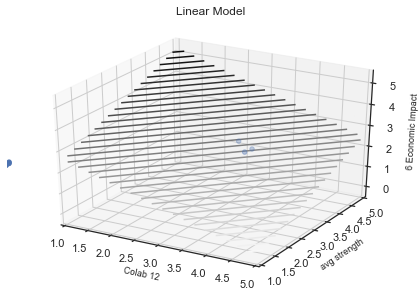




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Clustering
Predicted: 2.01 I-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8009784177221118, p-value: [[0.001562   0.04004917]]
Regression Coefficients: [7.68332559 2.57570738]
Intercept: -0.574955792711072


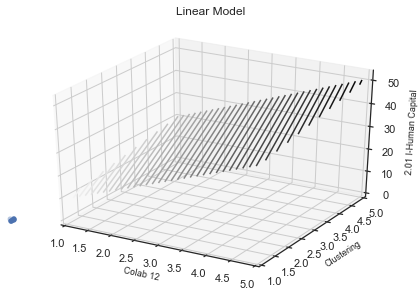




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Clustering
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8898121403204868, p-value: [[0.00091752 0.00013802]]
Regression Coefficients: [3.9504017  5.50441594]
Intercept: 0.10825781600143047


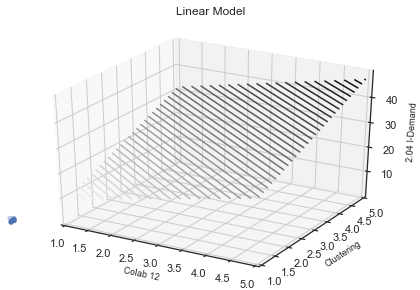




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9323643846179603, p-value: [[0.0018365  0.00143678]]
Regression Coefficients: [-1.23343169  1.5934243 ]
Intercept: 3.006792762629518


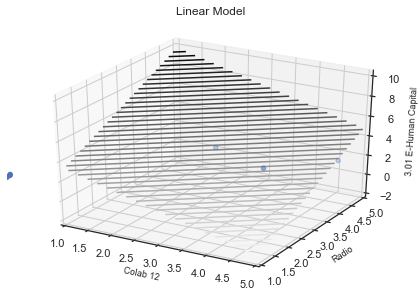




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9748458388988778, p-value: [[0.00081663 0.00144518]]
Regression Coefficients: [-0.28550128  0.29769032]
Intercept: 2.6401923408373715


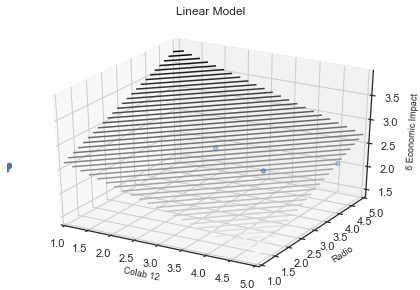




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9818255504524456, p-value: [[3.53307975e-05 2.35766437e-03]]
Regression Coefficients: [2.04489941 0.53621209]
Intercept: 1.895041144859134


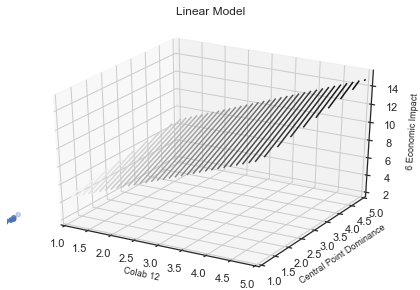




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Colab 3
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9001306841917743, p-value: [[0.0001397  0.04017362]]
Regression Coefficients: [11.82056226  2.16567485]
Intercept: -0.9303684213038839


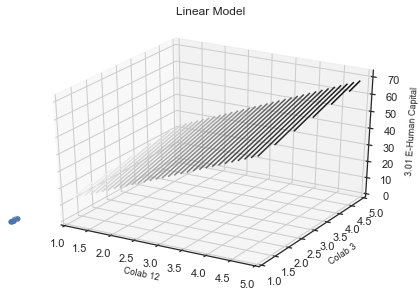




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Colab 4
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8407601445986241, p-value: [[0.00281852 0.02017795]]
Regression Coefficients: [3.64882329 1.77522106]
Intercept: 0.7055615985216992


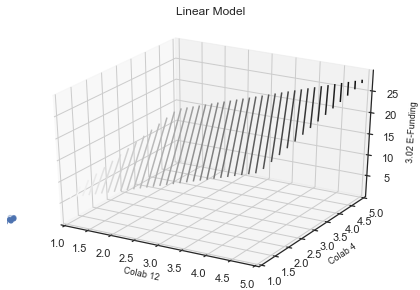




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Colab 6
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9552794179327817, p-value: [[0.00010048 0.00092844]]
Regression Coefficients: [5.45240977 2.70544695]
Intercept: -0.10373652055356652


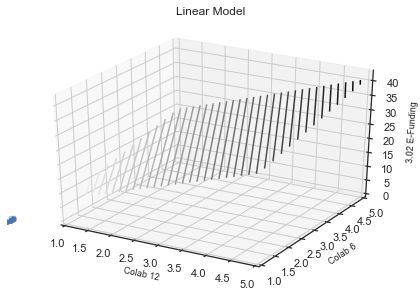




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Colab 7
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.815209361498338, p-value: [[0.00229071 0.01638164]]
Regression Coefficients: [6.74259217 3.69792834]
Intercept: -0.3176015396952723


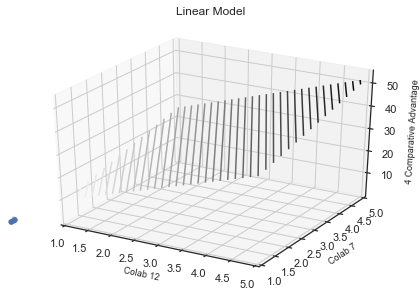




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 12, Colab 11
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8635932194226336, p-value: [[0.00039462 0.00443414]]
Regression Coefficients: [8.17183187 4.03478123]
Intercept: -0.7995889765086912


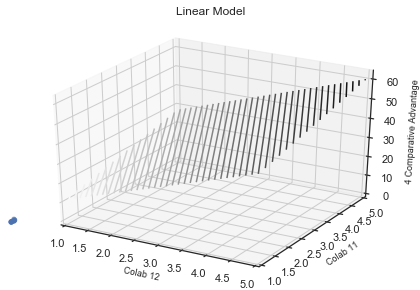




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, avg strength
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8271640737490354, p-value: [[0.01602746 0.01390895]]
Regression Coefficients: [-2.5796897  2.7336957]
Intercept: 3.0225338355962297


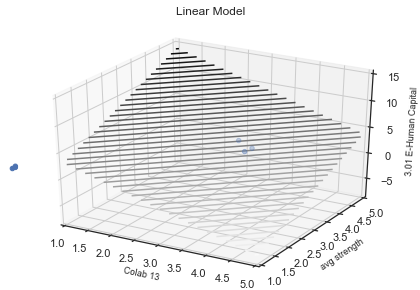




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8988165442447743, p-value: [[0.01053282 0.01346883]]
Regression Coefficients: [-0.6853694   0.64789497]
Intercept: 2.652828350135536


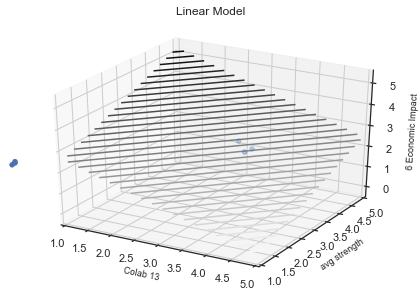




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9291647136421793, p-value: [[0.00195077 0.00149271]]
Regression Coefficients: [-1.23395148  1.60238426]
Intercept: 2.9779159674241296


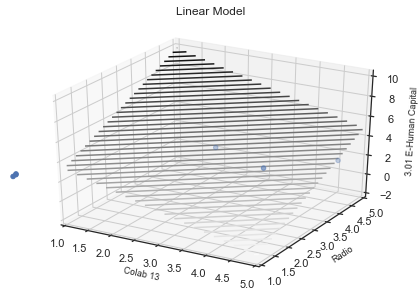




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9750073927116069, p-value: [[0.00078492 0.00138035]]
Regression Coefficients: [-0.28561968  0.29811639]
Intercept: 2.639236530605416


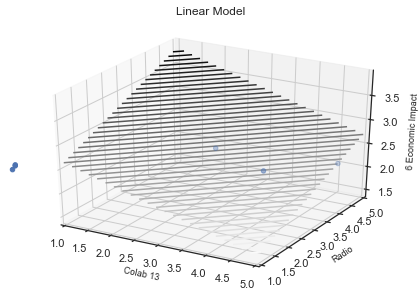




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Eficiencia Global
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8532425018959713, p-value: [[0.01791384 0.04838793]]
Regression Coefficients: [3.67389778 2.51624206]
Intercept: 0.008324776152623059


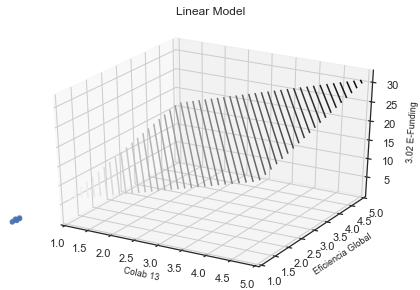




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Eficiencia Global
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8846790608100157, p-value: [[0.00132477 0.0235661 ]]
Regression Coefficients: [ 9.79899224 -4.12258828]
Intercept: 1.5419551415703747


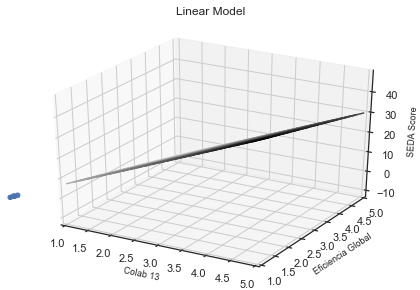




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Central Point Dominance
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8474212115065001, p-value: [[0.02848435 0.00737663]]
Regression Coefficients: [-2.94188861  3.59363584]
Intercept: 2.8622074546456204


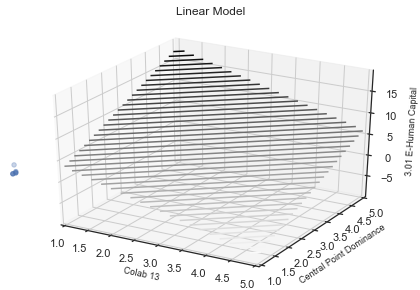




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9960031060708952, p-value: [[5.56492661e-05 3.58640347e-05]]
Regression Coefficients: [0.78546183 0.71578147]
Intercept: 2.096914817382868


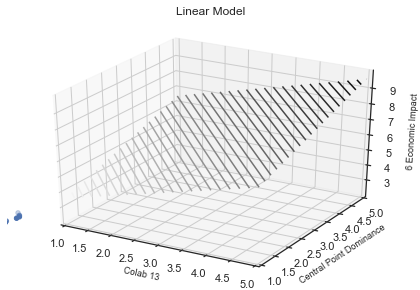




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 3
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9537580990262606, p-value: [[0.00014415 0.00084438]]
Regression Coefficients: [4.38704812 2.4899399 ]
Intercept: -0.26344230053495554


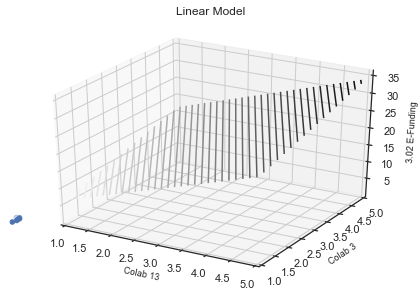




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 3
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9394106455079361, p-value: [[0.00013328 0.02105578]]
Regression Coefficients: [2.7719147  0.63206726]
Intercept: 1.4173898539773038


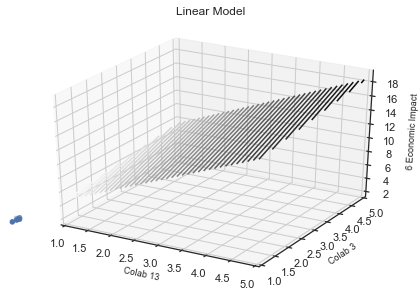




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 7
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9228403047934981, p-value: [[0.00053759 0.00967862]]
Regression Coefficients: [10.09210181 -4.44298646]
Intercept: 1.5445177951416342


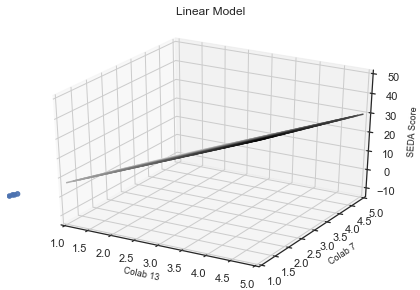




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 8
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9726083648066676, p-value: [[2.69345910e-05 1.23082286e-03]]
Regression Coefficients: [6.72645148 2.37563572]
Intercept: -1.0828961370554384


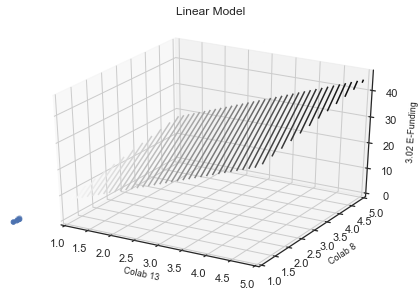




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 9
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9186760471063317, p-value: [[0.00113004 0.01443775]]
Regression Coefficients: [5.63764317 2.65029127]
Intercept: -0.7557808735704241


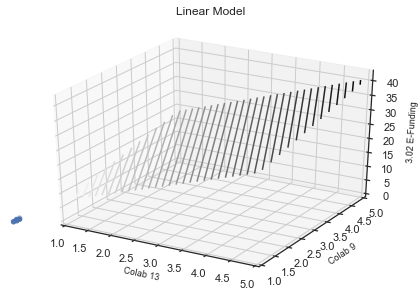




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 9
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9438540659196766, p-value: [[0.00017635 0.00850908]]
Regression Coefficients: [11.02011906 -3.74389522]
Intercept: 0.941745103720057


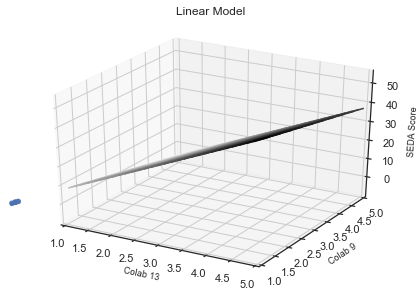




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 11
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8240682506811281, p-value: [[0.00411045 0.04635103]]
Regression Coefficients: [ 7.88343001 -3.59119512]
Intercept: 2.0221387706361065


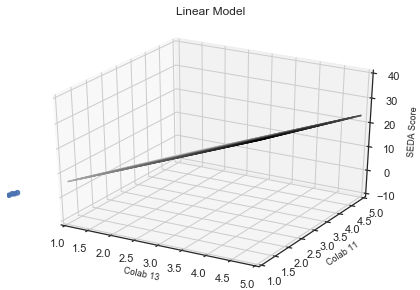




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 12
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.863529869546177, p-value: [[0.0025148  0.02475339]]
Regression Coefficients: [ 7.92230605 -3.89647796]
Intercept: 2.116427131431095


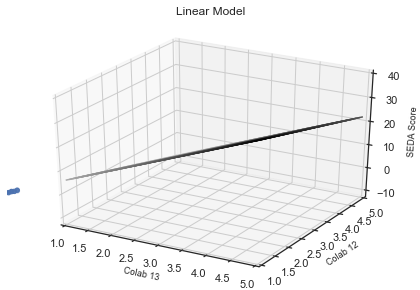




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 14
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8216522978558598, p-value: [[0.00023384 0.01314761]]
Regression Coefficients: [11.85998564  3.80734932]
Intercept: -2.6410144872168004


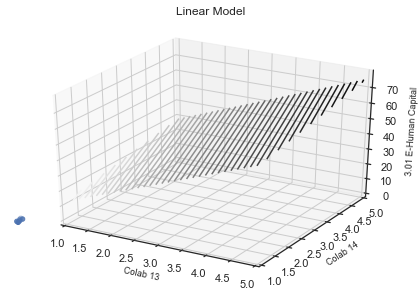




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 13, Colab 14
Predicted: 4 Comparative Advantage
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8266984715758865, p-value: [[0.00046128 0.00261021]]
Regression Coefficients: [5.08449359 3.05303841]
Intercept: -0.30259582360953097


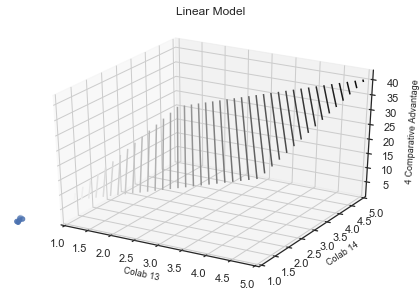




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, avg strength
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8298504888180863, p-value: [[0.03084596 0.04074896]]
Regression Coefficients: [-0.55069536  0.50990889]
Intercept: 2.6562700839343574


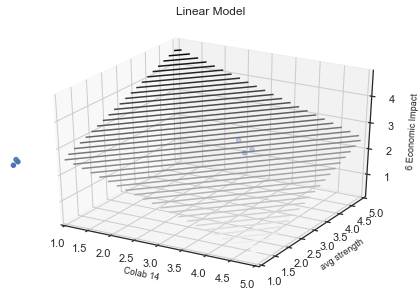




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Radio
Predicted: 3.01 E-Human Capital
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8727403542929746, p-value: [[0.00648714 0.00494169]]
Regression Coefficients: [-1.14629941  1.49496057]
Intercept: 2.9804801343780585


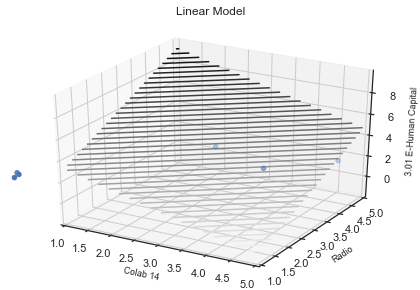




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Radio
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9741842524057612, p-value: [[0.00082482 0.00148488]]
Regression Coefficients: [-0.27545399  0.28554306]
Intercept: 2.639957109641812


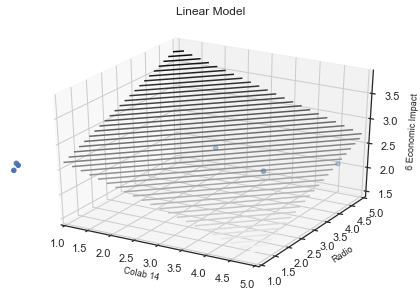




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Eficiencia Global
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8316479790900899, p-value: [[0.01809728 0.0128486 ]]
Regression Coefficients: [2.11073017 2.1946309 ]
Intercept: 0.5896035771365147


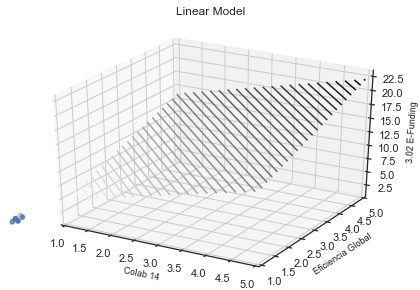




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Central Point Dominance
Predicted: 6 Economic Impact
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9879585478021058, p-value: [[0.00052702 0.00015295]]
Regression Coefficients: [0.61671593 0.69432814]
Intercept: 2.137286499476426


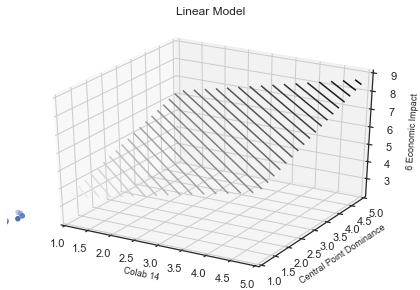




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Colab 3
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.934880028083072, p-value: [[0.00049502 0.00081876]]
Regression Coefficients: [2.8553513  2.23490005]
Intercept: 0.27903792573994757


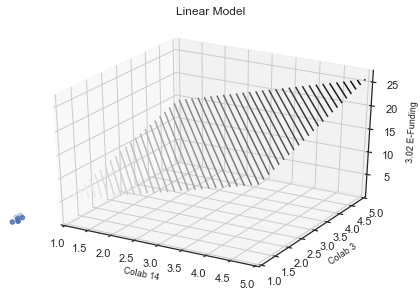




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Colab 8
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9154551832474194, p-value: [[0.0005891  0.00194693]]
Regression Coefficients: [3.4872107  2.37725724]
Intercept: -0.032257433778245304


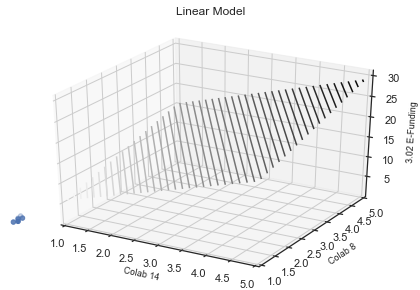




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Colab 9
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8495369219893132, p-value: [[0.00494702 0.00764037]]
Regression Coefficients: [2.85876316 2.38406305]
Intercept: 0.2237719311752111


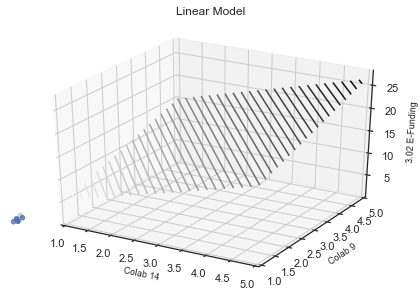




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Colab 13
Predicted: 2.04 I-Demand
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8451789562269473, p-value: [[0.00513539 0.0015882 ]]
Regression Coefficients: [2.25878    2.93178873]
Intercept: 0.9050428056569872


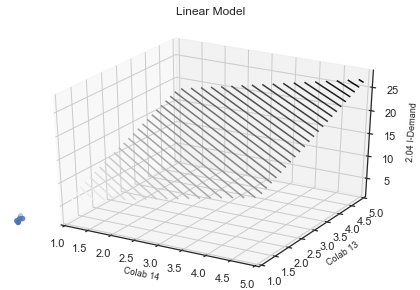




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Colab 13
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8872676684203946, p-value: [[0.00019442 0.00095403]]
Regression Coefficients: [5.6045225  3.51953897]
Intercept: -1.3498553171727612


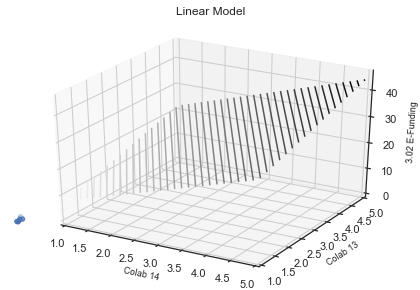




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Colab 13
Predicted: 3.03 E-Infrastructure
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9884805502456309, p-value: [[7.37703786e-07 2.61909744e-04]]
Regression Coefficients: [6.58429643 1.41959346]
Intercept: 0.8613138055185541


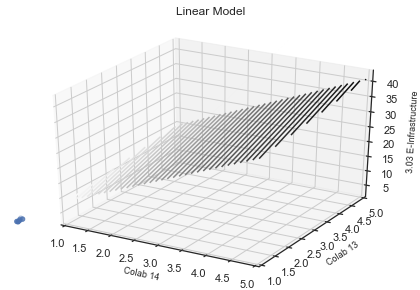




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 14, Colab 13
Predicted: GNI per capita
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9142979689765769, p-value: [[4.70706866e-05 1.31222171e-02]]
Regression Coefficients: [10.80569054  2.31138269]
Intercept: -3.202048612856518


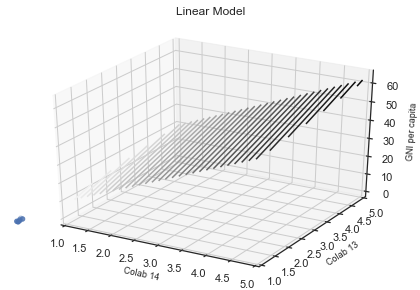




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10 rescaled, weight
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8222582106118866, p-value: [[0.012848   0.01832251]]
Regression Coefficients: [ 0.37030771 -0.29917243]
Intercept: 3.2442717722027954


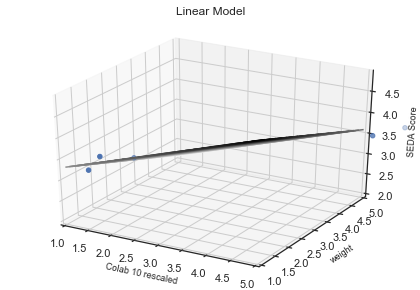




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10 rescaled, Small Worldness
Predicted: SEDA Score
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.8027373625959638, p-value: [[0.01724414 0.02413261]]
Regression Coefficients: [ 0.41228169 -0.33850307]
Intercept: 3.2468748048299325


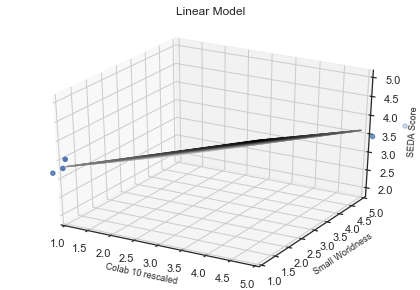




- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Predictor metrics: Colab 10 rescaled, Colab 0
Predicted: 3.02 E-Funding
- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Regression Score: 0.9075233057499646, p-value: [[0.00023351 0.00478609]]
Regression Coefficients: [0.25196101 0.09520545]
Intercept: 0.3034217004622657


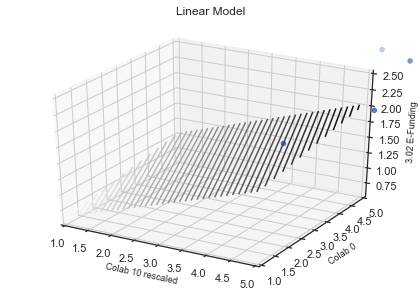

In [109]:
'''
3D linear models for predicting iEcosystem metrics using graph metrics
'''
# list of all global metrics
grf_key_list=list(grf_df.keys())                     

#iEco metrics predictors/to be predicted
ieco_key_list=list(df_means.keys())                           

for key1 in grf_key_list:
    for key2 in grf_key_list:                                 # for each pair (a,b) of distinct global metrics
        if key1 != key2:                                      
            for predict in ieco_key_list:               # and each predictor
                
                # we make a numpy array with the predicted values and reshape it into 2 rows, 6 columns
                X = np.concatenate([ieco_grf_df[key1].to_numpy(),ieco_grf_df[key2].to_numpy()],axis=0)
                X = X.reshape(6,2)
                
                # make a numpy array for our predictor
                y=ieco_grf_df[predict].to_numpy()
                
                #make linear regression with X,y data and obtain p-value
                reg=LinearRegression().fit(X,y)
                p=lin_reg_p_val(reg,X,y)
                
                #if p-value is small enough and the regression score is greater than 0.8:
                if p[0][0]<.05 and p[0][1]<.05 and reg.score(X,y)>.8:
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Predictor metrics: '+key1+', '+key2)
                    print('Predicted: '+predict)
                    print('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -')
                    print('Regression Score: ' + str(reg.score(X,y)) + ', p-value: ' + str(p) )
                    print('Regression Coefficients: ' + str(reg.coef_) )
                    print('Intercept: ' + str(reg.intercept_))
                    plot_linear_model(reg,X,y,key1,key2,predict)
                    print('')
                    print('')
                    print('')
                